<a href="https://colab.research.google.com/github/sgathai/Various-note-books-_Practising/blob/master/More_than_one_description.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [5]:
# File path
file_path ="/content/More than one description but shared code.xlsx"
# Read the Excel file
df = pd.read_excel(file_path)

# Show the first few rows of the DataFrame
df.head()

,Transaction_ Type,Transaction _Date,Stock_Code,Stock _Description,WH,Issued_Qty,Issued_Value,Supplier _Code,Supplier_Name,Purchased_Qty,Purchase_Unit_Price,Purchased_ Value
0,Issue,2023-08-19,ACEBLCO01,Complete end block assembly pt no: 6732 Tufnol,HVS,2.0,9600.0,NaN,NaN,NaN,NaN,NaN
1,Issue,2023-05-20,ACEBLCO01,Complete end block assembly pt no: 6732,HVS,2.0,9600.0,NaN,NaN,NaN,NaN,NaN
2,Purchase,2023-04-05,ACEBLCO01,Complete end block assembly pt no: 6732,HVS,NaN,NaN,KEP01,KEP SERVICES LTD,2.0,4800.0,9600.0
3,Purchase,2023-08-10,ACEBLCO01,Complete end block assembly pt no: 6732 Tufnol,HVS,NaN,NaN,KEP01,KEP SERVICES LTD,2.0,4800.0,9600.0
4,Issue,2023-10-09,ACEELCU01,CUT WIRE 0.71mmx12m,HVS,1.0,3300.0,NaN,NaN,NaN,NaN,NaN


In [3]:
df.tail()

,Transaction_ Type,Transaction _Date,Stock_Code,Stock _Description,WH,Issued_Qty,Issued_Value,Supplier _Code,Supplier_Name,Purchased_Qty,Purchase_Unit_Price,Purchased_ Value
28785,Purchase,2022-12-24,WIND07,Malpha hinges - hydraulic,US,NaN,NaN,PRE05,PREMIUM TOOLS & EQUIPMENT(K) LTD,15.0,114.65517,1719.83
28786,Purchase,2021-07-22,WIND07,MALPHA HINGES,US,NaN,NaN,TOO02,TOOL MASTERS INDUSTRIAL SUPPLIERS LIMITED,20.0,137.93103,2758.62
28787,Purchase,2023-04-06,WIND07,Malpha hinges - hydraulic (pair),US,NaN,NaN,CLE05,CLEAVE AGENCIES,20.0,103.44827,2068.97
28788,Purchase,2022-01-05,WIND07,MALPHA HINGES,US,NaN,NaN,CLE05,CLEAVE AGENCIES,30.0,68.96551,2068.97
28789,Purchase,2023-05-30,WIND07,Malpha hinges - hydraulic (pair),US,NaN,NaN,WID01,WIDE TECH ENGINEERING LIMITED,40.0,112.93103,4517.24


In [4]:
df.isnull().sum()

Transaction_ Type          0
Transaction _Date          0
Stock_Code                 0
Stock _Description         0
WH                         0
Issued_Qty              4090
Issued_Value            4090
Supplier _Code         24700
Supplier_Name          24700
Purchased_Qty          24700
Purchase_Unit_Price    24712
Purchased_ Value       24700
dtype: int64

In [5]:
df.describe()

,Issued_Qty,Issued_Value,Purchased_Qty,Purchase_Unit_Price,Purchased_ Value
count,24700.000000,2.470000e+04,4090.000000,4078.000000,4.090000e+03
mean,3.271602,8.091457e+03,20.575122,15819.697540,5.473143e+04
std,15.817278,3.338344e+04,106.369821,35668.955591,1.162480e+05
min,-183.000000,-1.226260e+06,-400.000000,0.560340,-1.381544e+06
25%,1.000000,2.807000e+02,2.000000,879.482755,4.880387e+03
50%,1.000000,1.443250e+03,5.000000,3922.290000,2.068966e+04
75%,2.000000,5.940090e+03,11.000000,13467.446220,6.249389e+04
max,1985.000000,1.300322e+06,5000.000000,566558.330000,1.381544e+06


In [6]:
df.columns

Index(['Transaction_ Type', 'Transaction _Date', 'Stock_Code',
       'Stock _Description', 'WH', 'Issued_Qty', 'Issued_Value',
       'Supplier _Code ', 'Supplier_Name', 'Purchased_Qty ',
       'Purchase_Unit_Price', 'Purchased_ Value'],
      dtype='object')

In [7]:
!pip install openpyxl

In [8]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import os
from openpyxl import Workbook
from openpyxl.drawing.image import Image

# Load the data
file_path = "/content/More than one description but shared code.xlsx"
df = pd.read_excel(file_path)

# Drop rows where 'Purchase_Unit_Price' is NaN
df = df.dropna(subset=['Purchase_Unit_Price'])

# Filter out Stock_Codes with only one unique 'Purchase_Unit_Price'
Stock_Description_to_plot = df.groupby('Stock _Description').filter(lambda x: x['Purchase_Unit_Price'].nunique() > 1)['Stock _Description'].unique()

# Create a directory to store the images
os.makedirs('plots', exist_ok=True)

# Generate a limited color palette for suppliers
unique_suppliers = df['Supplier_Name'].dropna().unique()
colors = sns.color_palette("hsv", 5)
color_map = {supplier: colors[i % 5] for i, supplier in enumerate(unique_suppliers)}

# Function to sanitize the file name
def sanitize_filename(filename):
    invalid_chars = ['<', '>', ':', '"', '/', '\\', '|', '?', '*']
    for char in invalid_chars:
        filename = filename.replace(char, '')
    return filename

# Function to save the plot for each stock code
def save_plot_for_Stock_Description(Stock_Description, data):
    data_filtered = data[data['Stock _Description'] == Stock_Description].sort_values(by='Transaction _Date')
    plt.figure(figsize=(12, 6))
    plot = sns.lineplot(x='Transaction _Date', y='Purchase_Unit_Price', data=data_filtered, marker='o')
    for line in range(0, data_filtered.shape[0]):
        supplier_name = str(data_filtered['Supplier_Name'].iloc[line]).capitalize()
        plot.text(data_filtered['Transaction _Date'].iloc[line],
                  data_filtered['Purchase_Unit_Price'].iloc[line] + (data_filtered['Purchase_Unit_Price'].max() * 0.01),
                  supplier_name,
                  horizontalalignment='left',
                  size=9,
                  color=color_map.get(data_filtered['Supplier_Name'].iloc[line], 'black'),
                  weight='bold'
                  )
    plt.title(f'Trend Line of Purchase Unit Price for Stock Description: {Stock_Description}')
    plt.xlabel('Transaction Date')
    plt.ylabel('Purchase Unit Price')
    plt.xticks(rotation=45)
    # plt.tight_layout()  # Optional: Uncomment if you need tight layout
    sanitized_name = sanitize_filename(Stock_Description)
    plt.savefig(f'plots/{sanitized_name}.png')
    plt.close()

# Save plots for all filtered Stock Descriptions
for Stock_Description in Stock_Description_to_plot:
    save_plot_for_Stock_Description(Stock_Description, df)

# Create a new Excel workbook
wb = Workbook()
ws = wb.active

# Insert each image into a separate sheet in the Excel file
for Stock_Description in Stock_Description_to_plot:
    sanitized_name = sanitize_filename(Stock_Description)
    img_path = f'plots/{sanitized_name}.png'
    if os.path.exists(img_path):
        ws = wb.create_sheet(title=sanitized_name)
        img = Image(img_path)
        ws.add_image(img, 'A1')  # Adjust the cell as needed

# Save the workbook
excel_path = '/content/visualizations.xlsx'
wb.save(excel_path)


/usr/local/lib/python3.10/dist-packages/openpyxl/workbook/child.py:99: UserWarning: Title is more than 31 characters. Some applications may not be able to read the file
  warnings.warn("Title is more than 31 characters. Some applications may not be able to read the file")


In [ ]:
!pip install python-pptx

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 471.6/471.6 kB 8.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.8/154.8 kB 17.5 MB/s eta 0:00:00


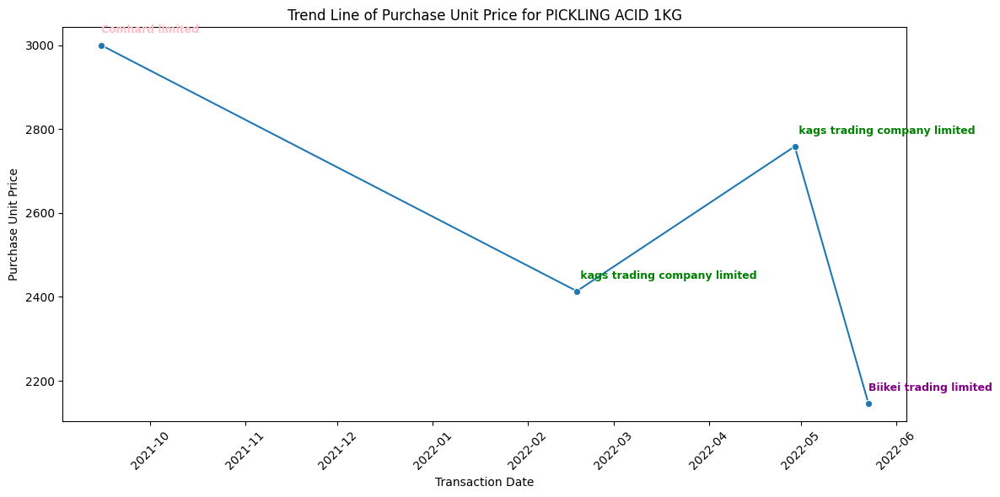

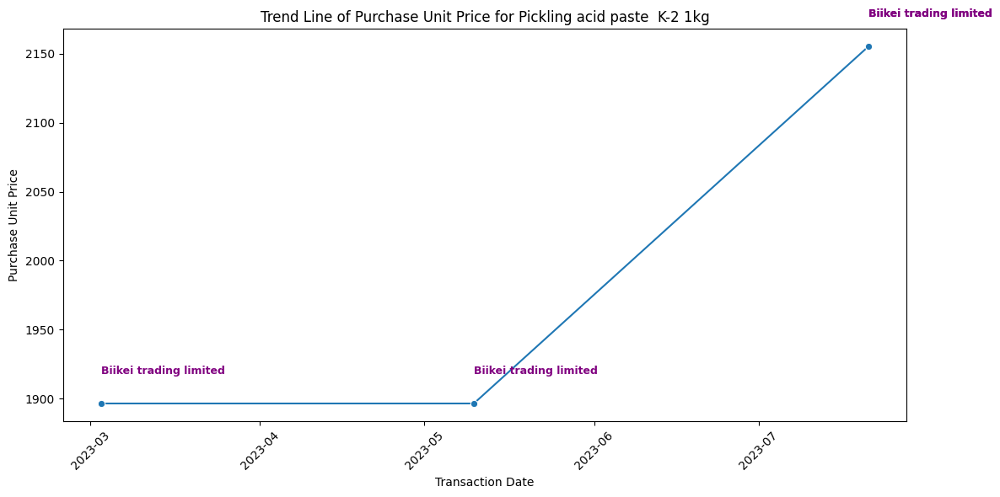

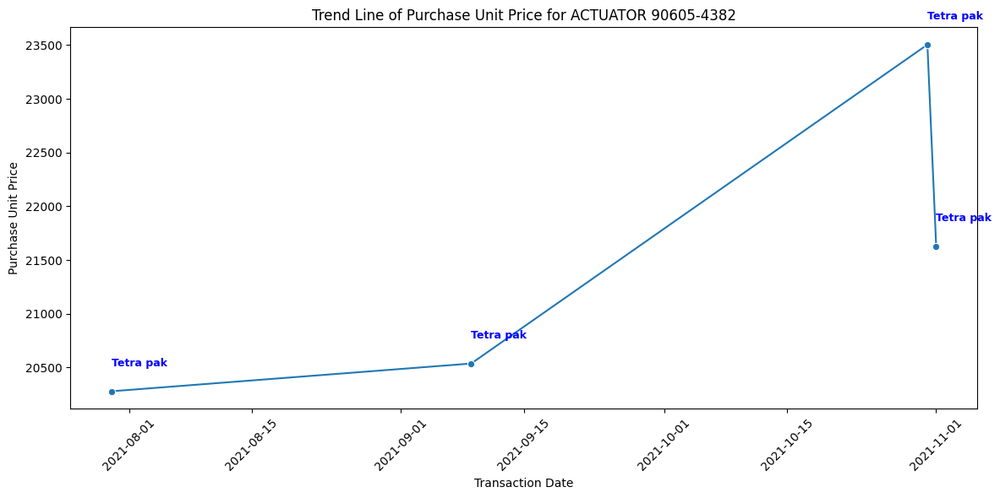

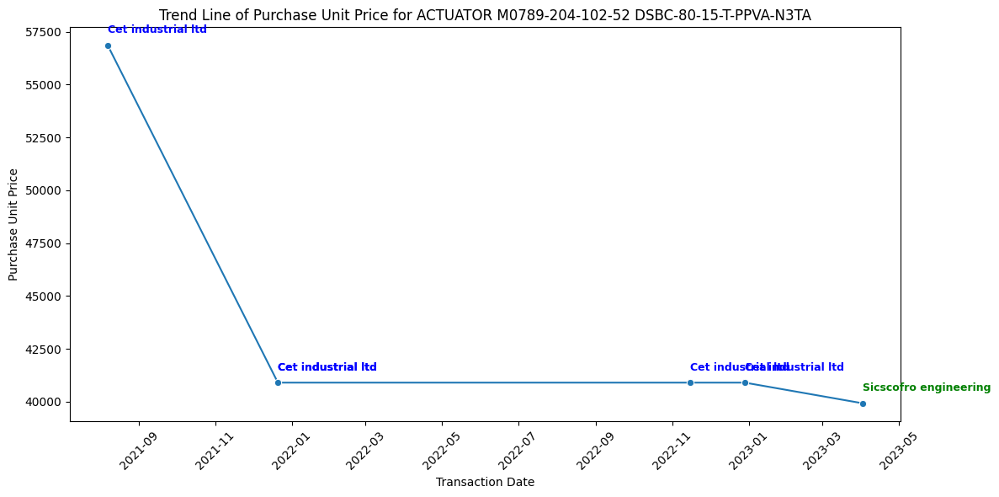

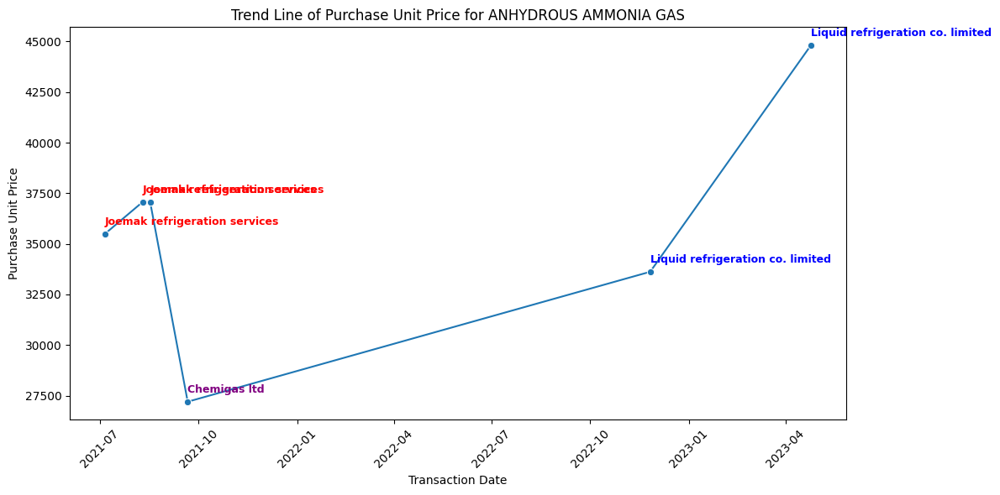

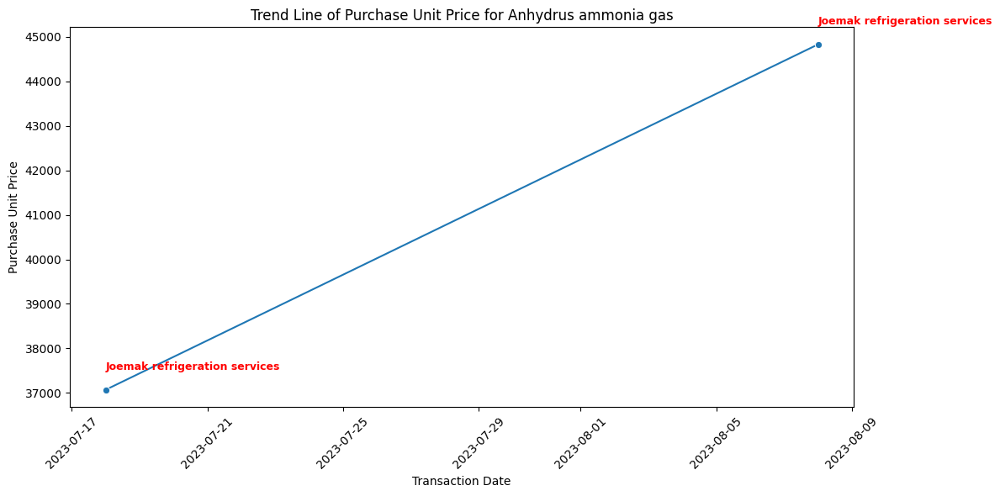

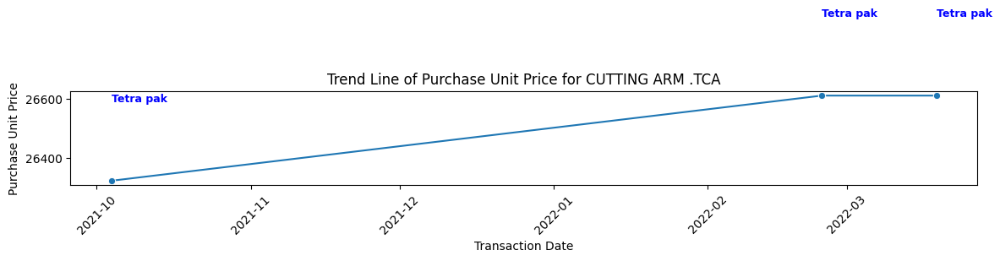

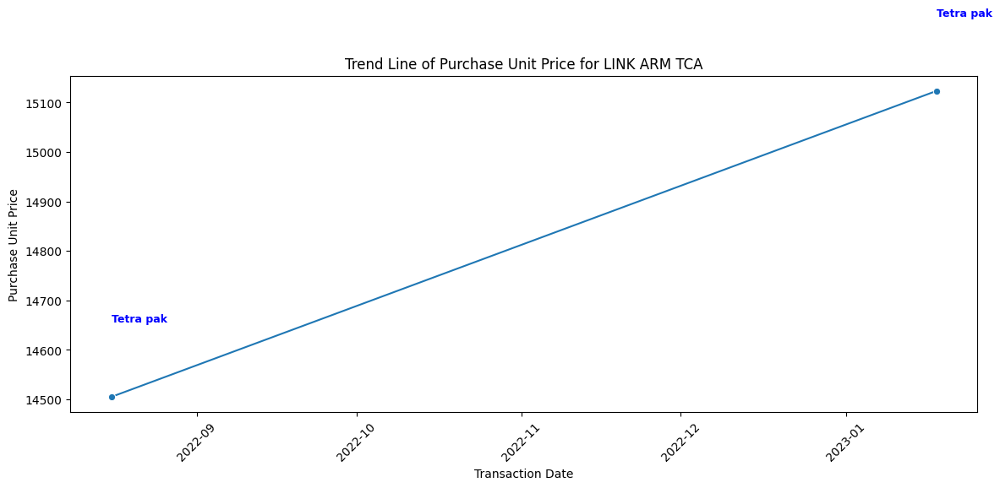

<ipython-input-17-de13d2447d94>:50: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


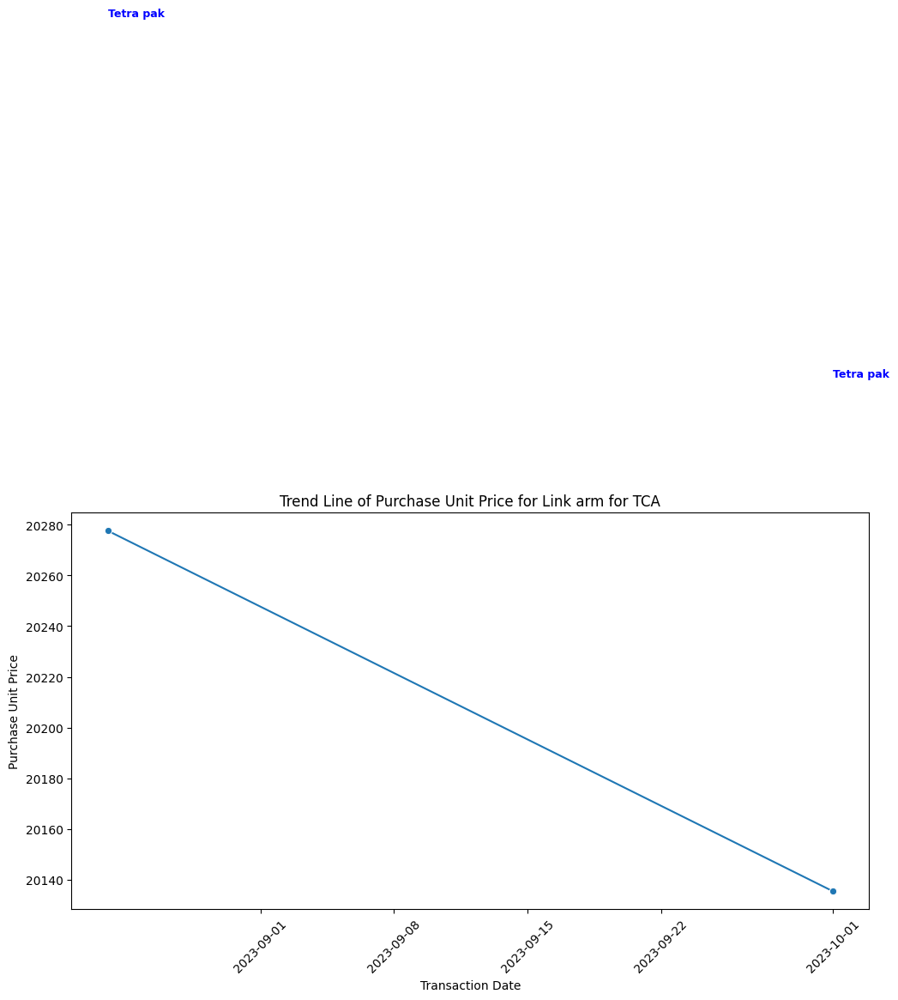

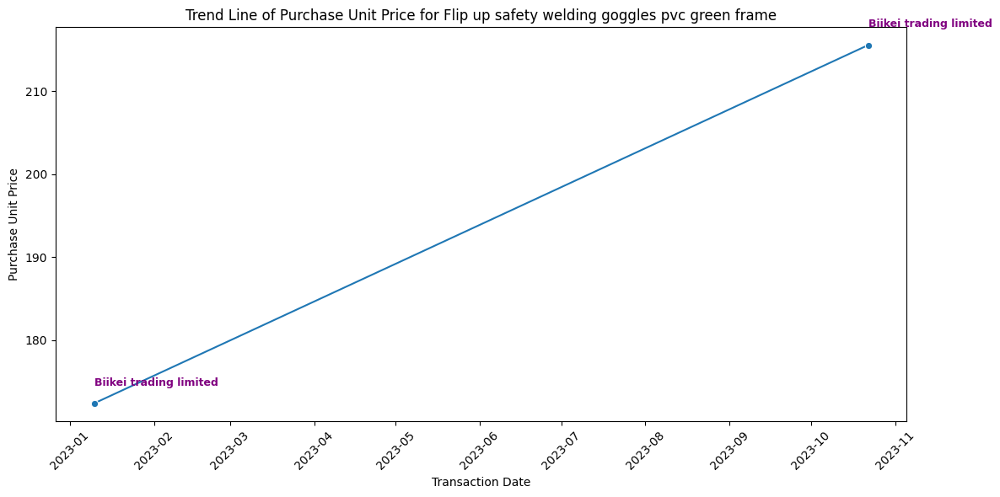

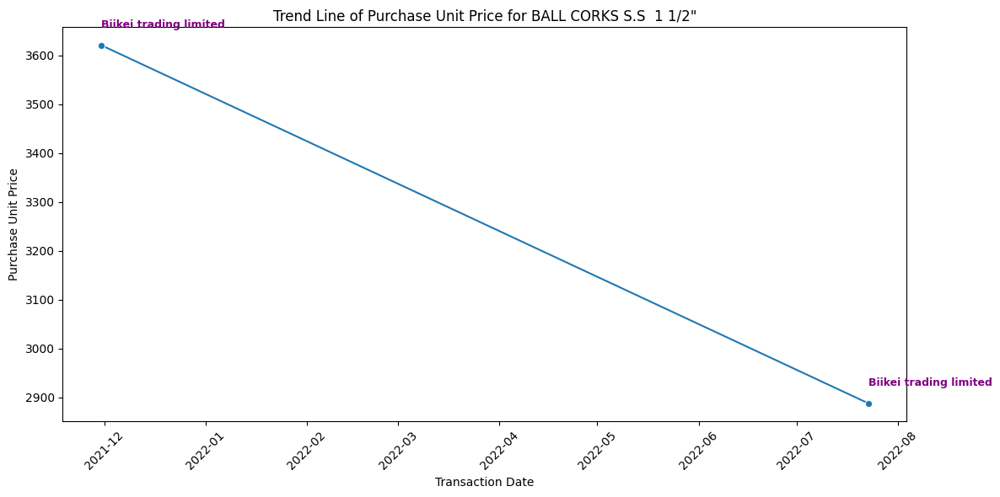

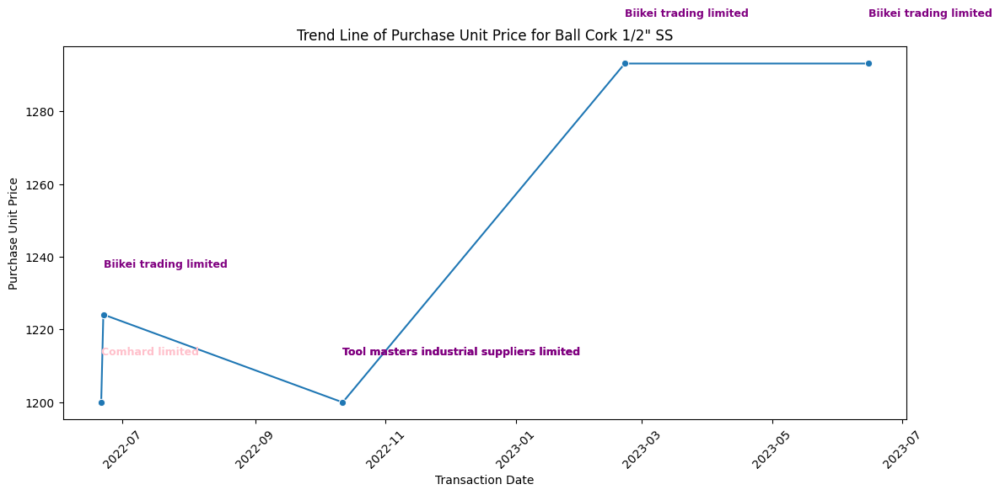

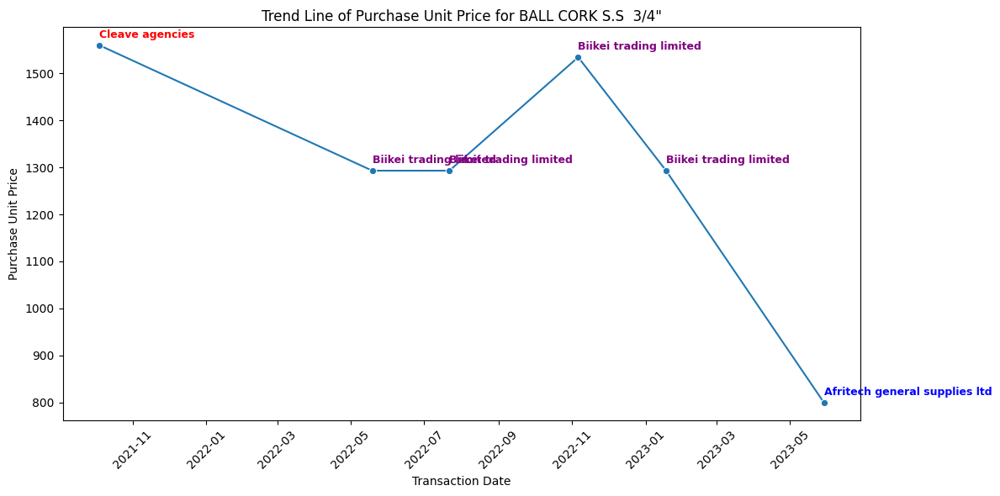

...

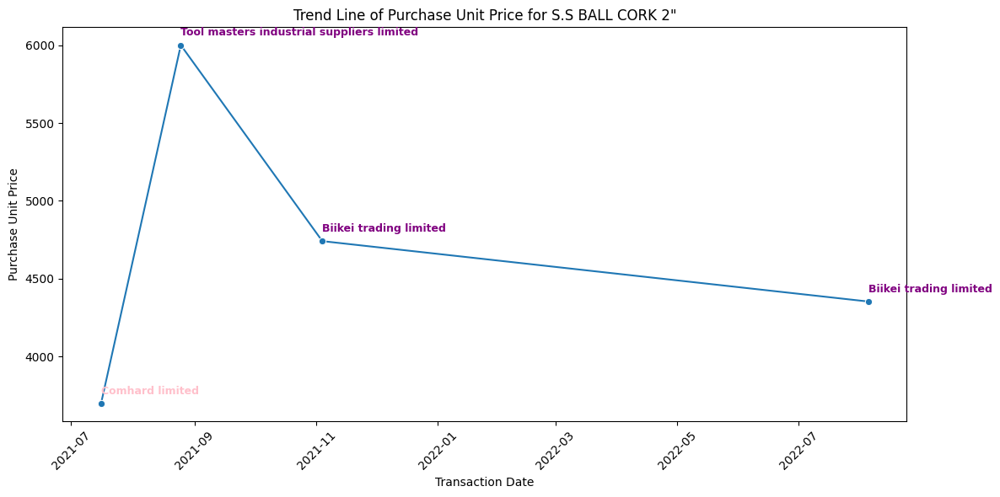

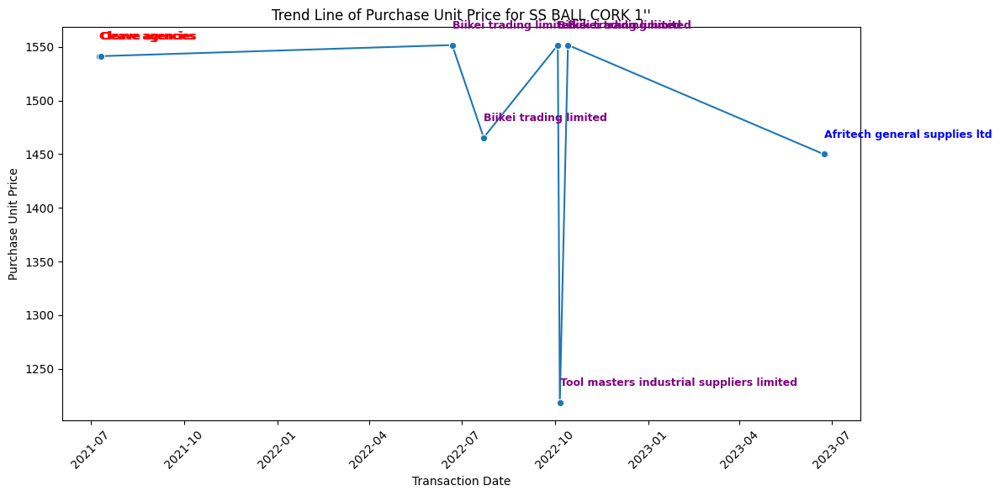

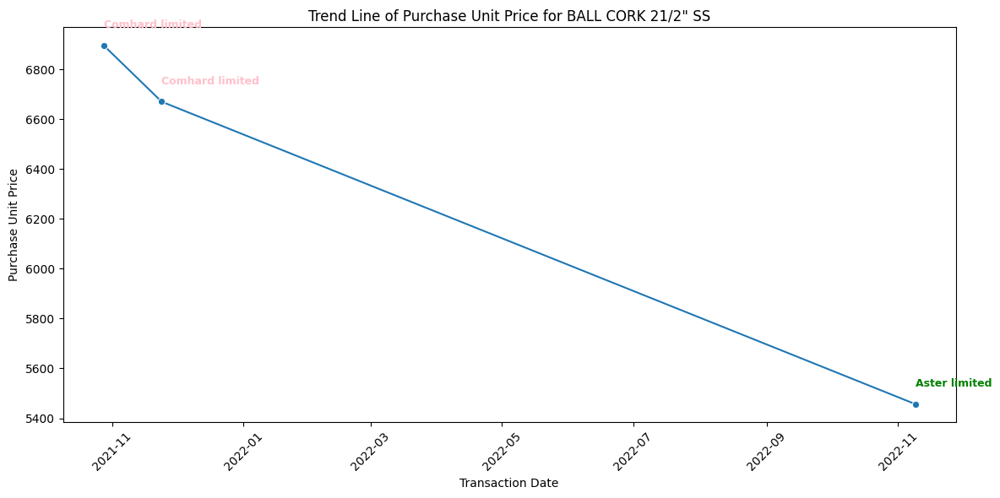

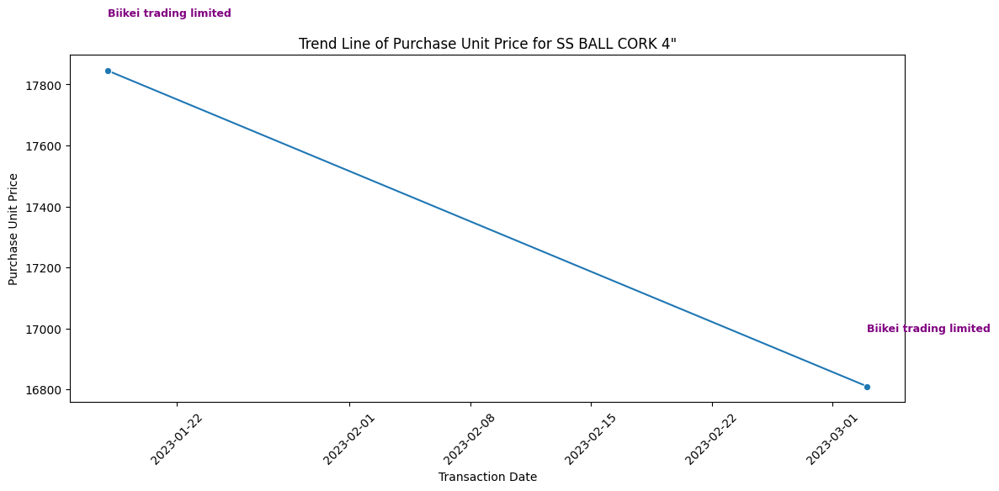

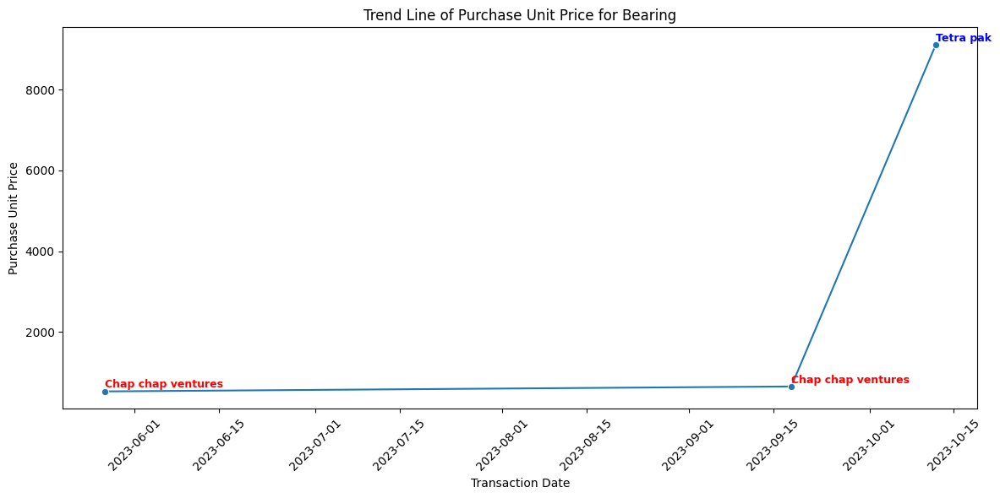

<ipython-input-17-de13d2447d94>:50: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


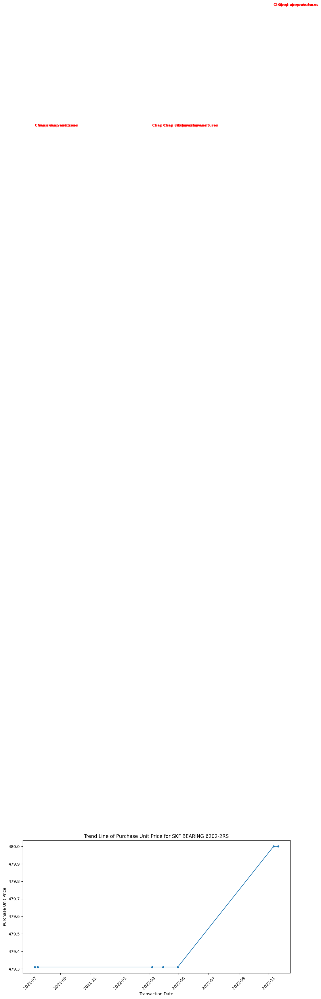

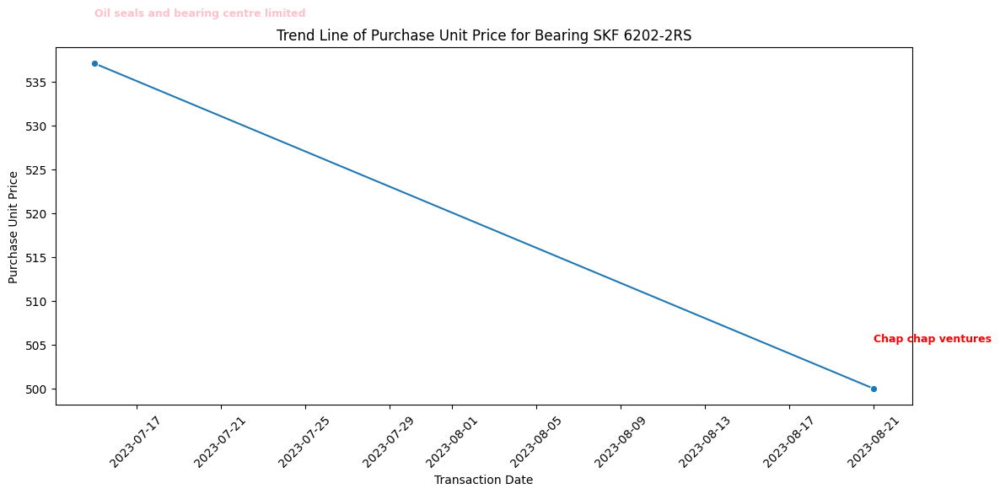

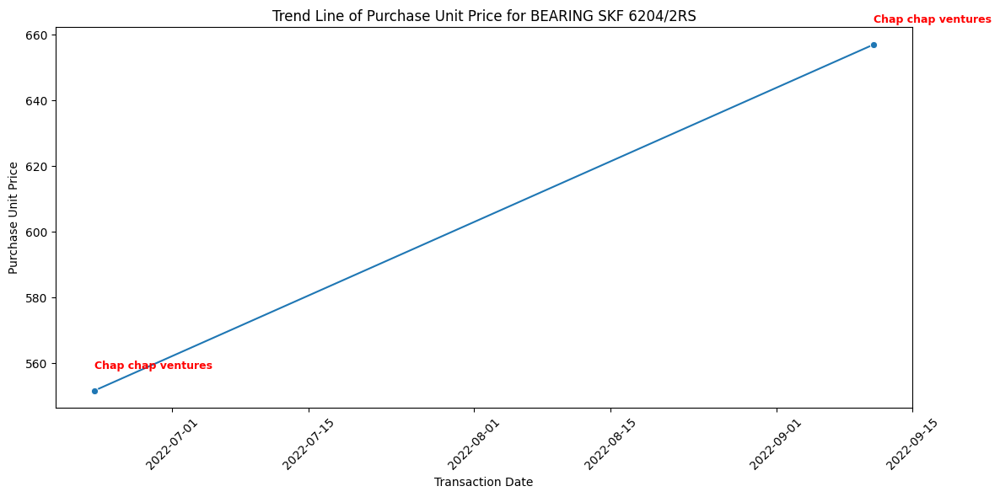

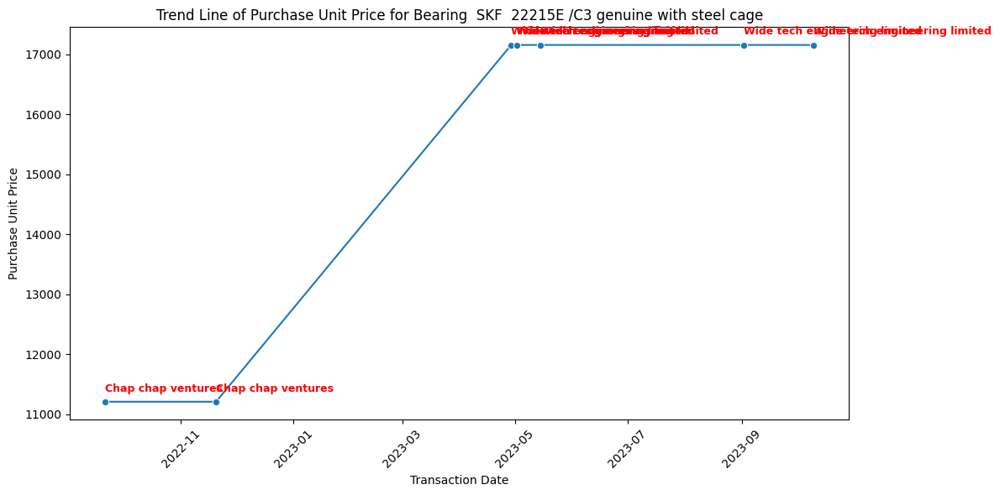

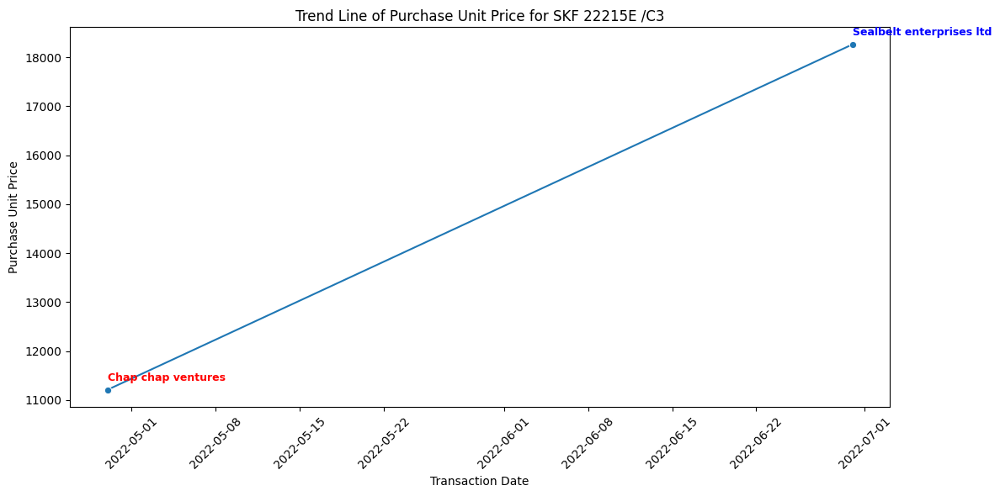

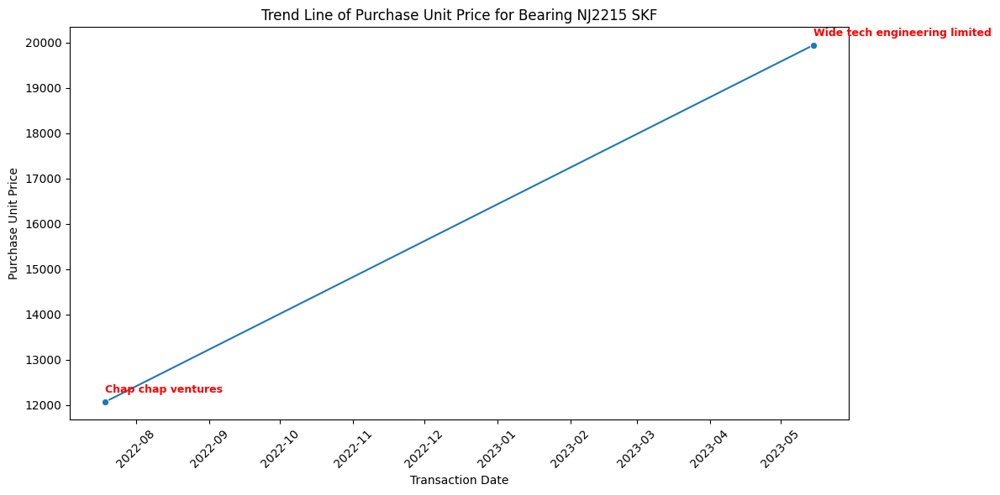

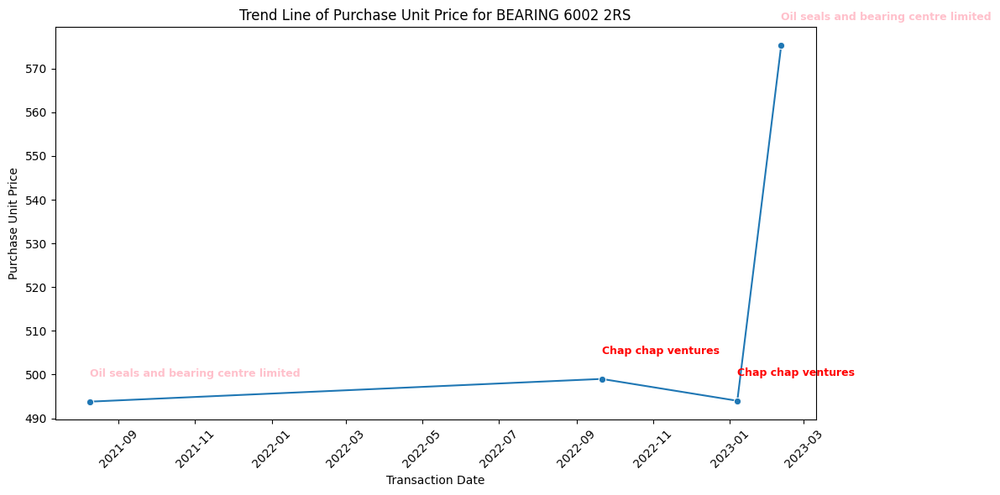

<ipython-input-17-de13d2447d94>:50: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


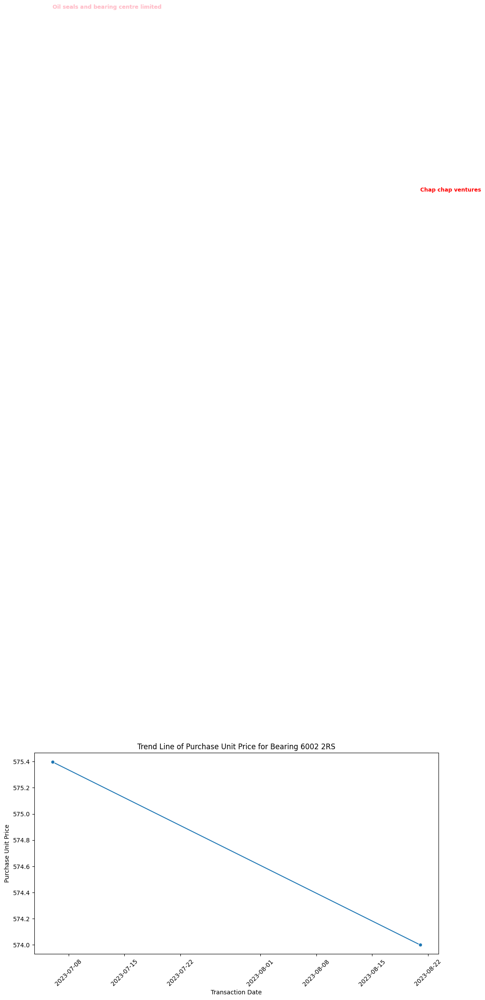

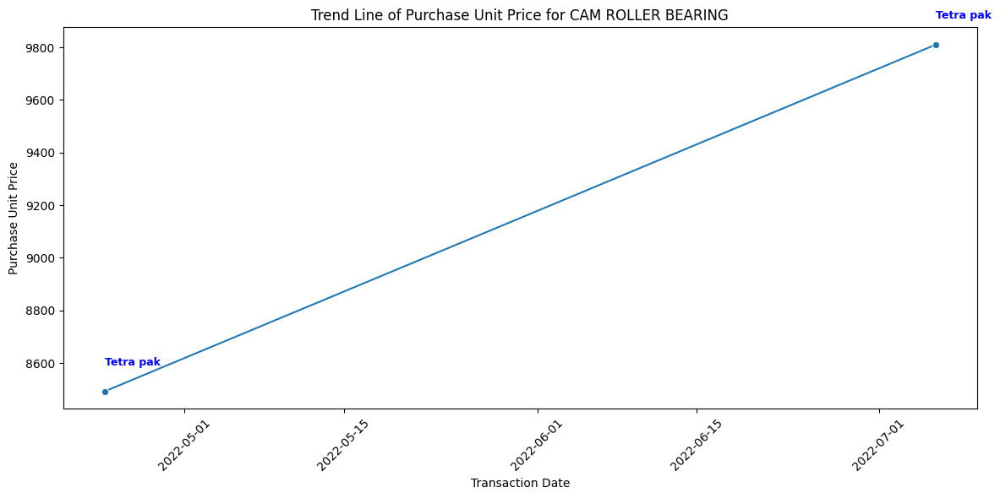

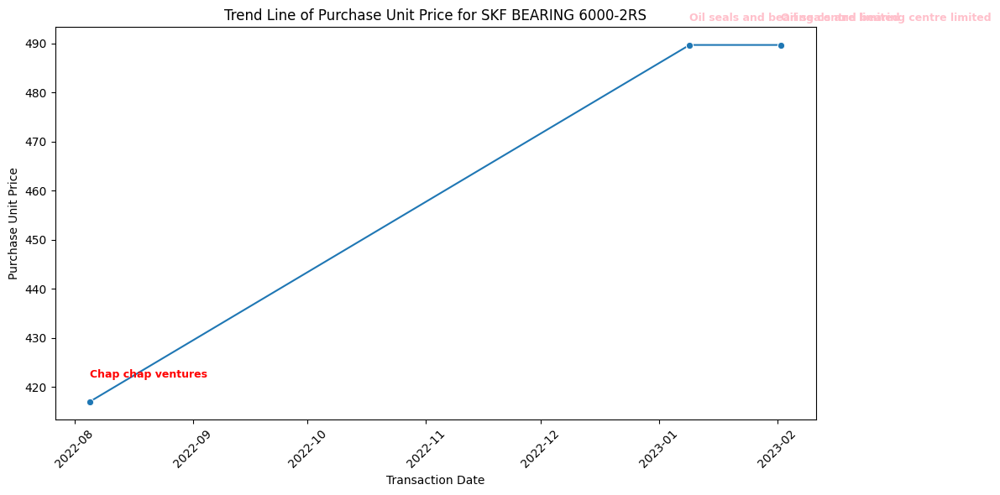

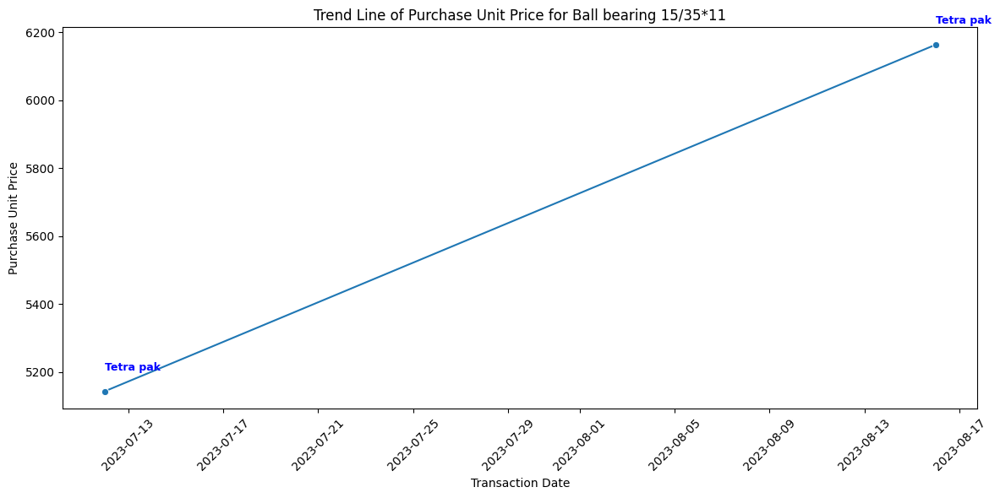

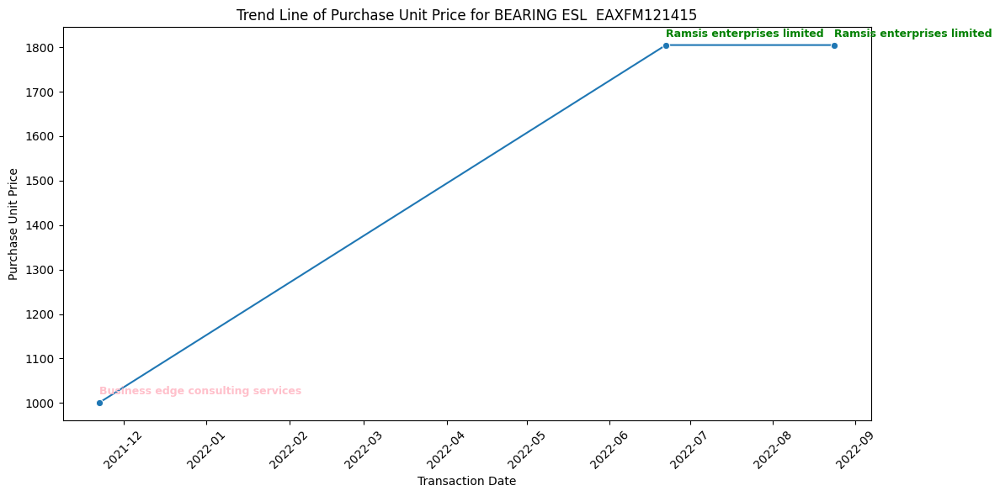

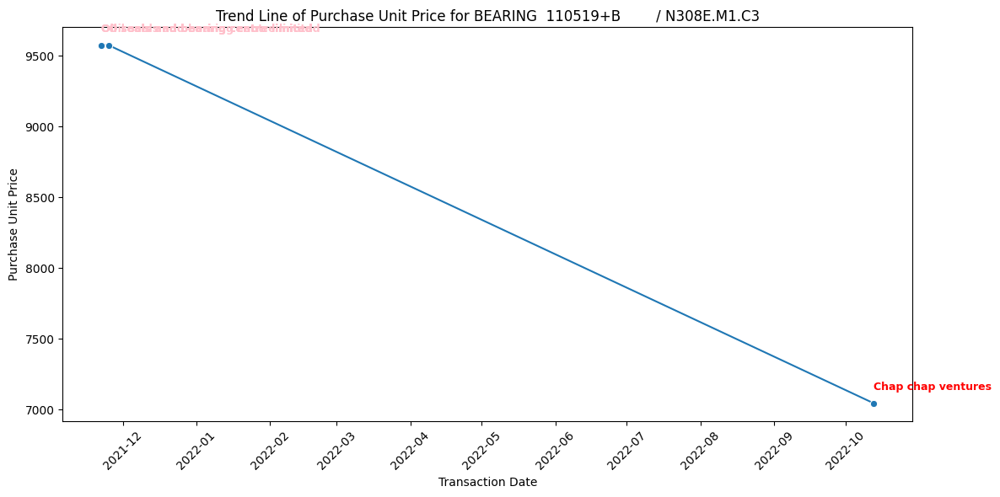

<ipython-input-17-de13d2447d94>:50: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


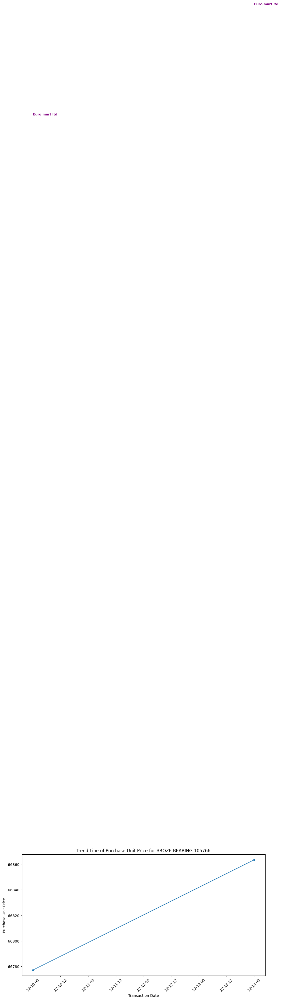

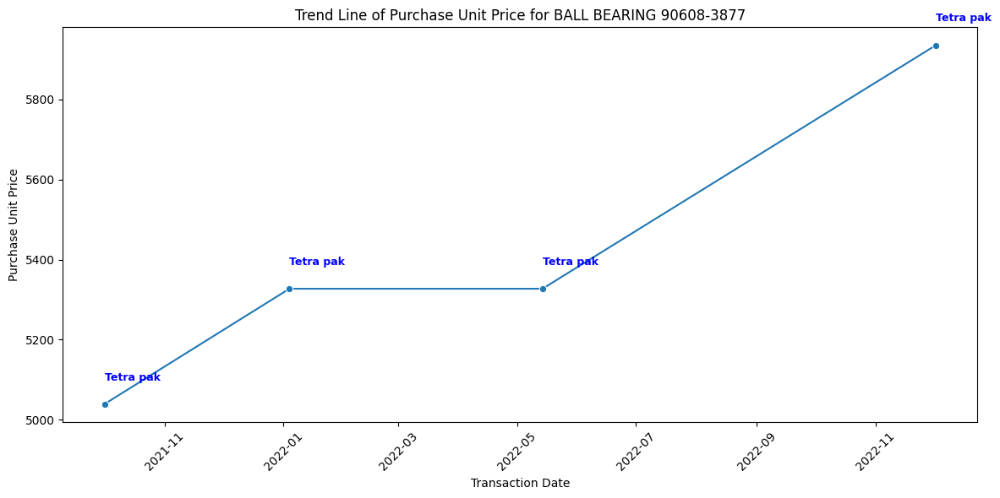

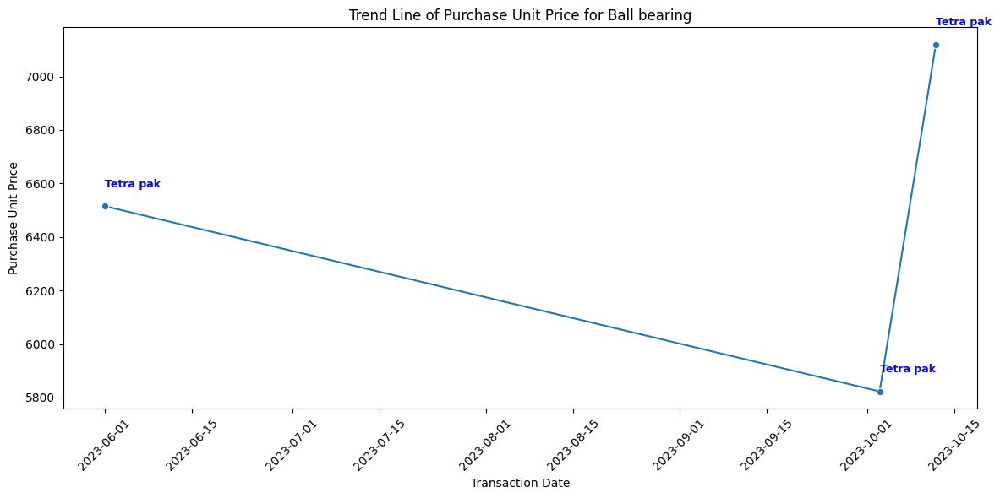

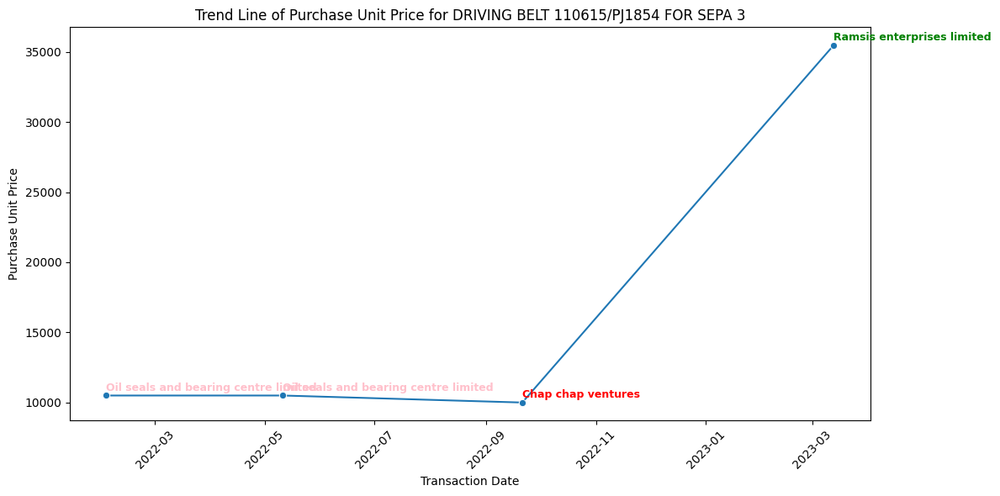

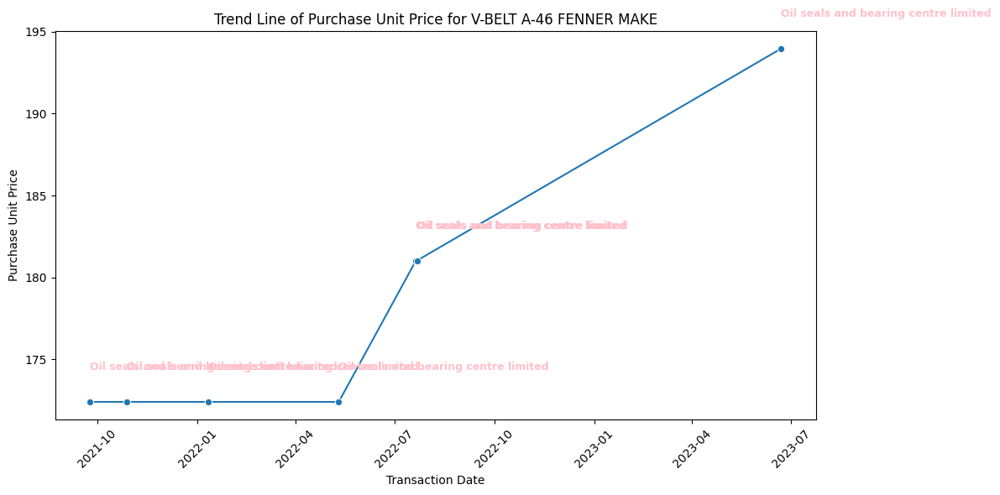

...

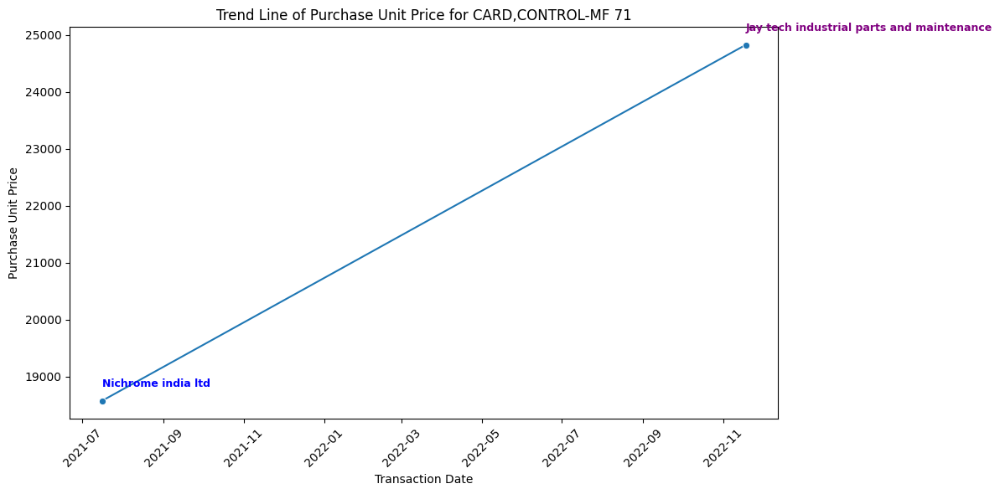

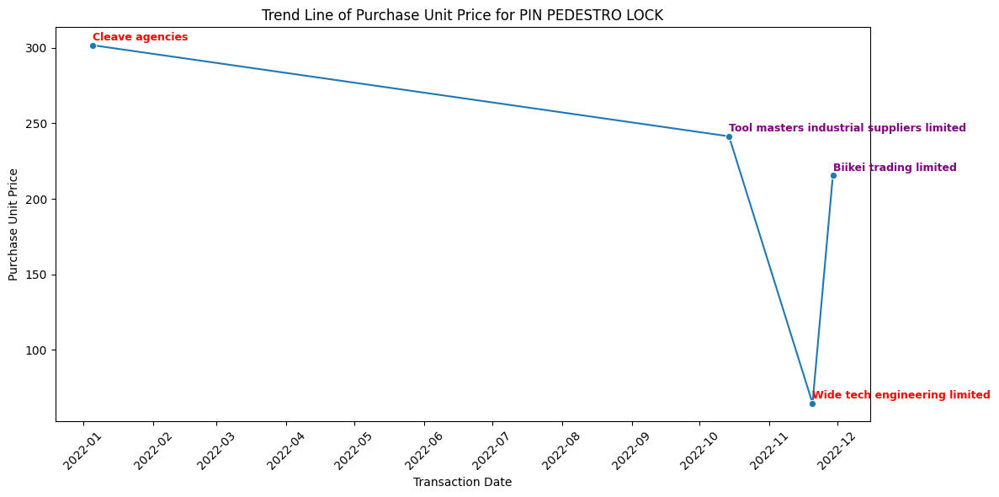

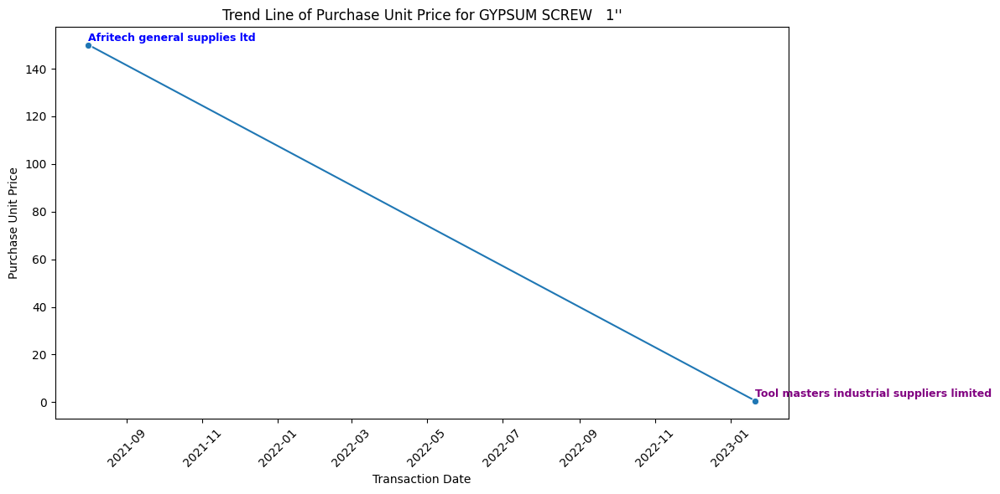

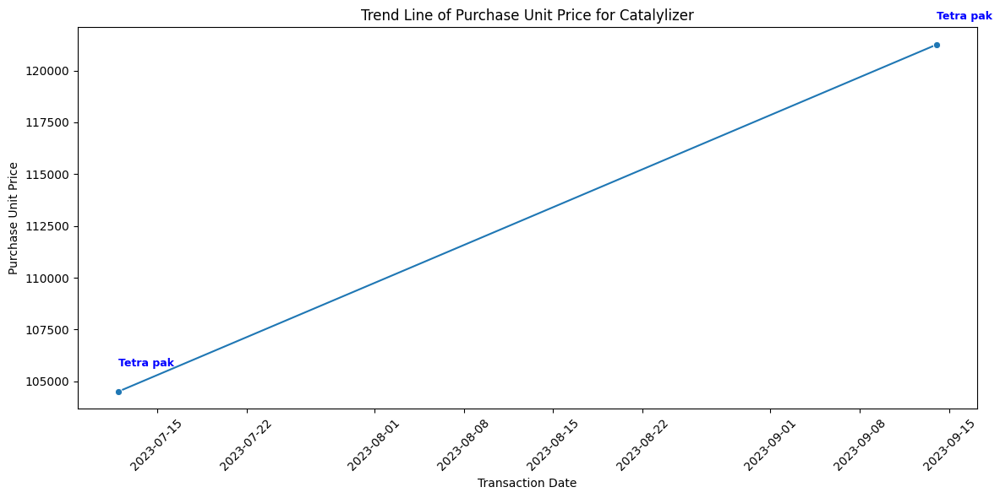

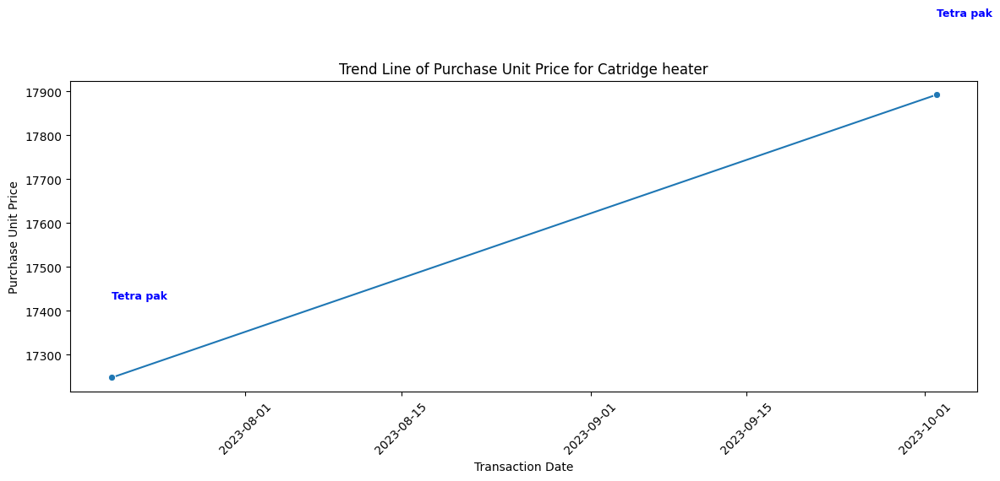

<ipython-input-17-de13d2447d94>:50: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


ValueError: ignored

<Figure size 1200x600 with 1 Axes>

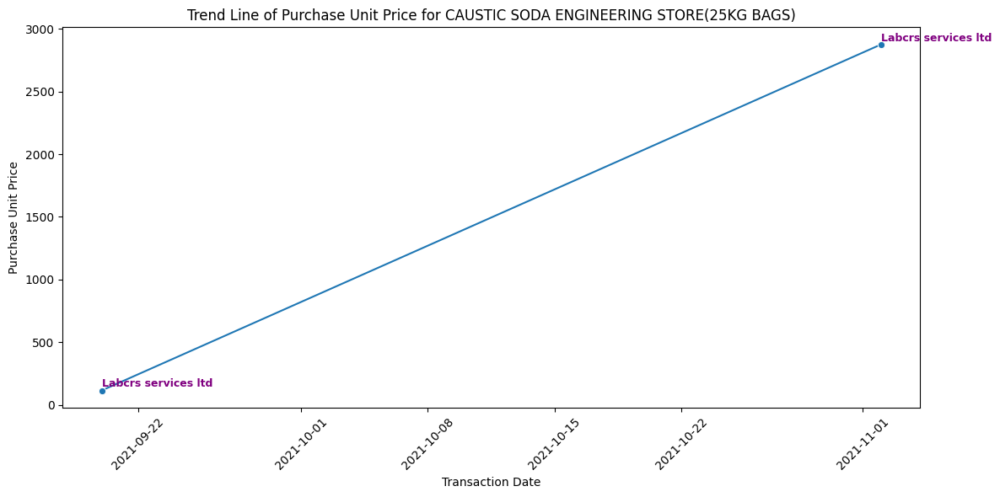

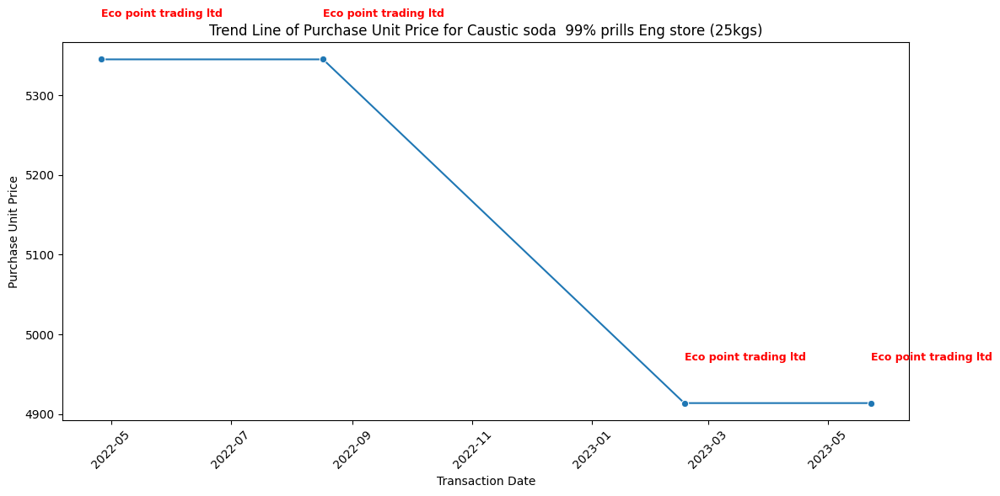

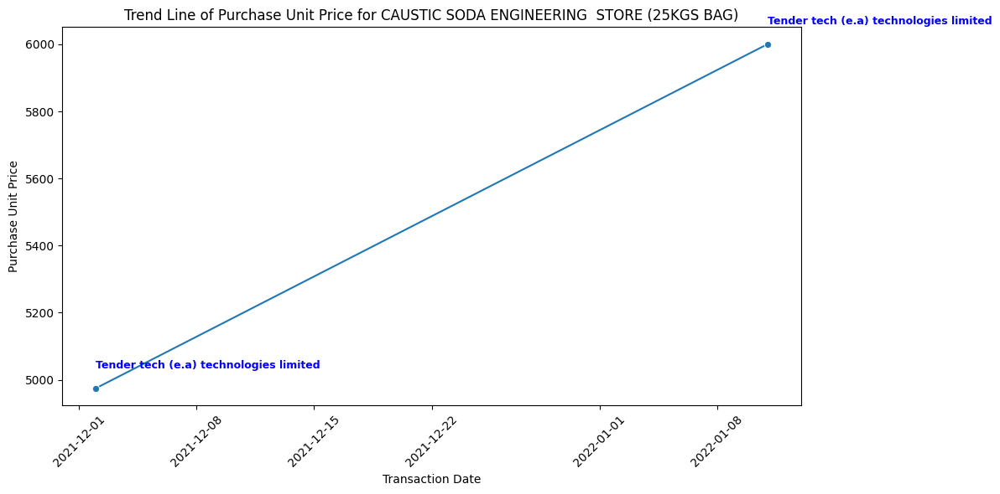

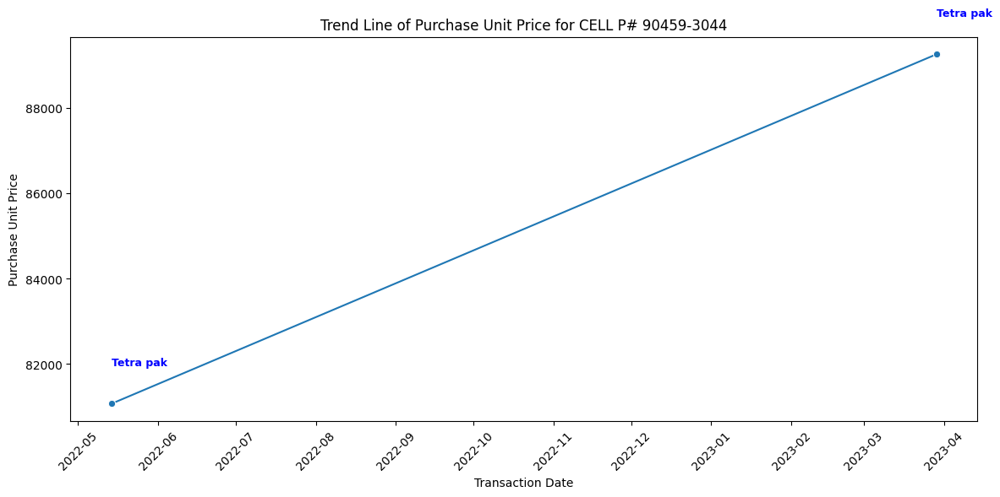

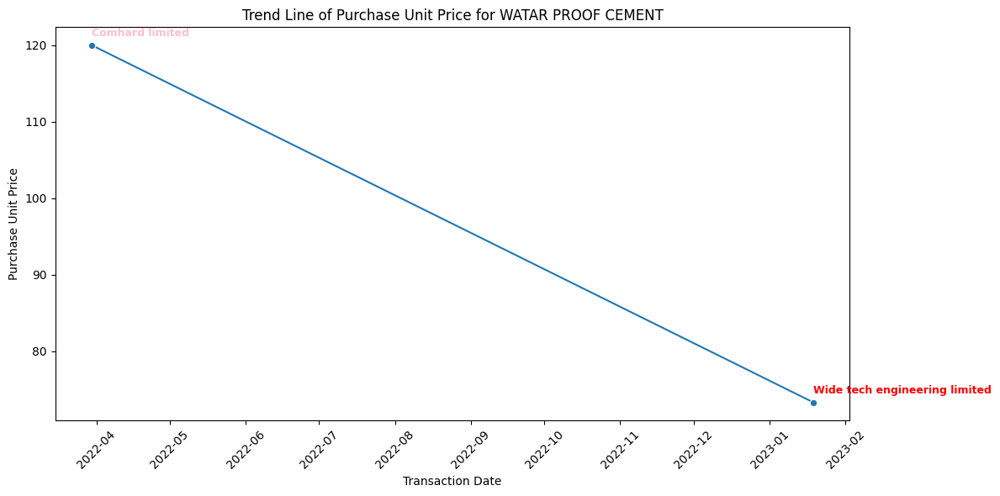

...

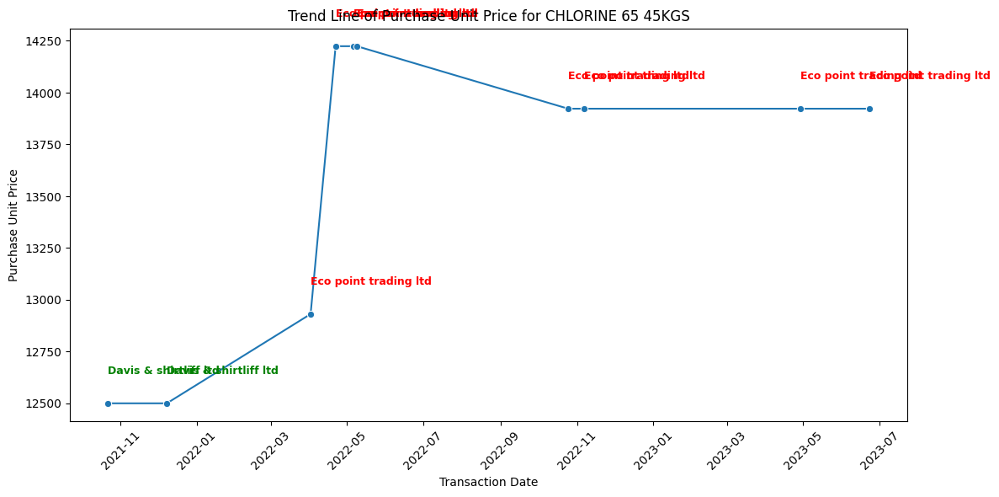

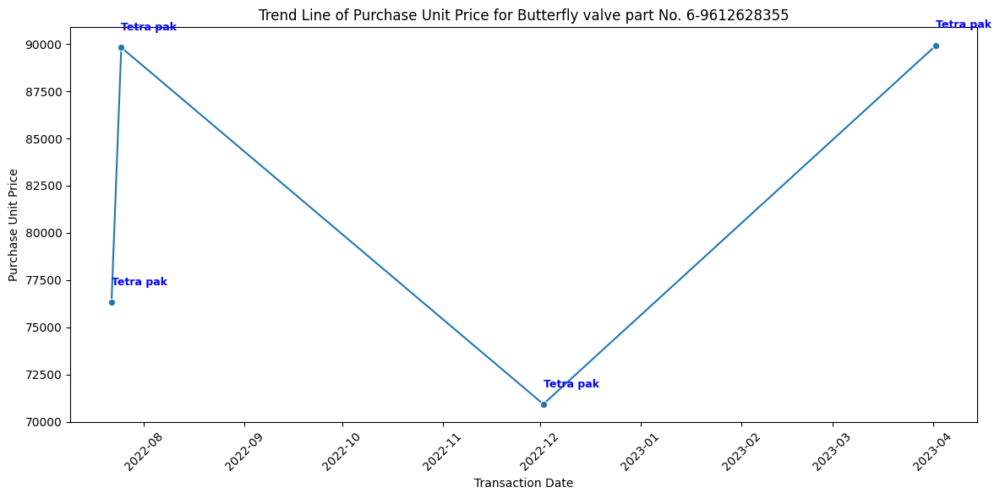

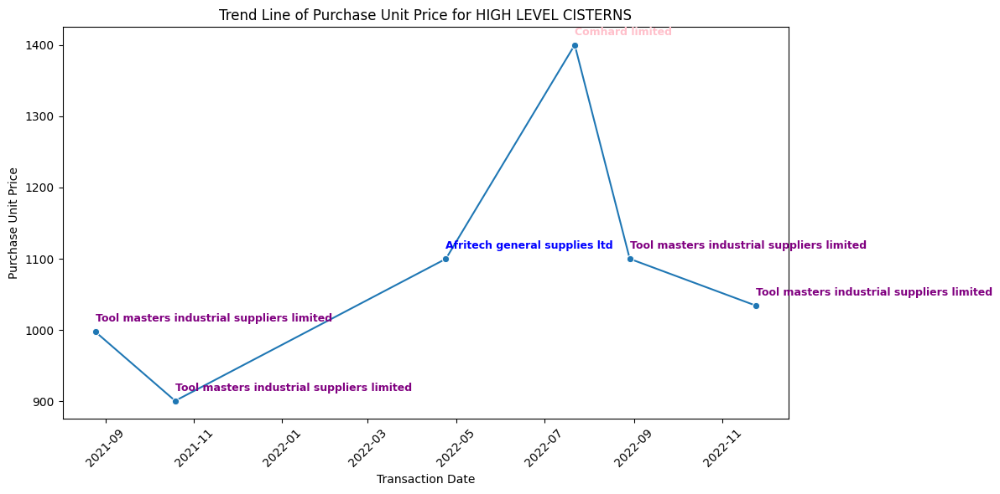

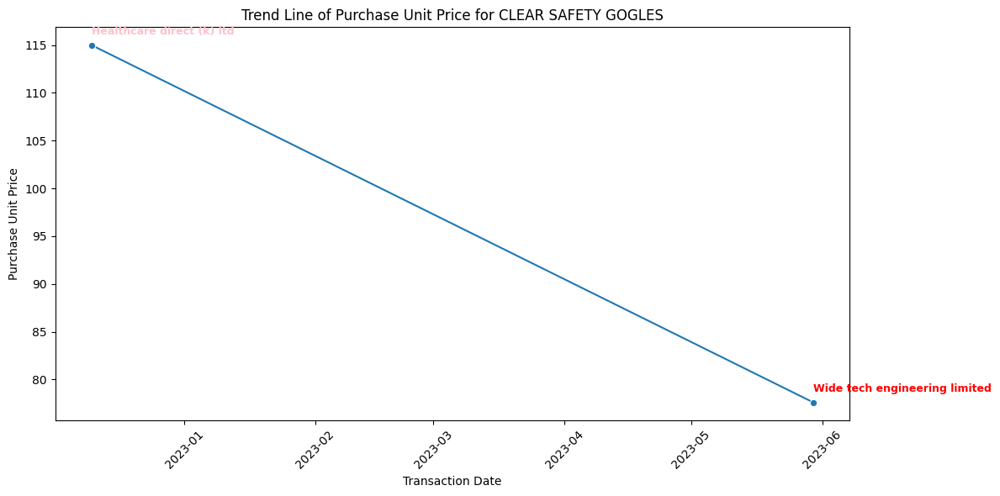

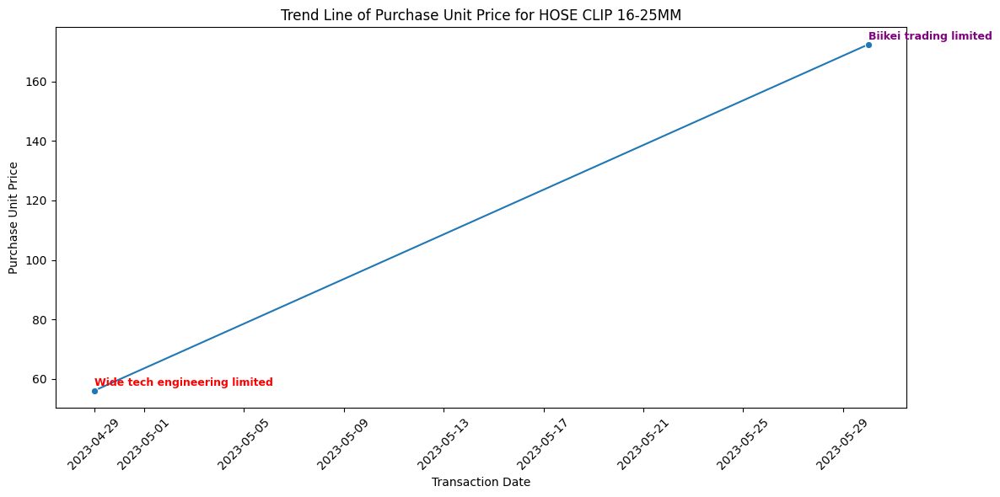

<ipython-input-17-de13d2447d94>:50: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


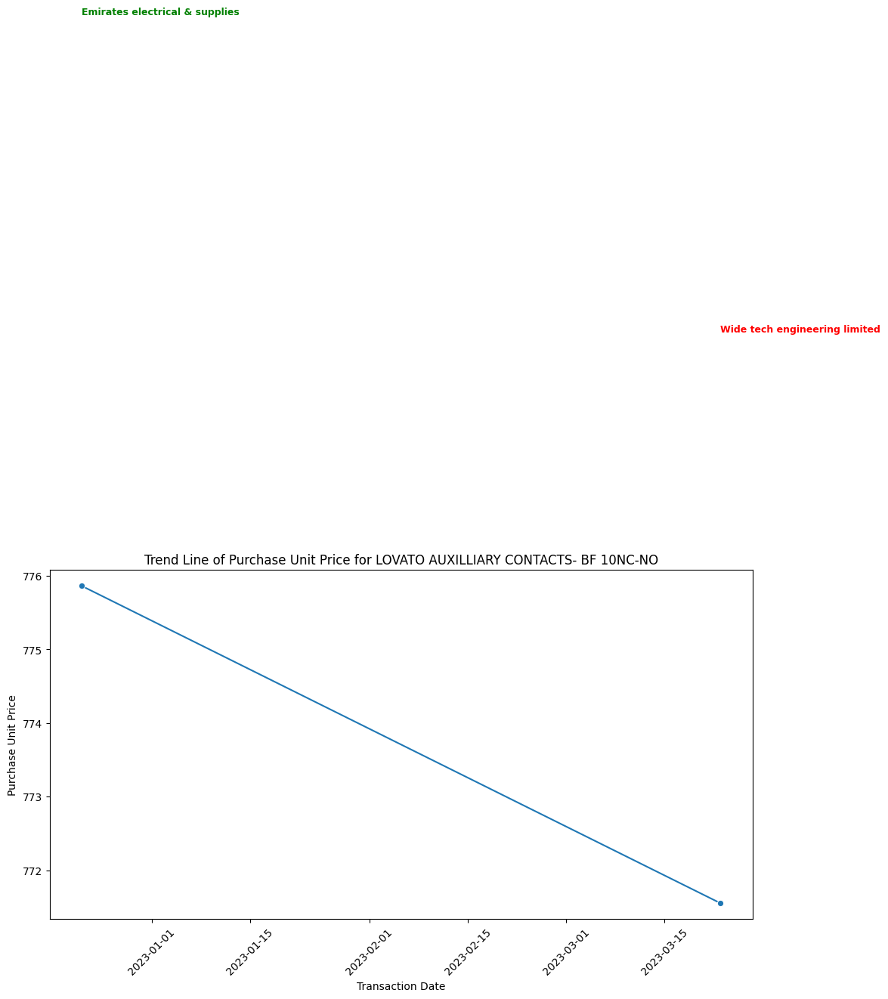

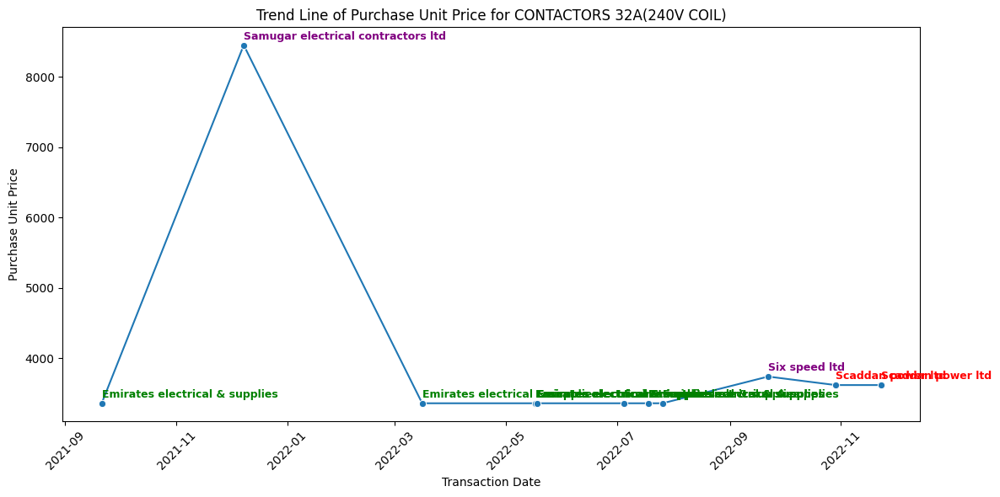

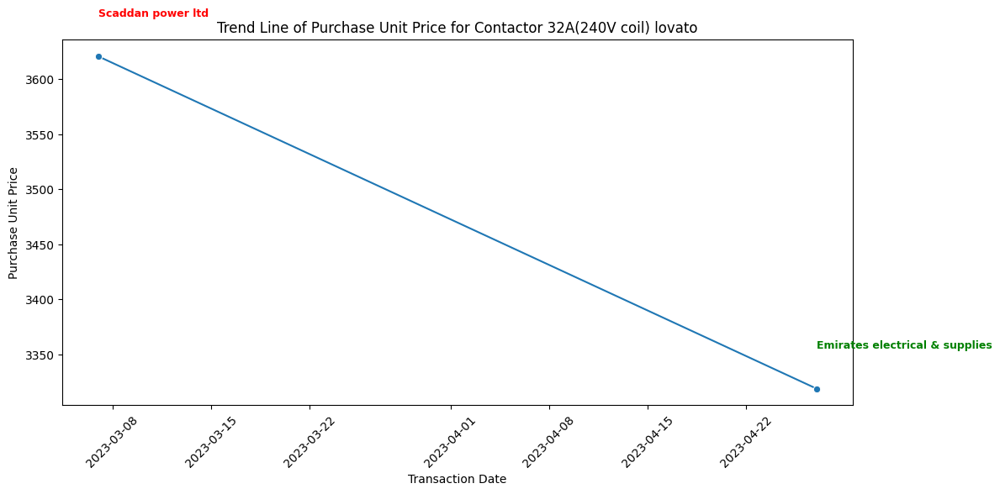

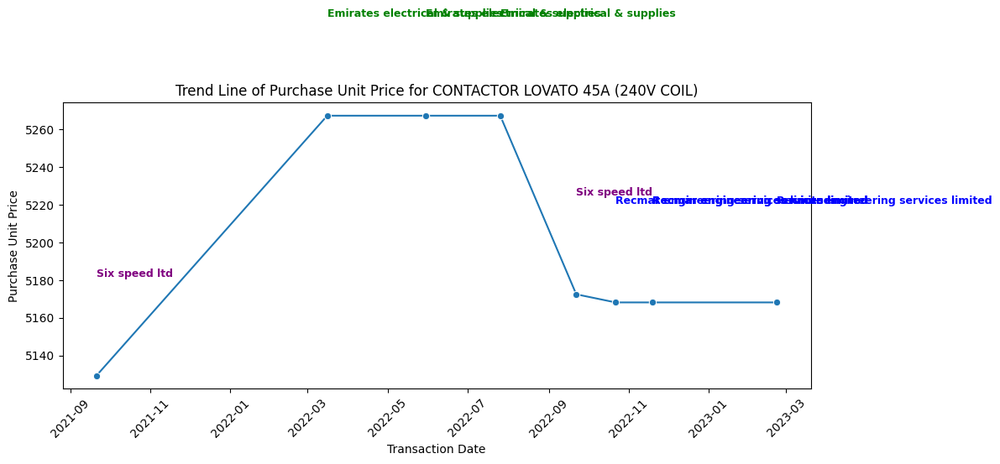

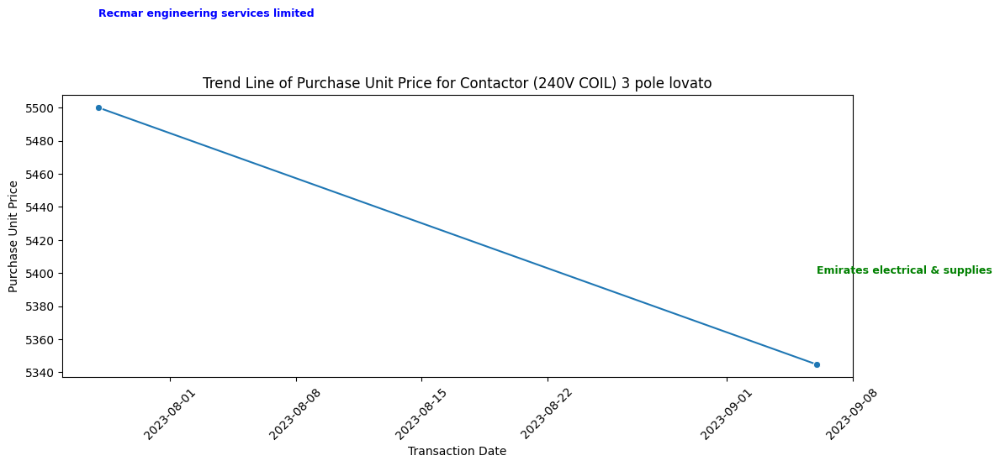

...

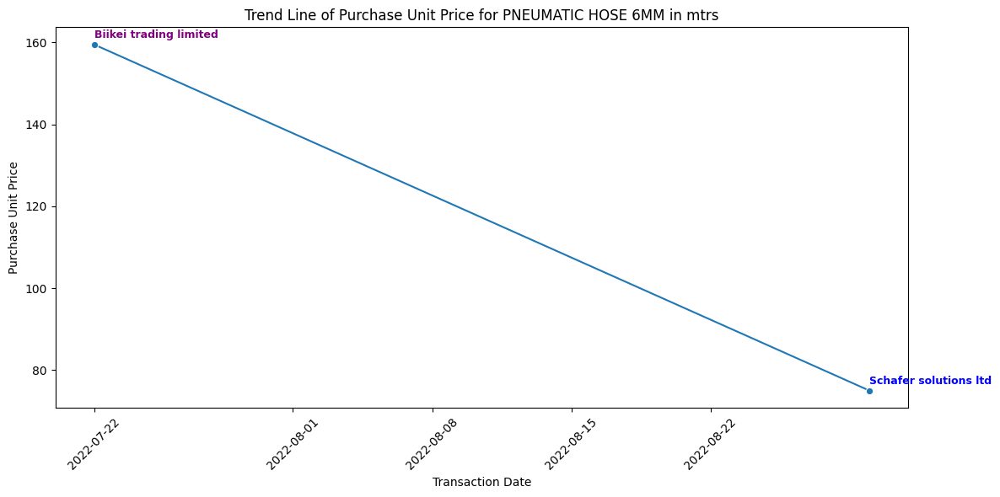

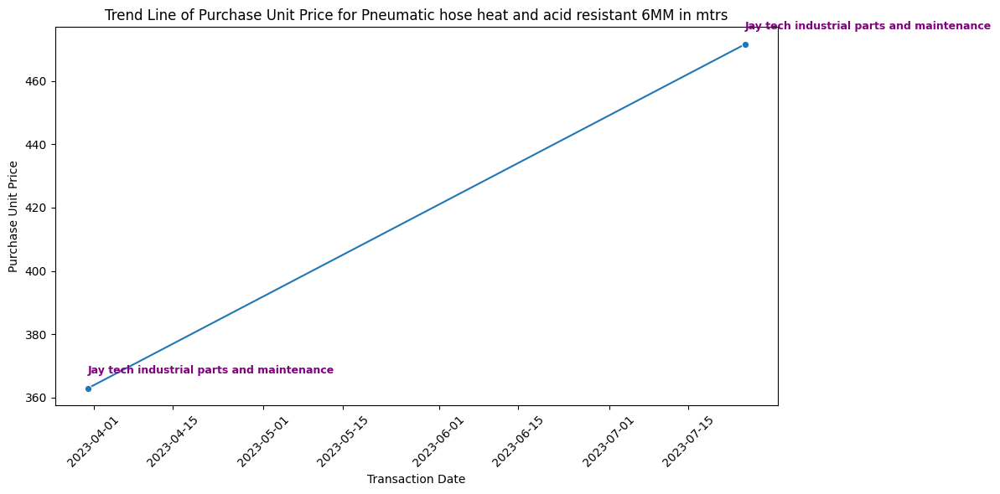

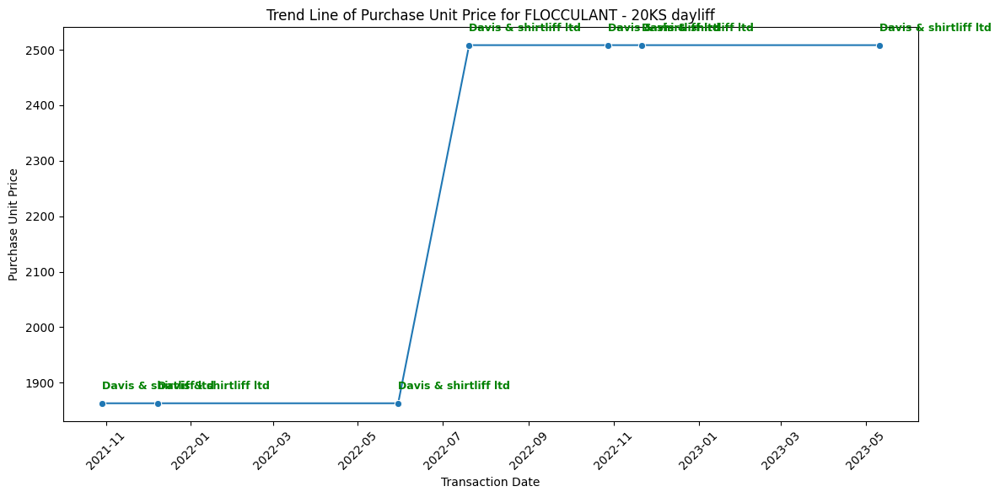

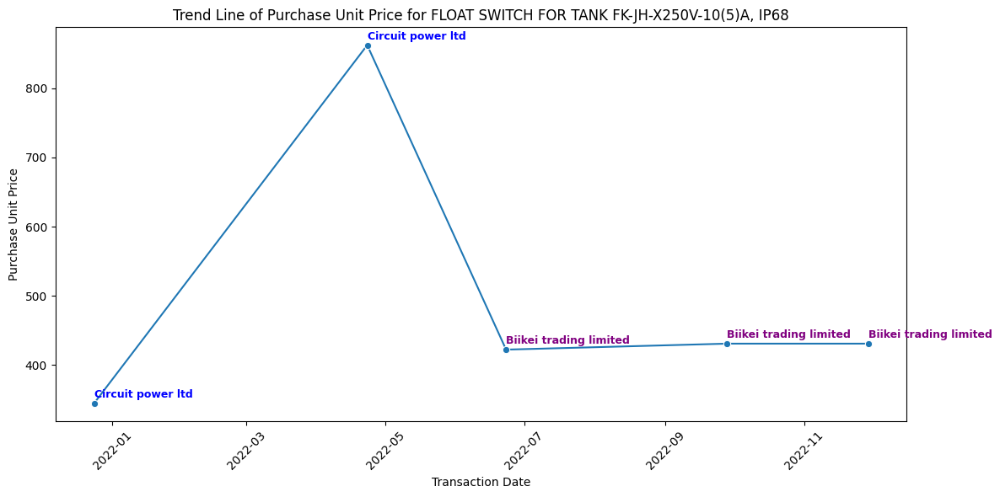

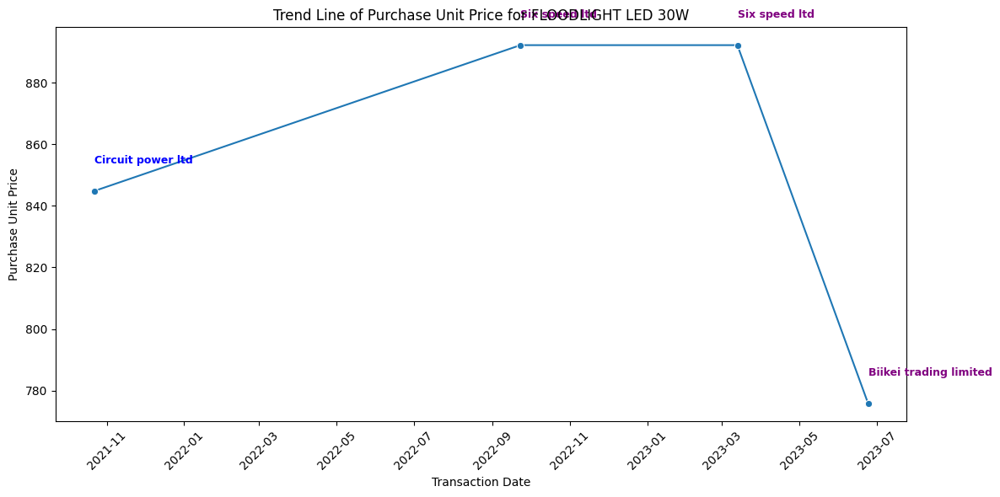

<ipython-input-17-de13d2447d94>:50: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


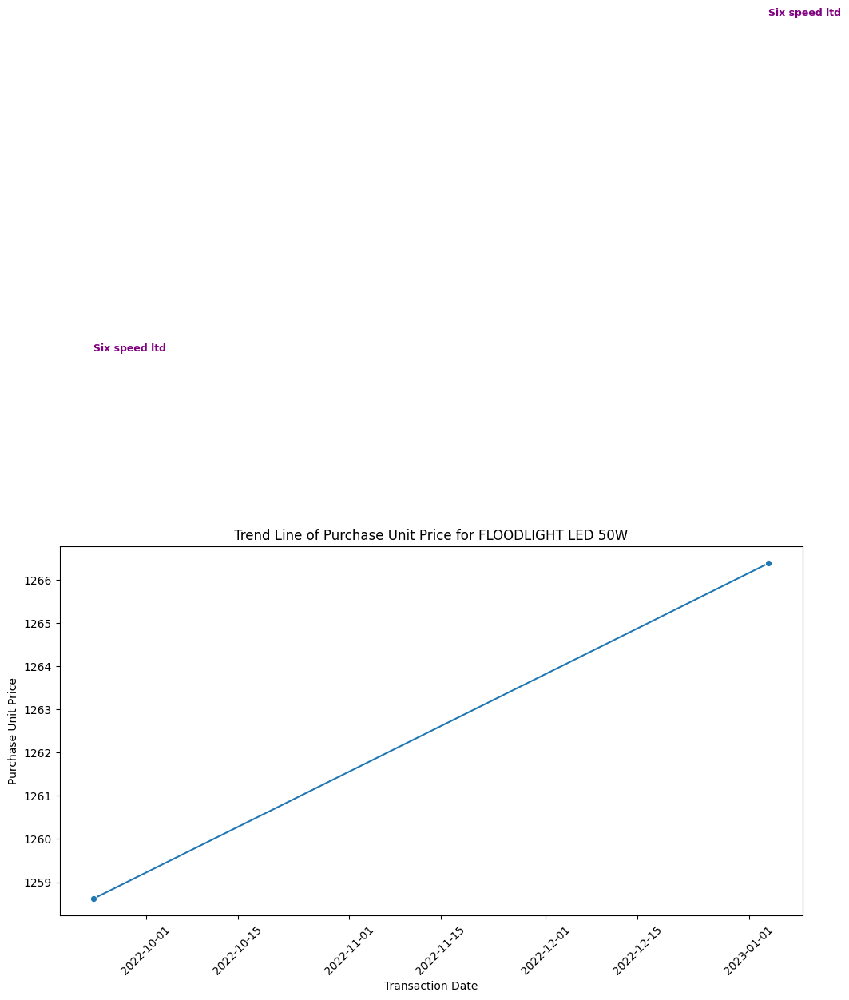

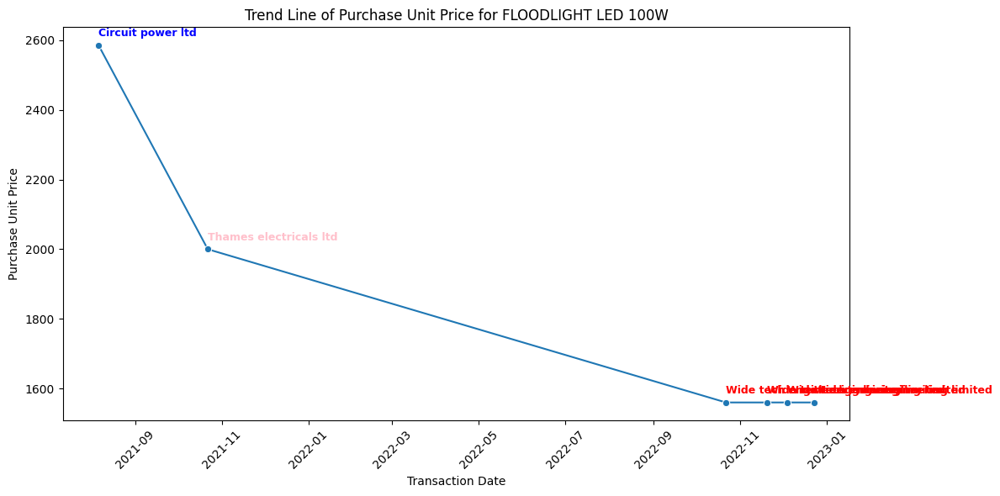

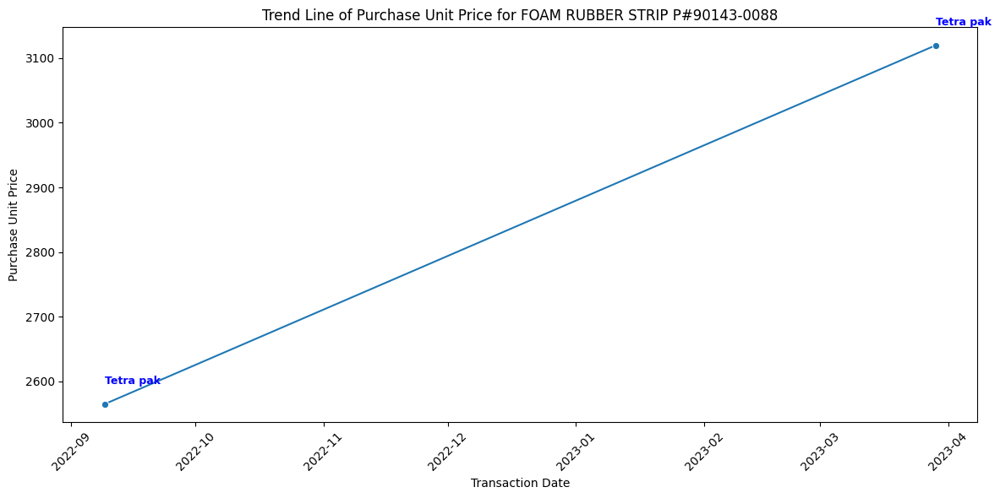

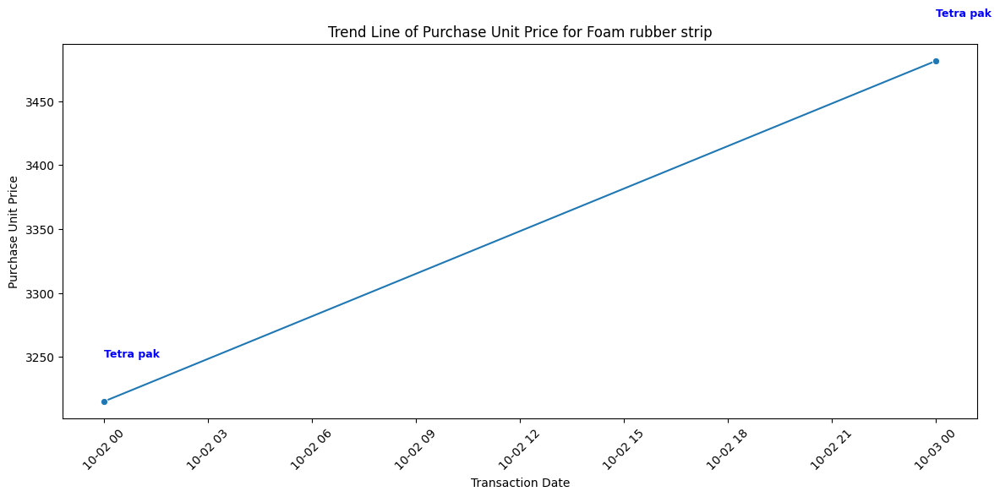

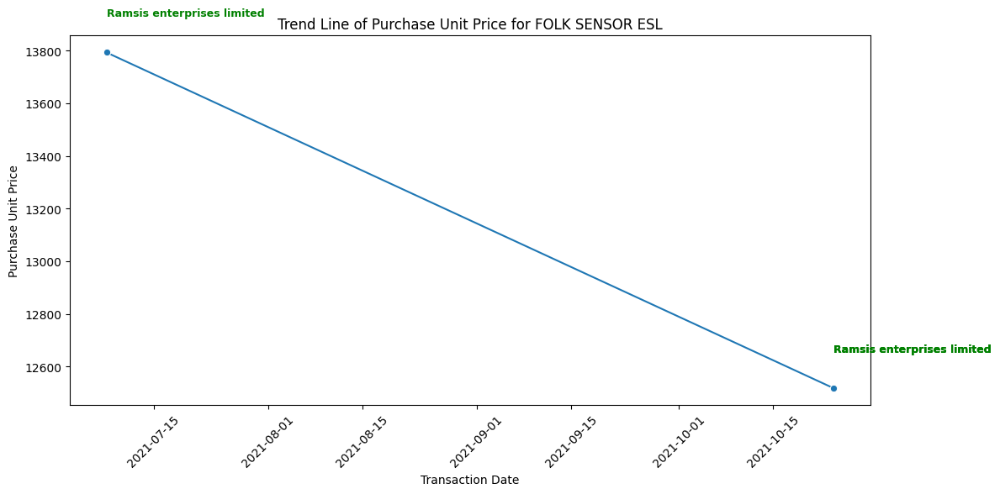

...

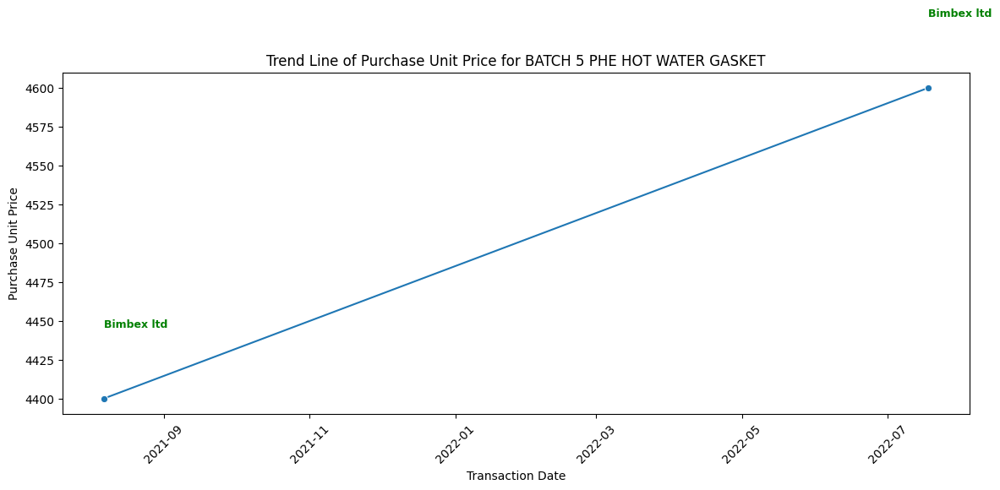

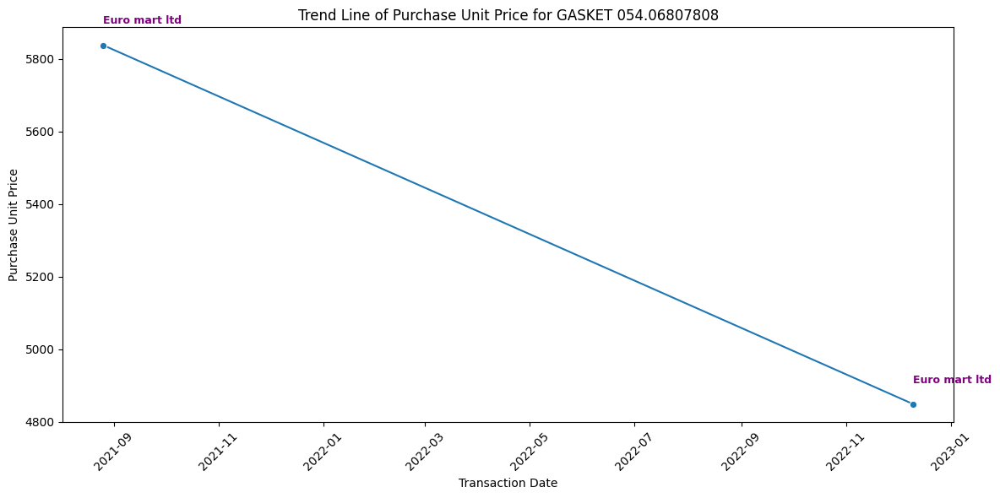

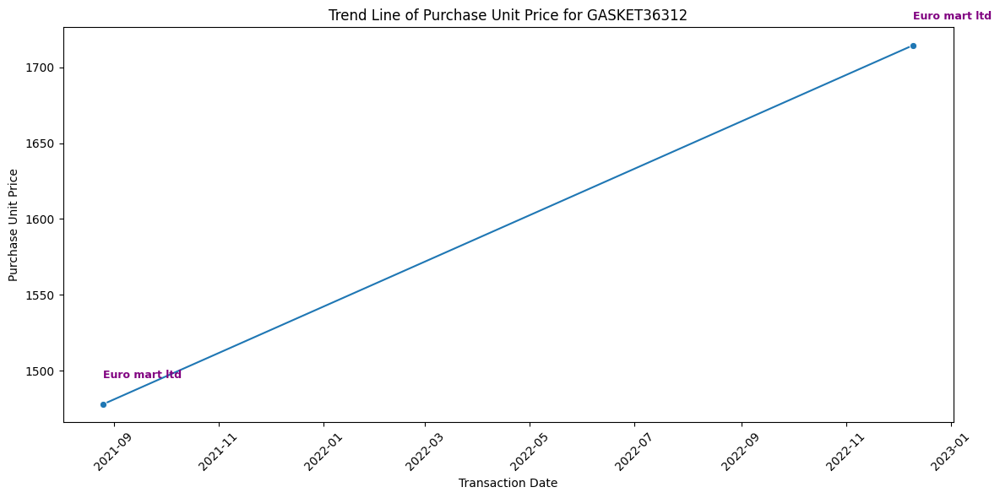

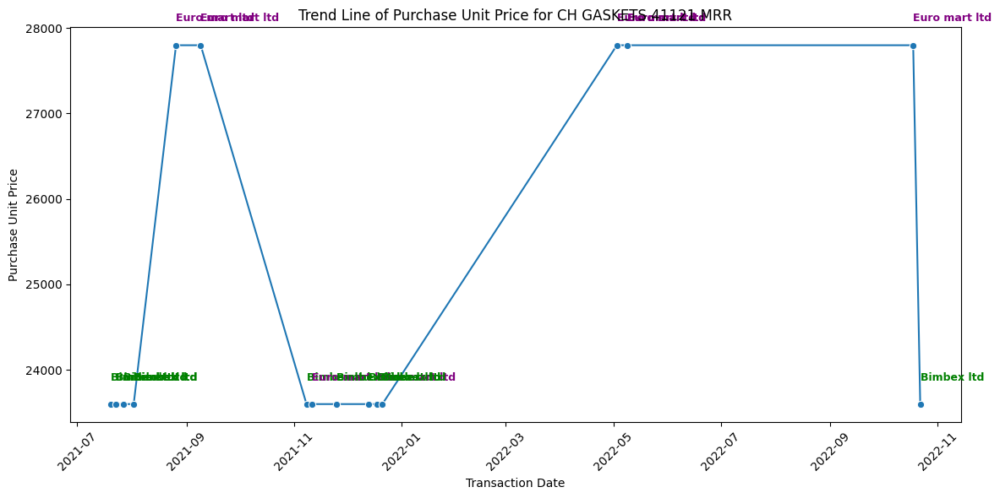

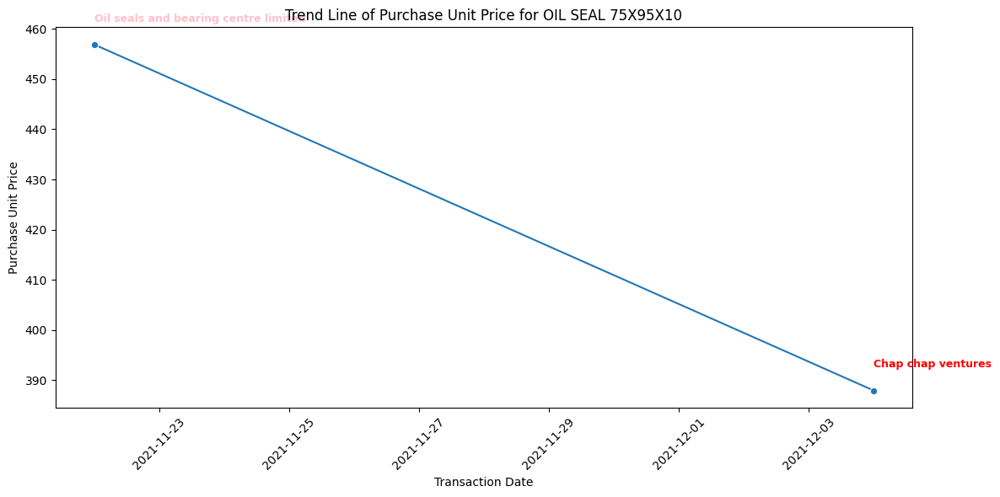

<ipython-input-17-de13d2447d94>:50: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


ValueError: ignored

<Figure size 1200x600 with 1 Axes>

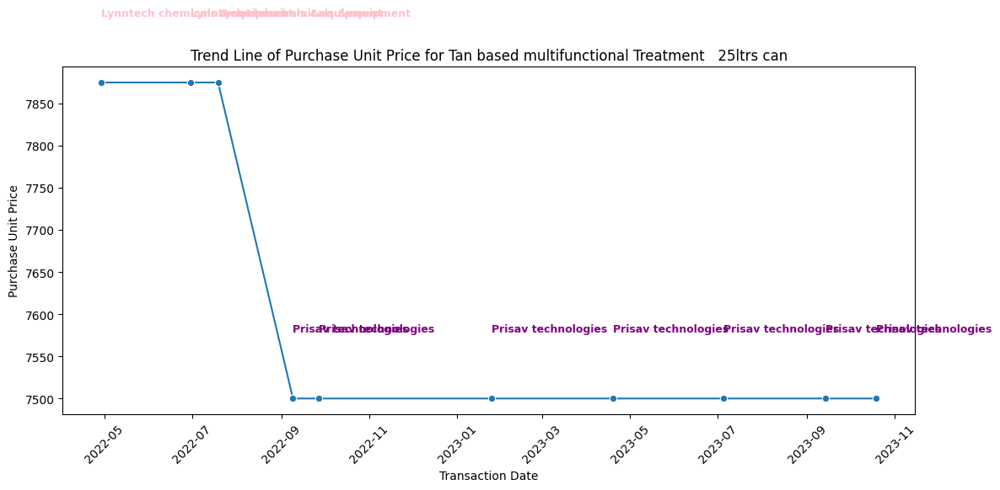

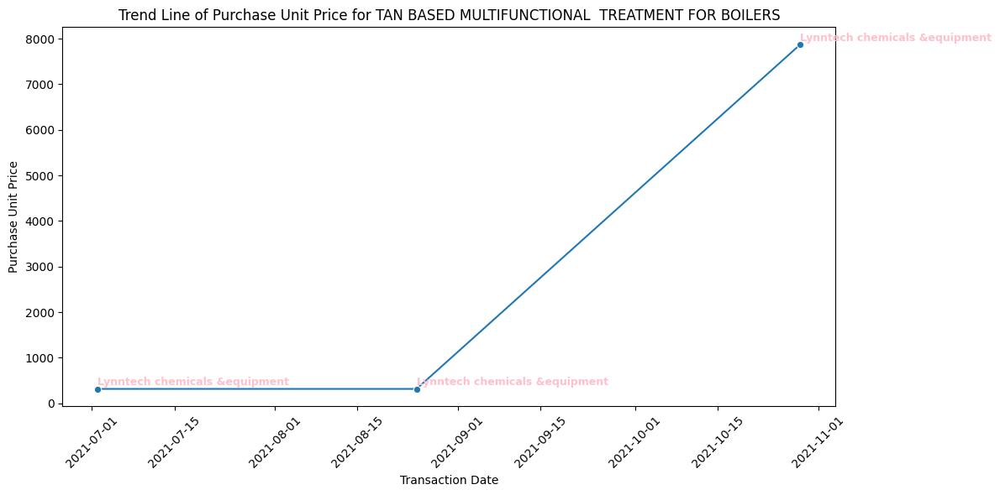

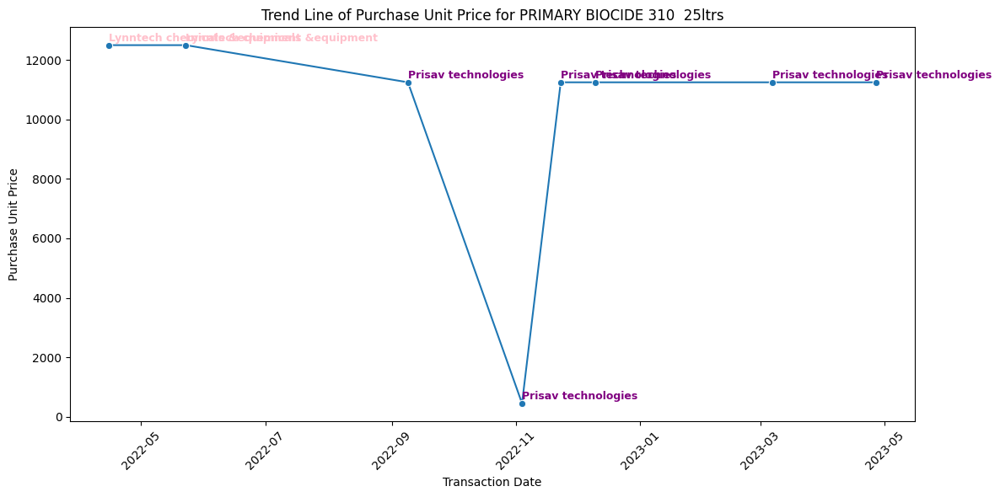

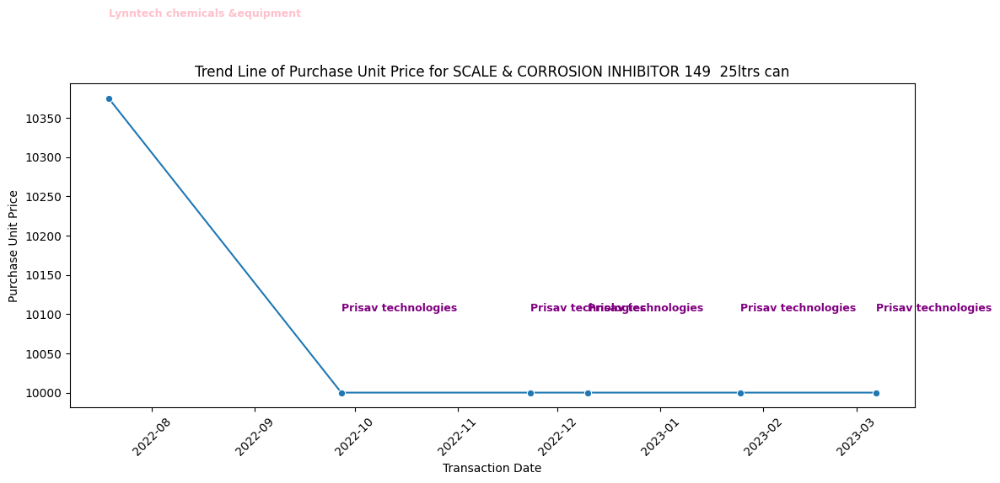

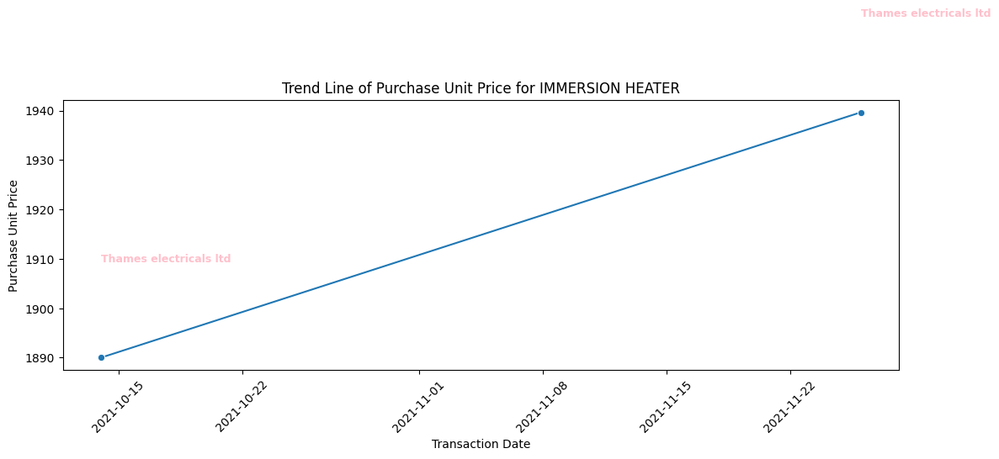

...

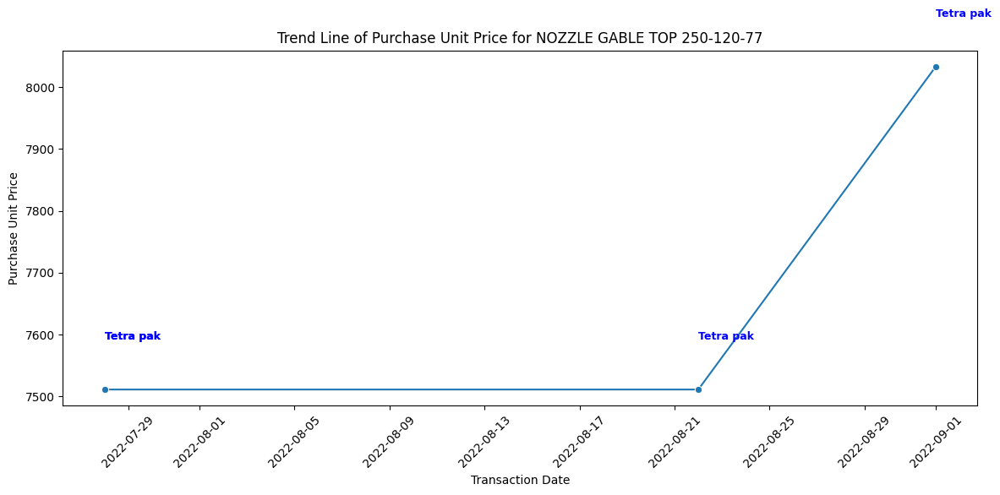

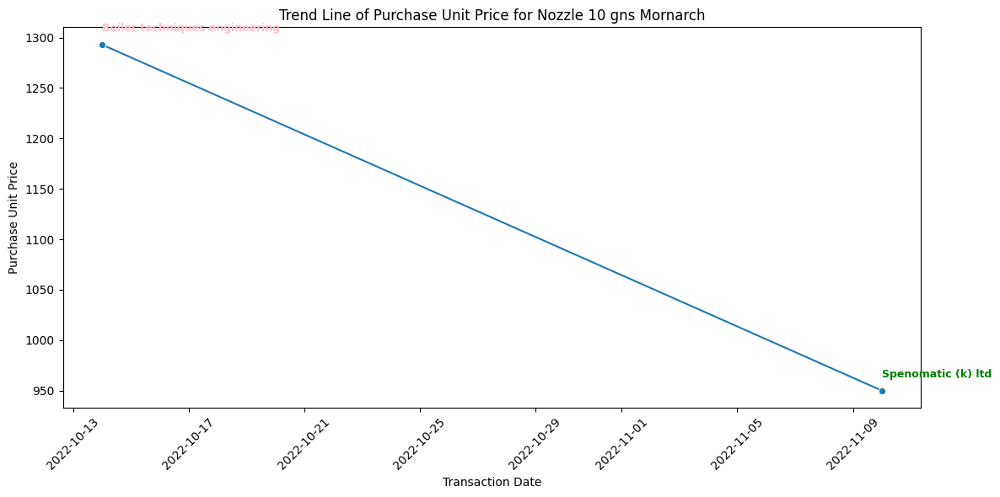

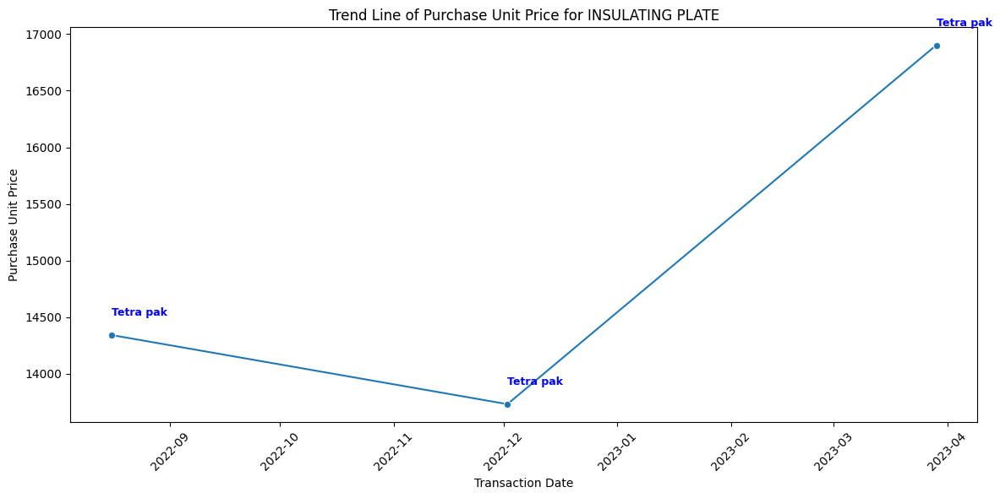

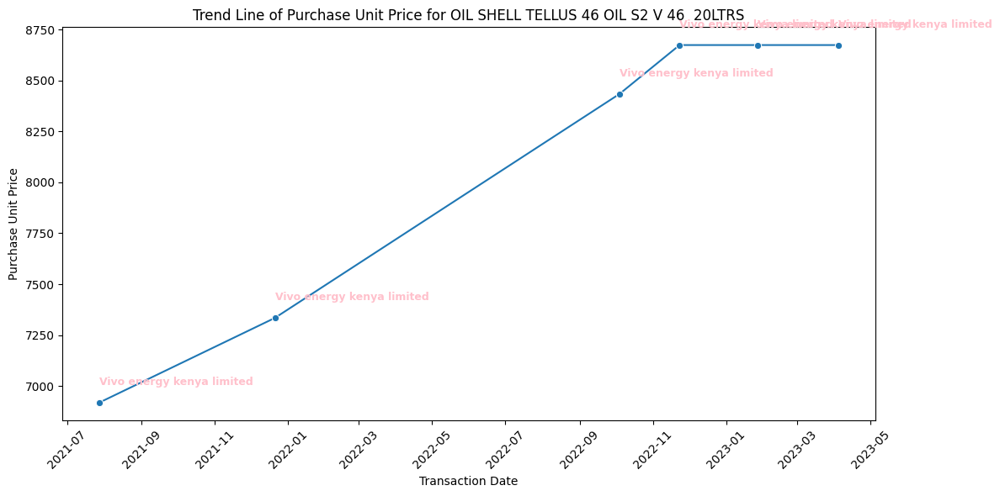

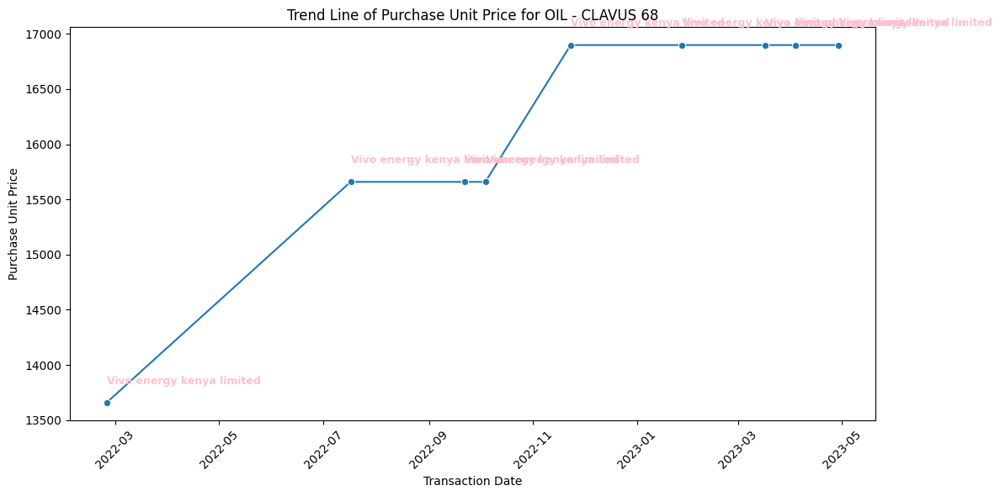

<ipython-input-17-de13d2447d94>:50: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


ValueError: ignored

<Figure size 1200x600 with 1 Axes>

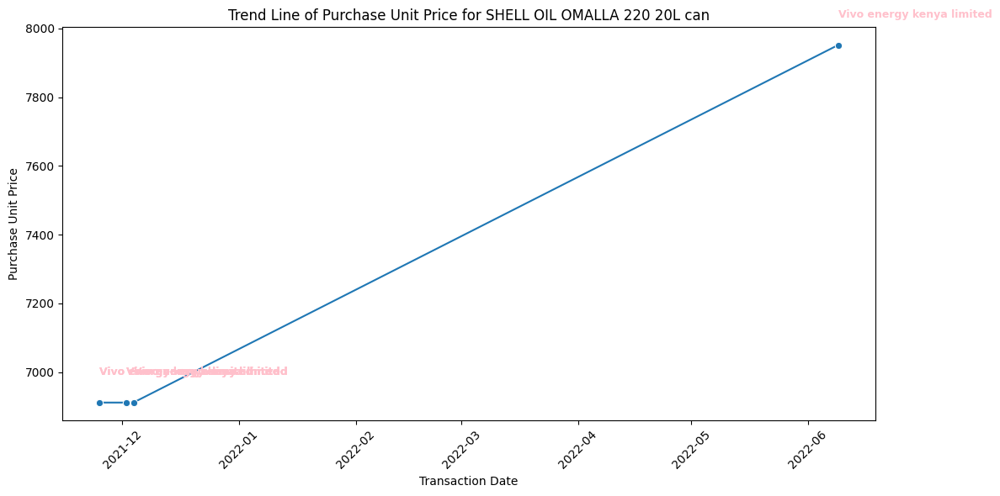

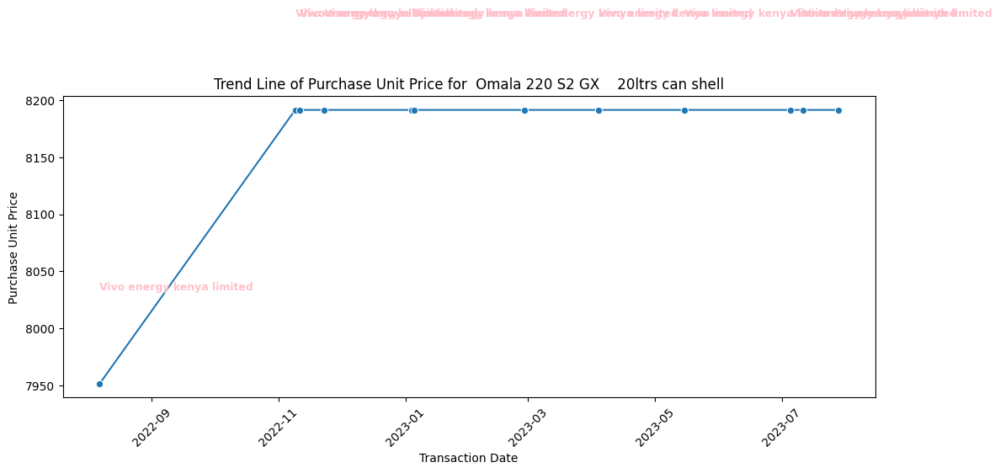

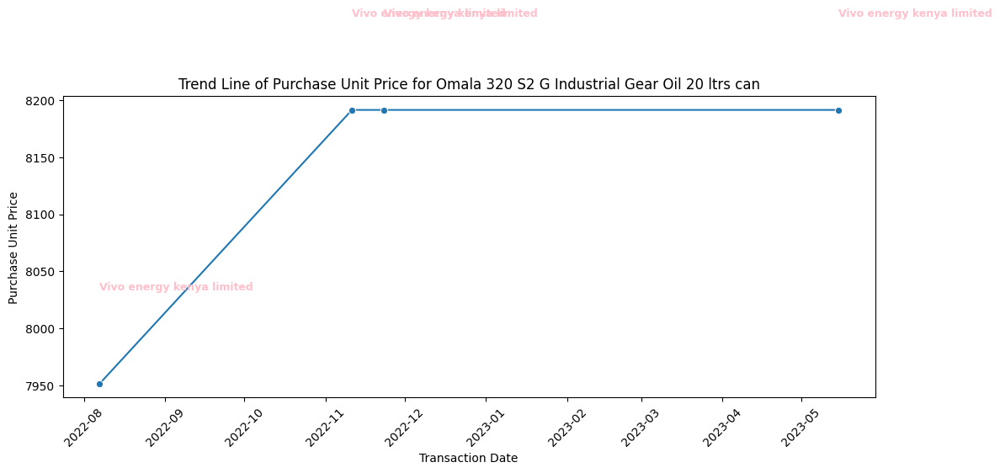

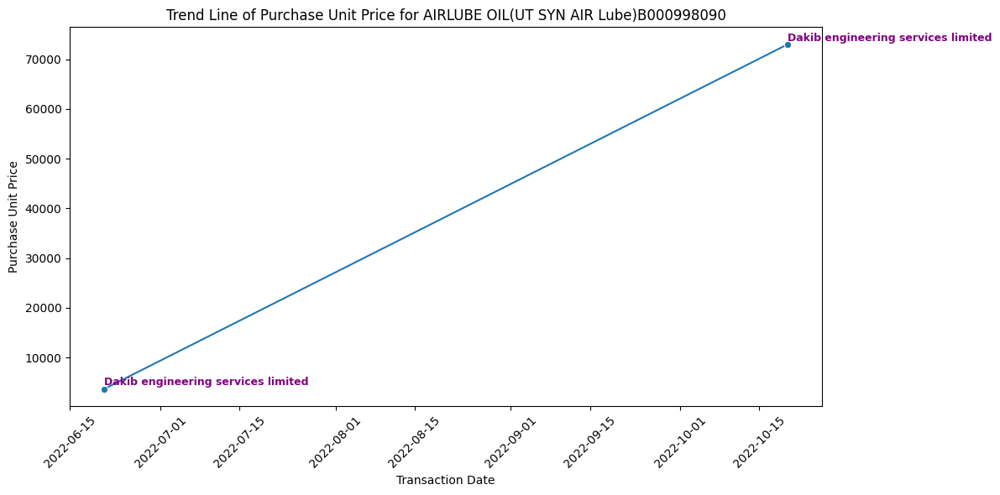

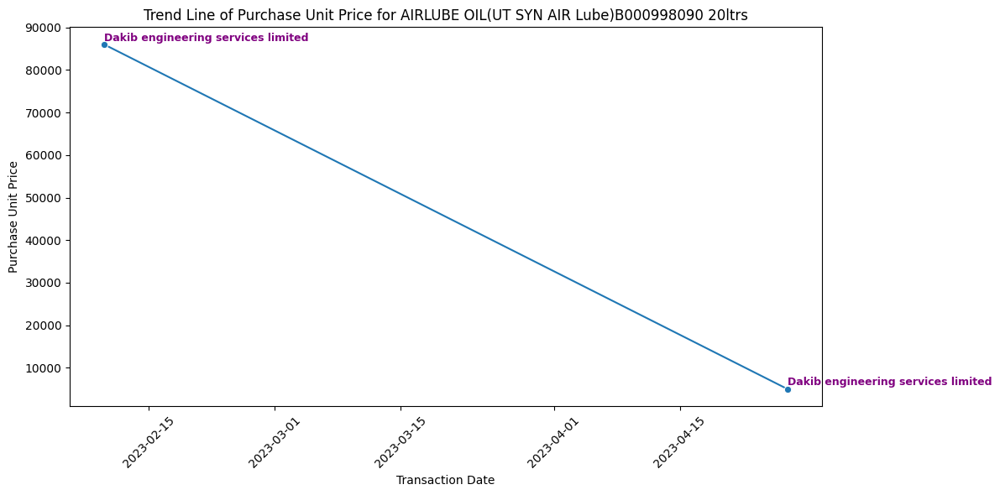

...

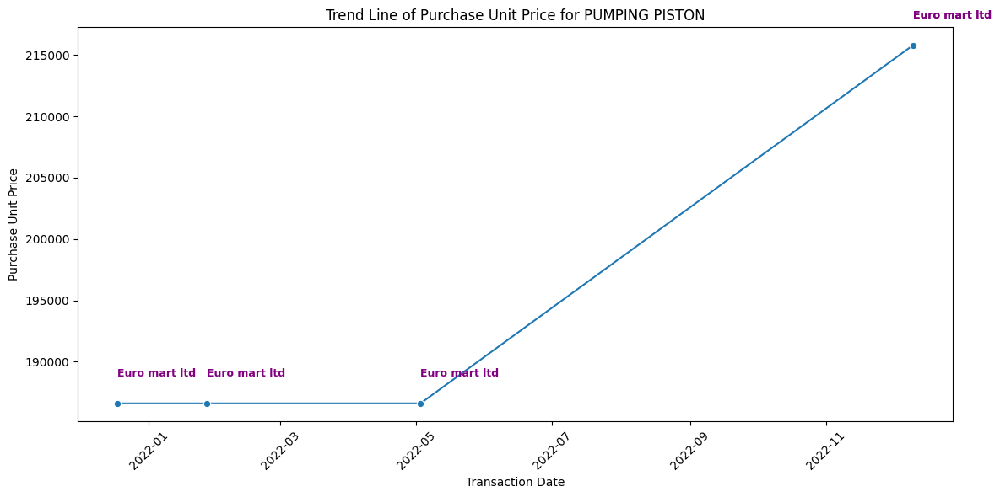

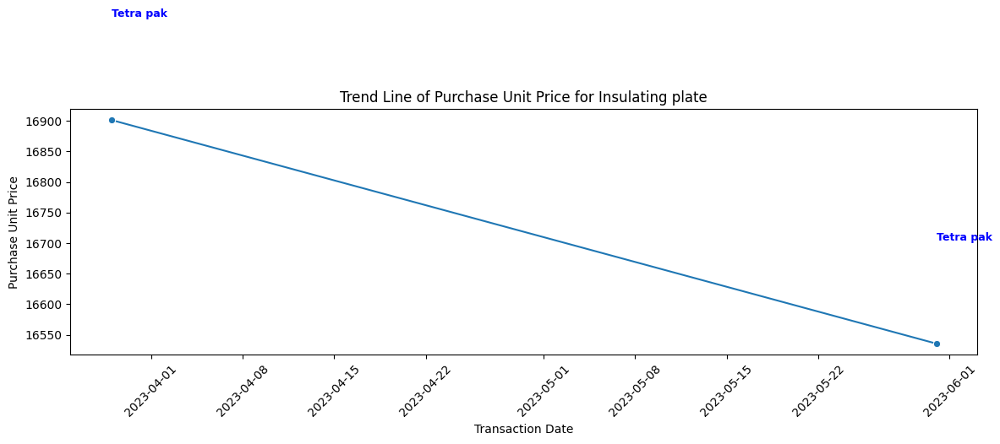

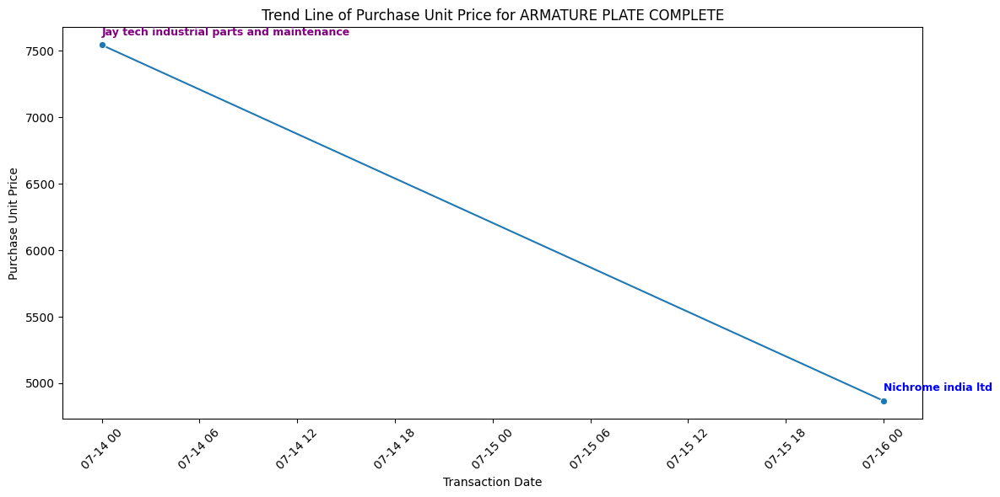

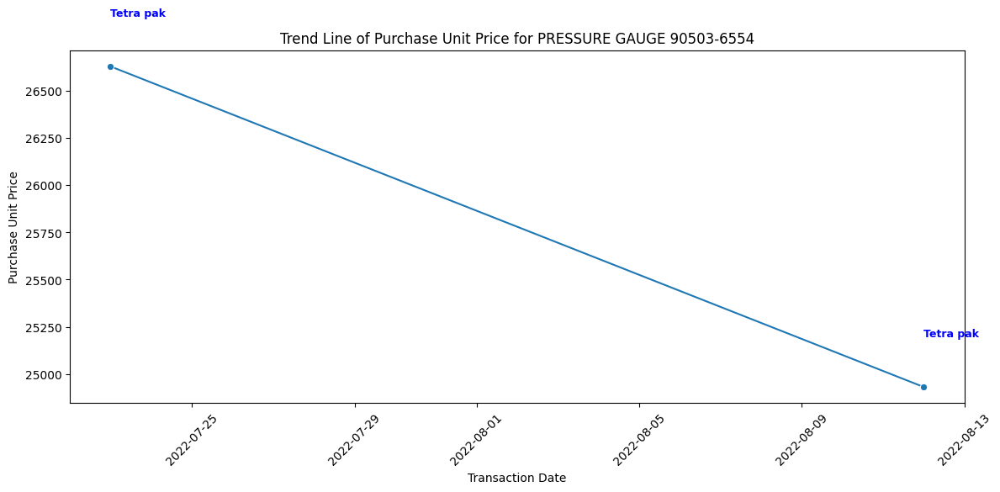

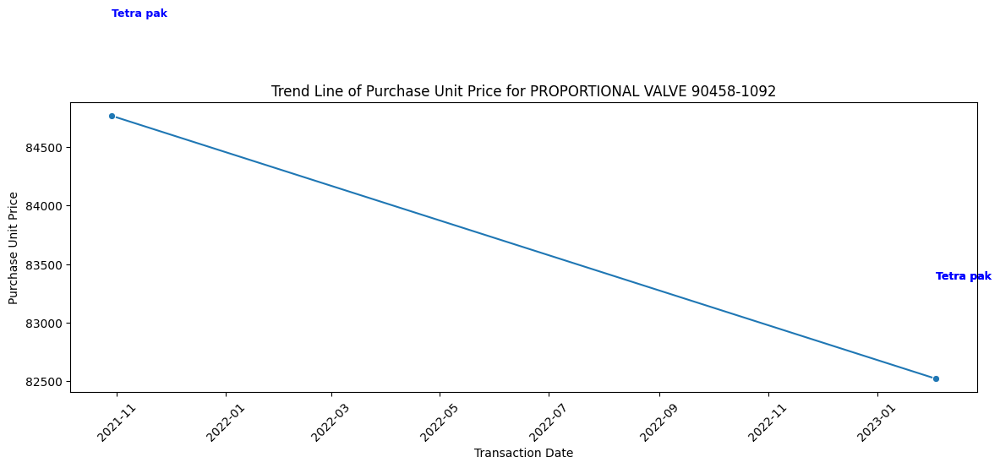

<ipython-input-17-de13d2447d94>:50: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


ValueError: ignored

<Figure size 1200x600 with 1 Axes>

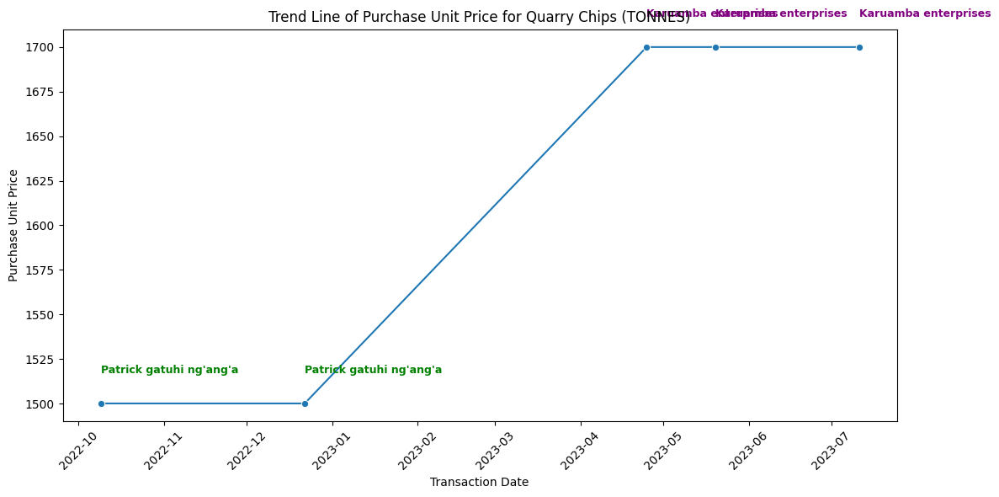

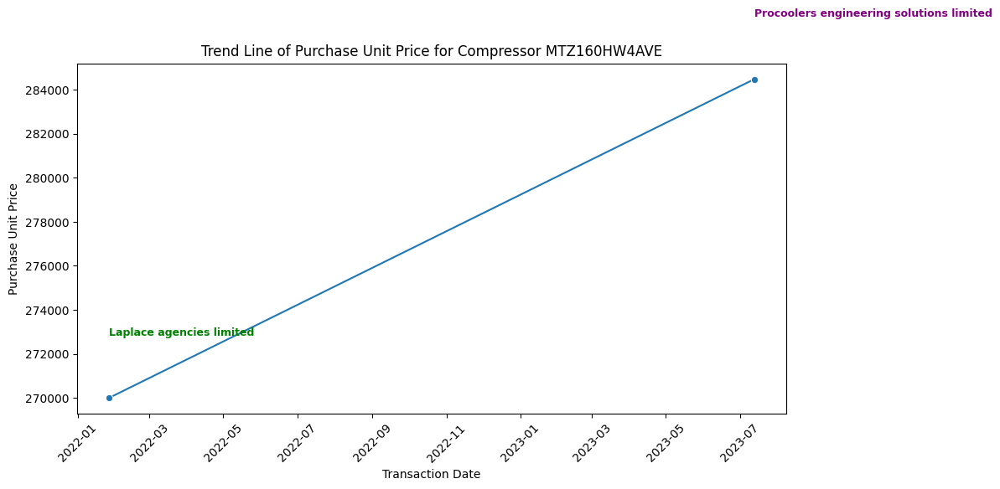

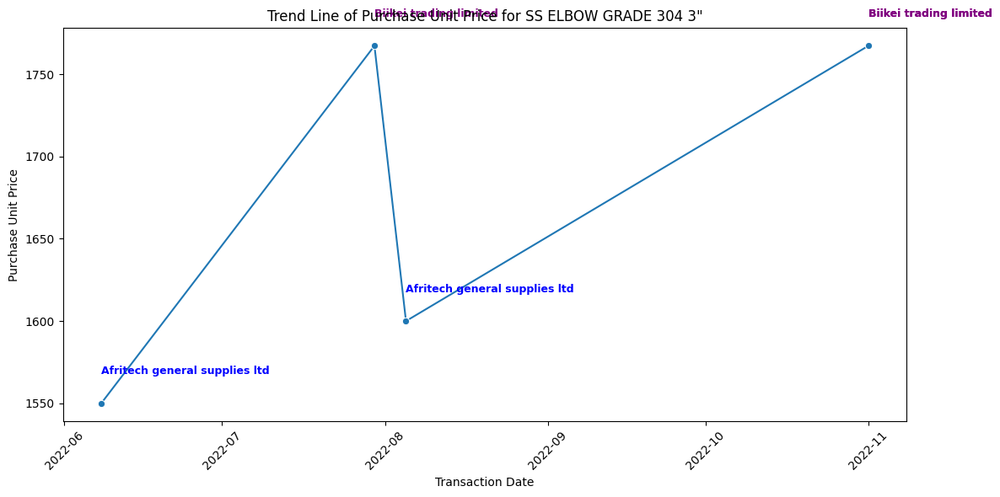

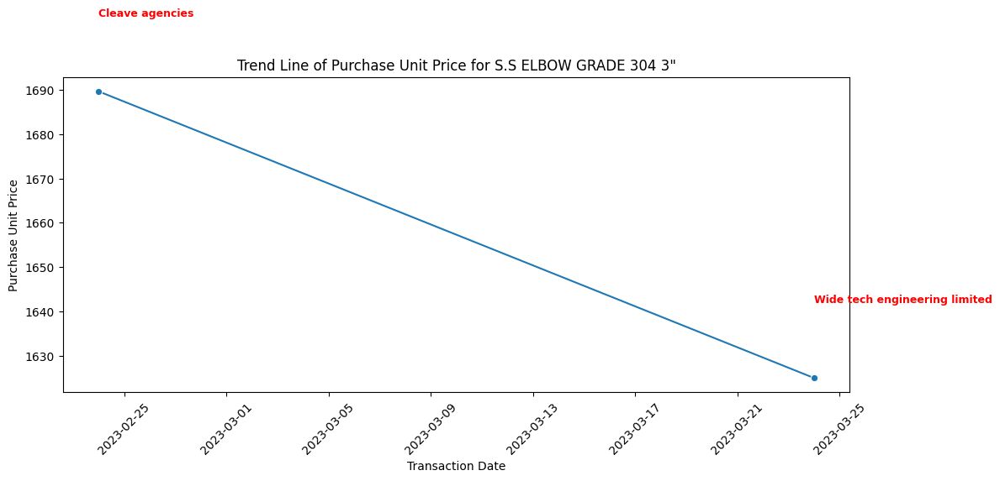

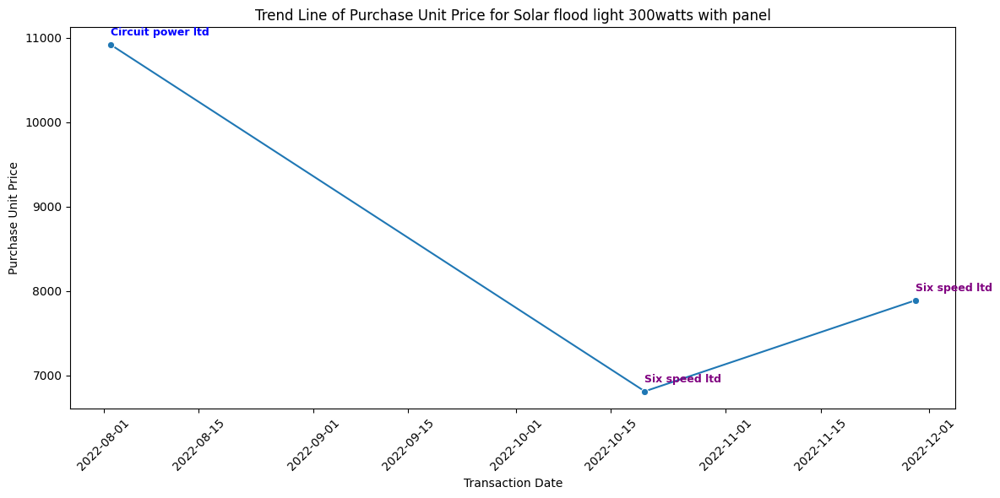

...

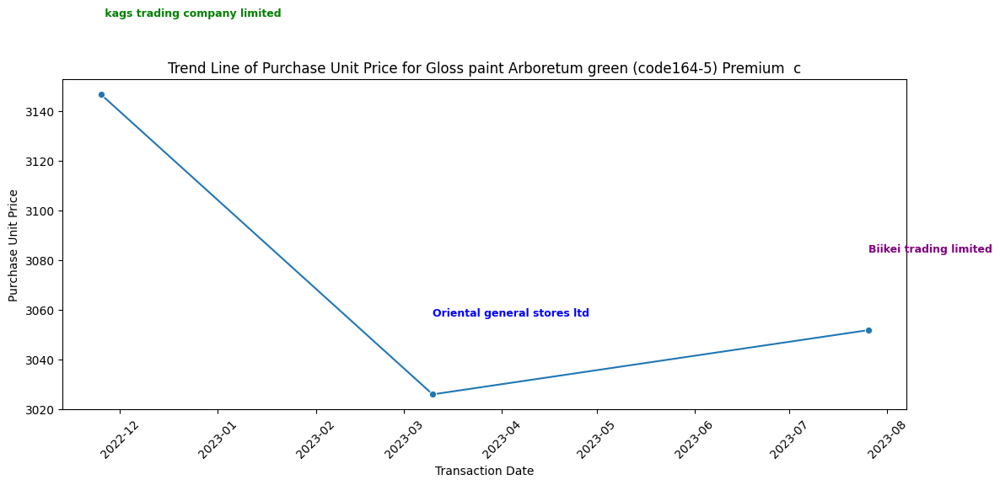

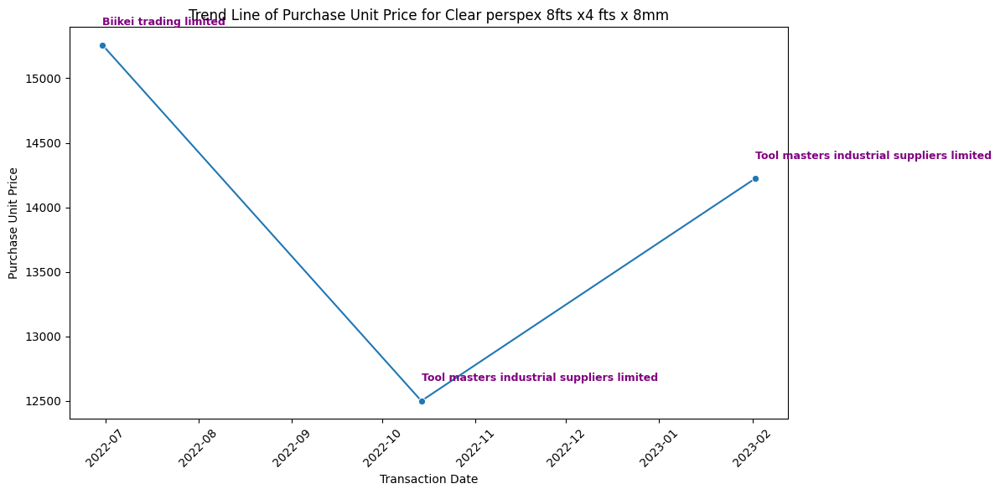

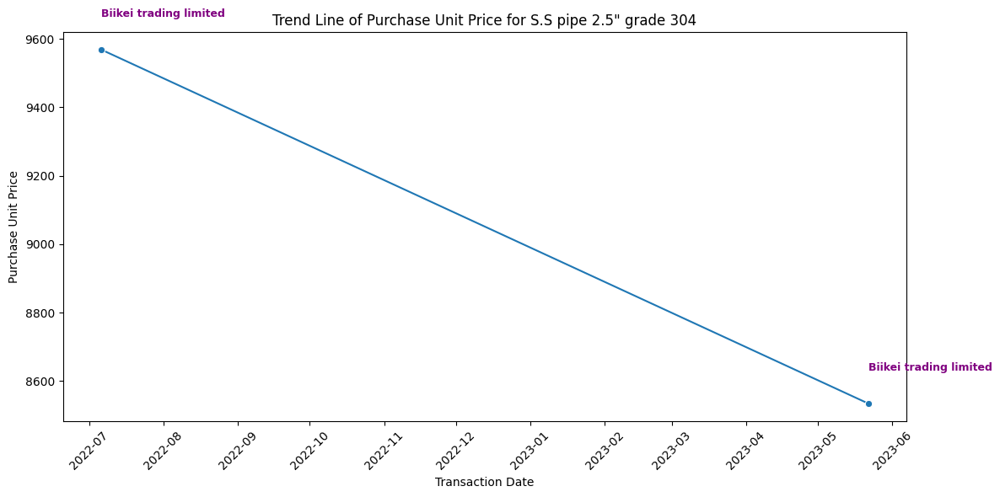

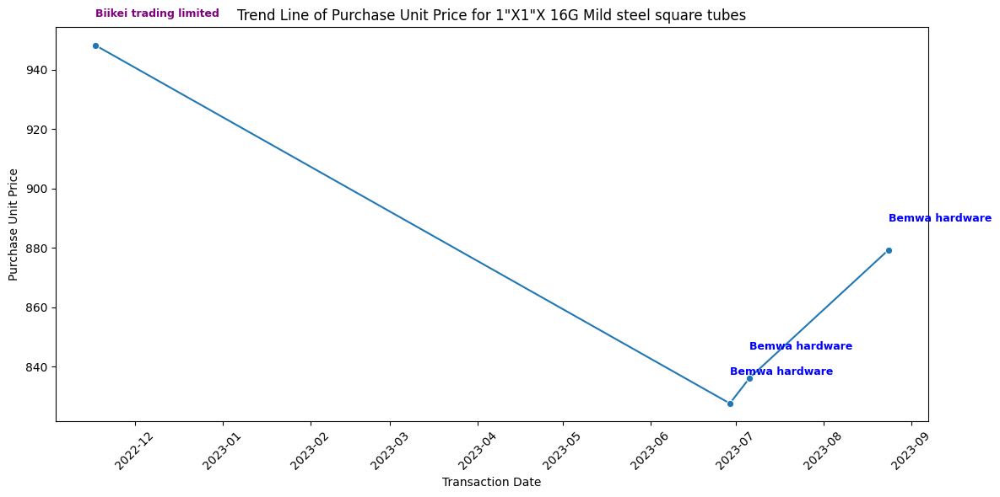

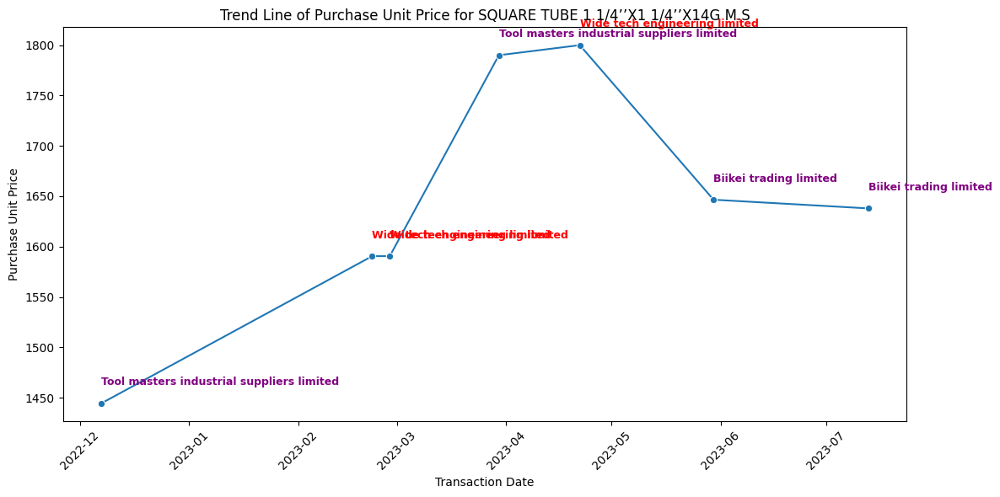

<ipython-input-17-de13d2447d94>:50: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


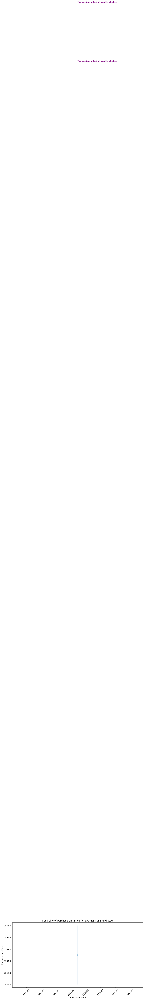

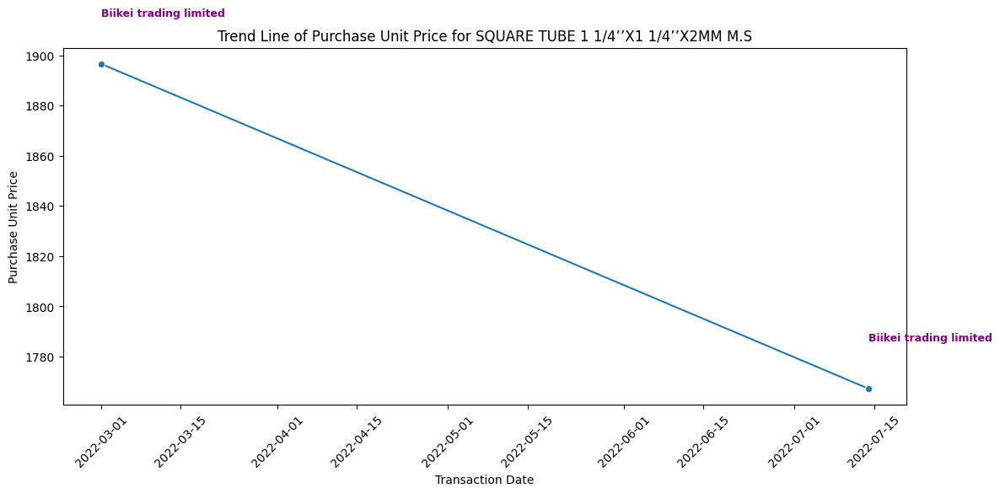

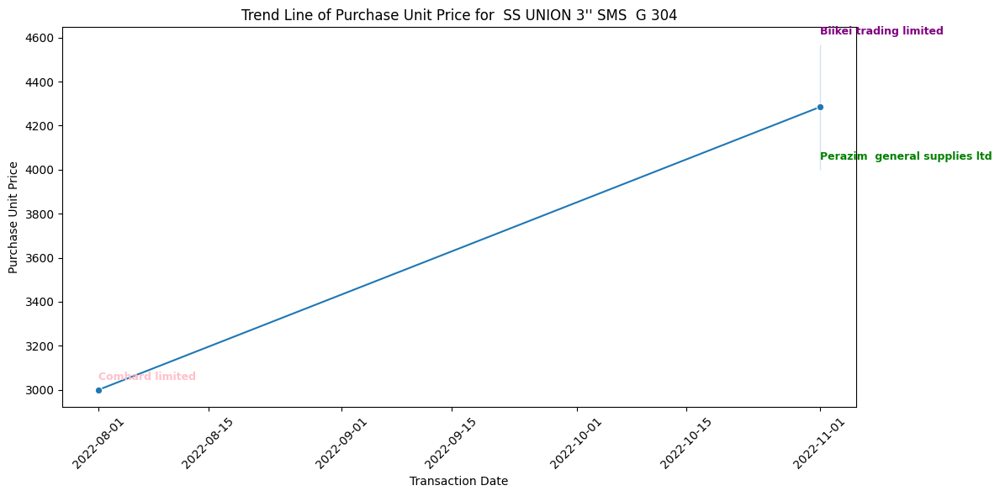

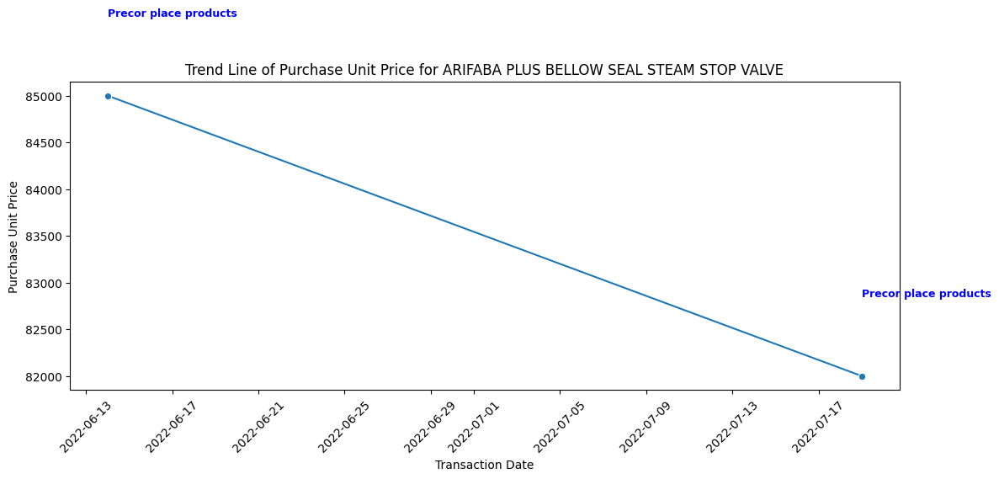

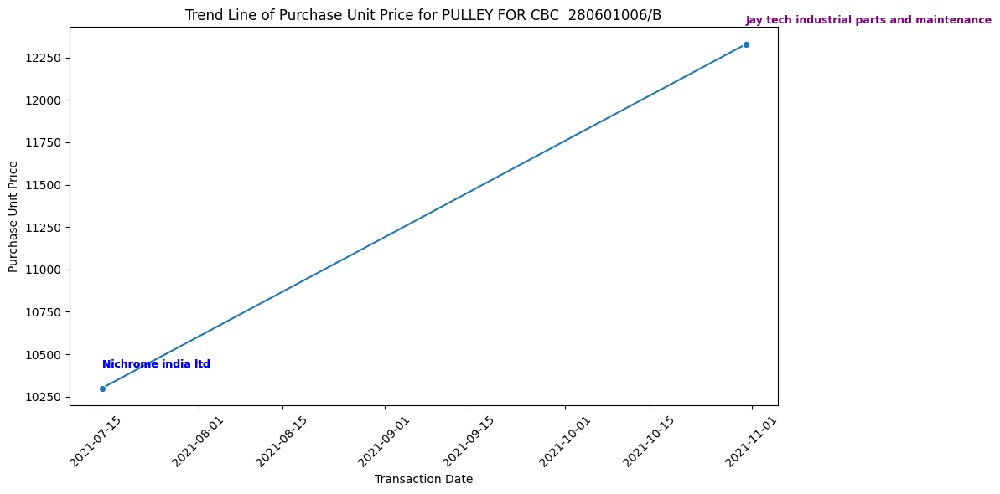

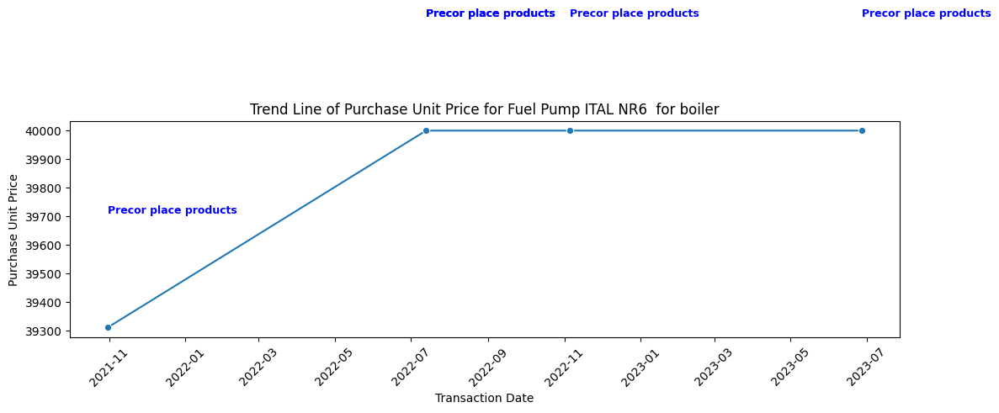

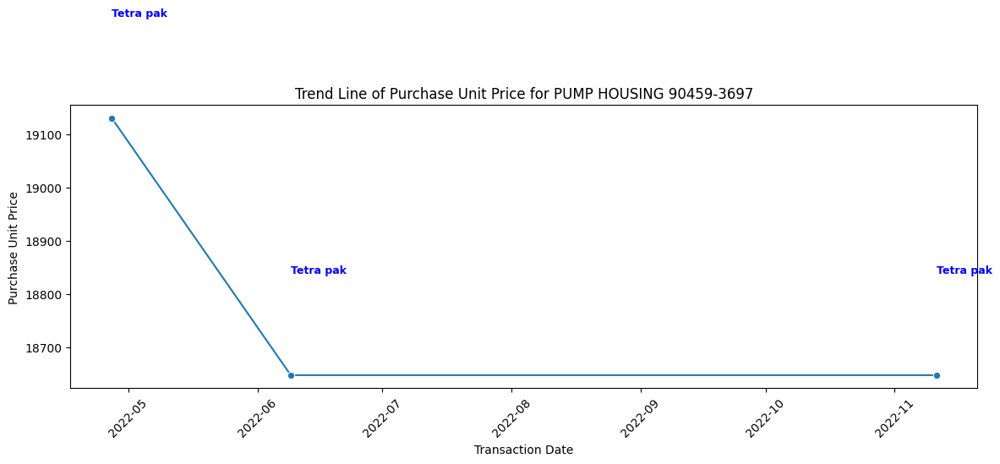

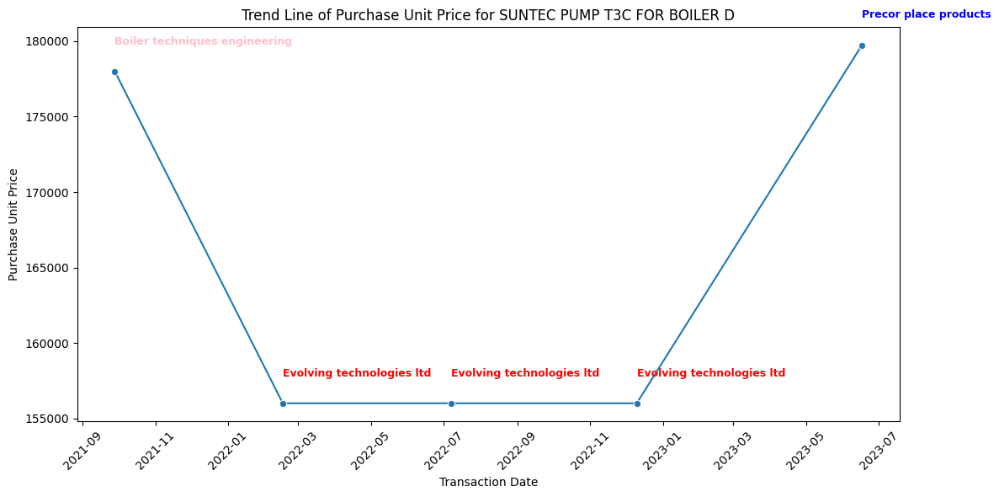

<ipython-input-17-de13d2447d94>:50: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


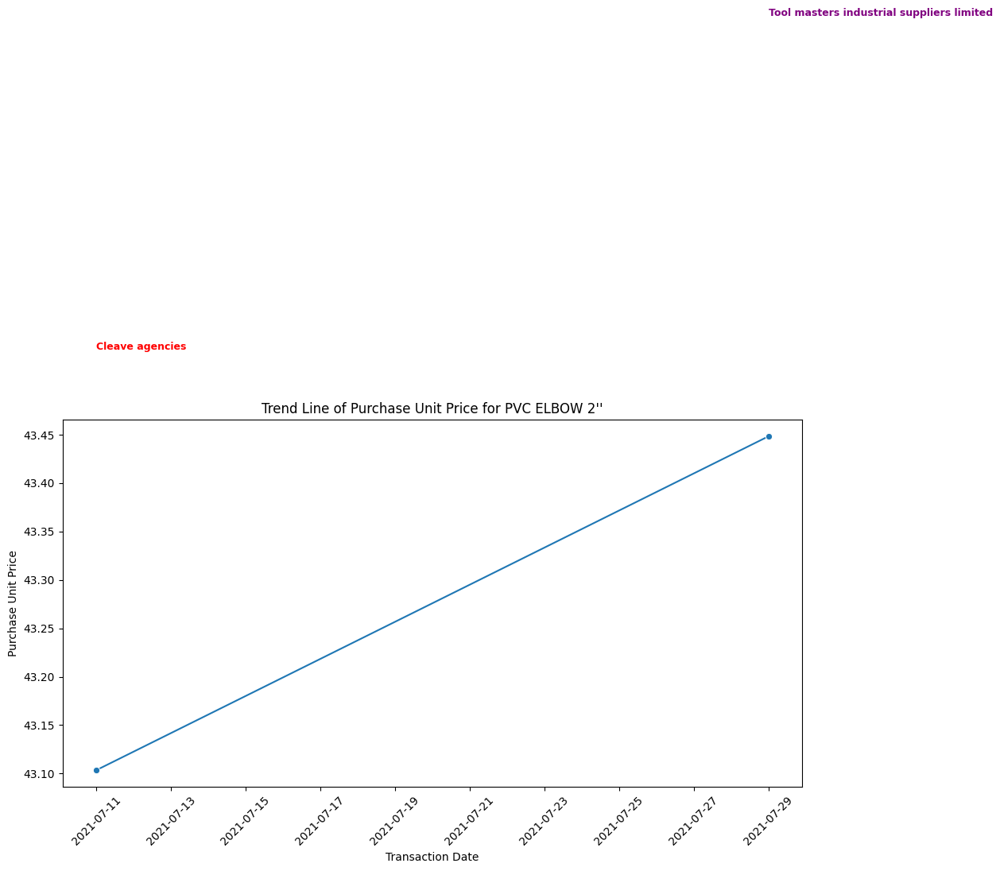

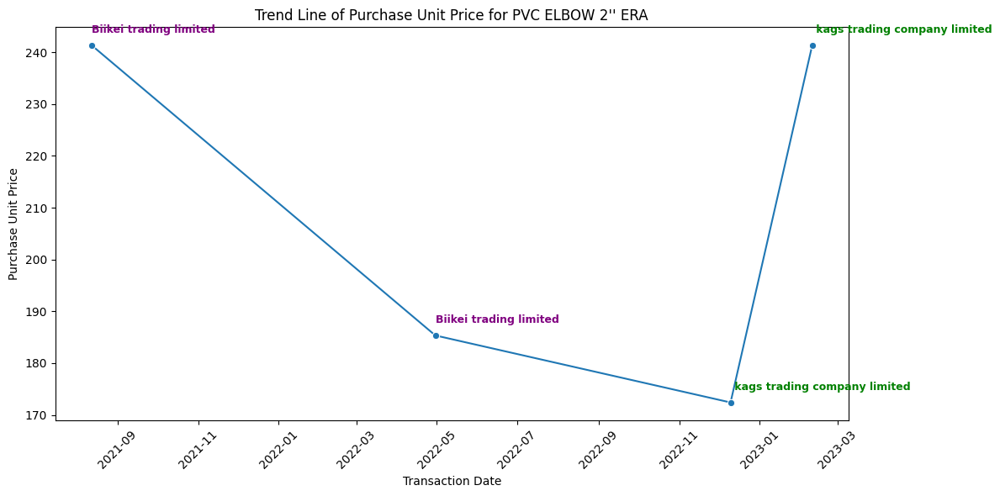

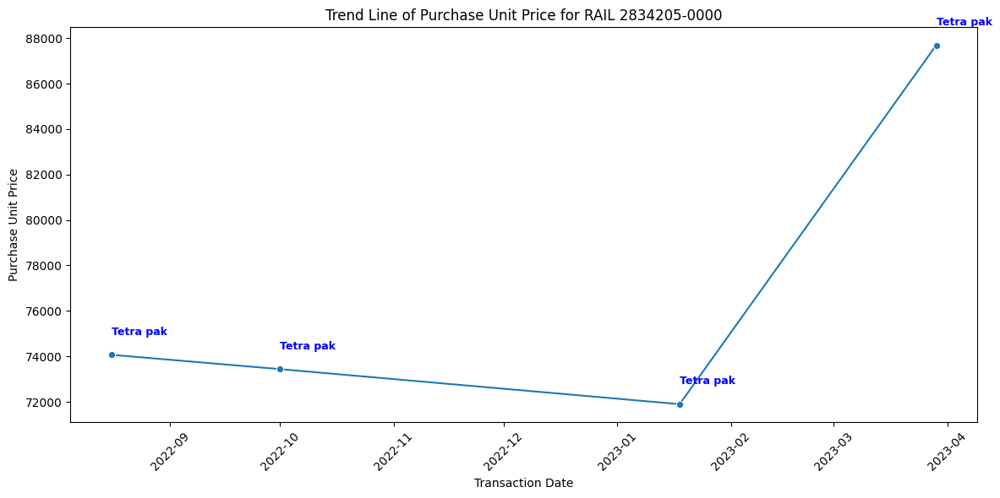

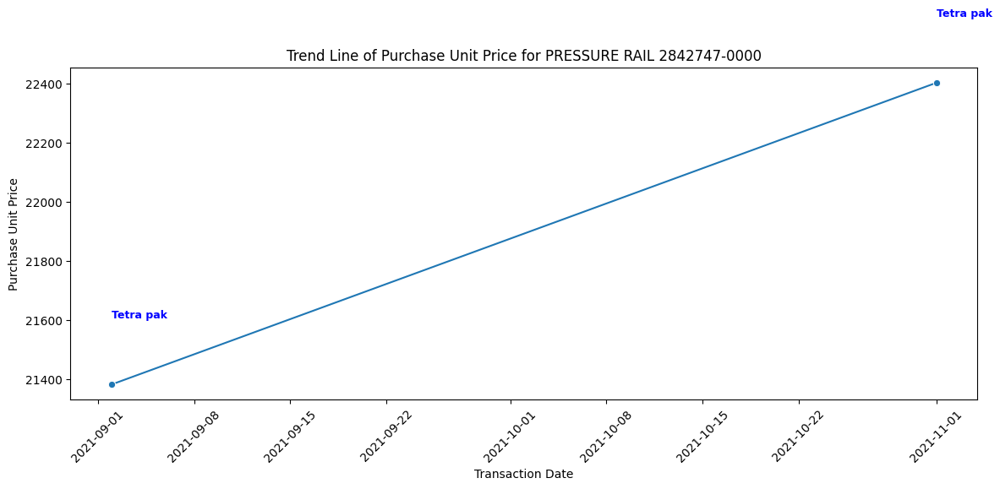

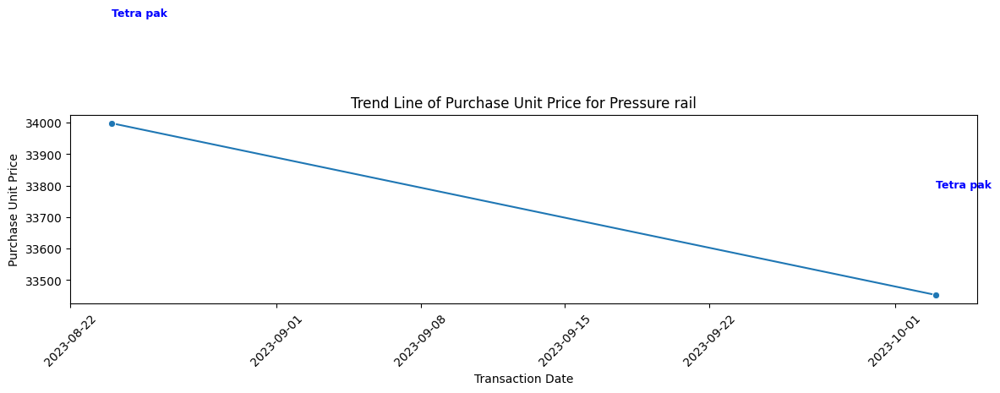

...

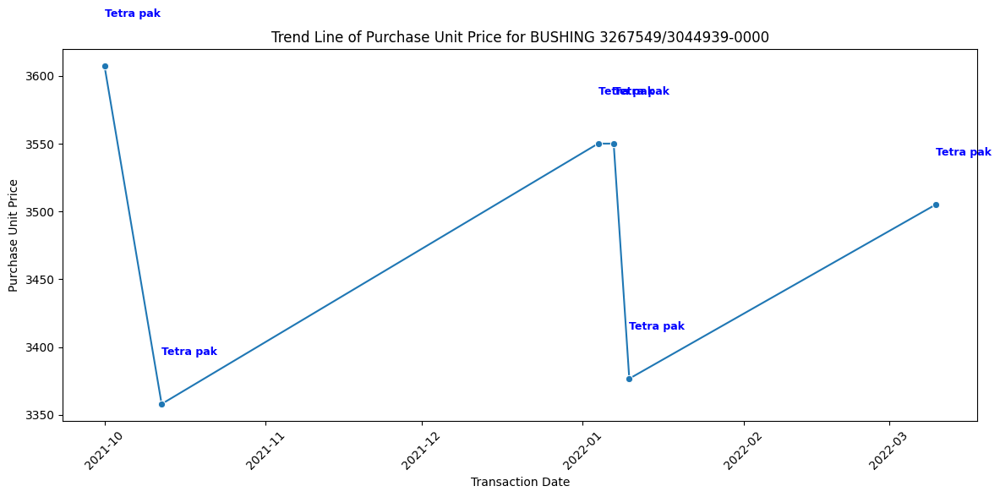

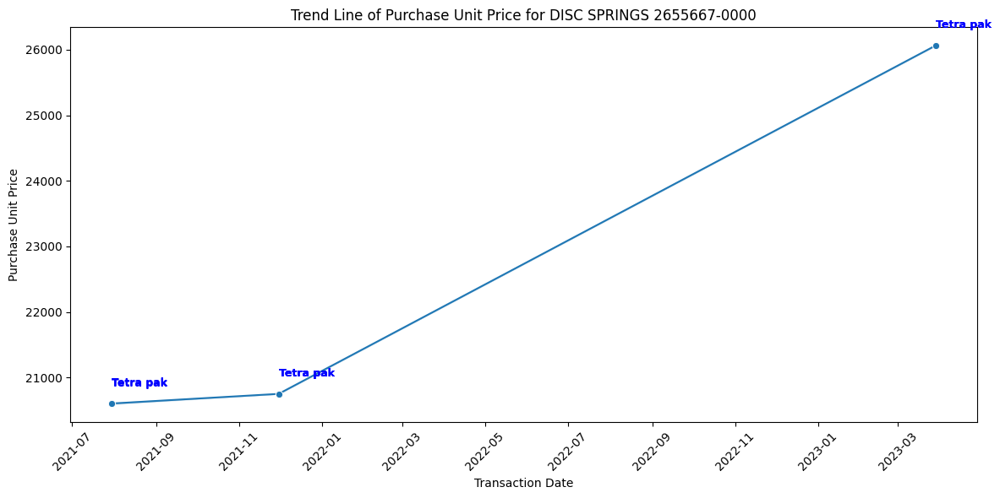

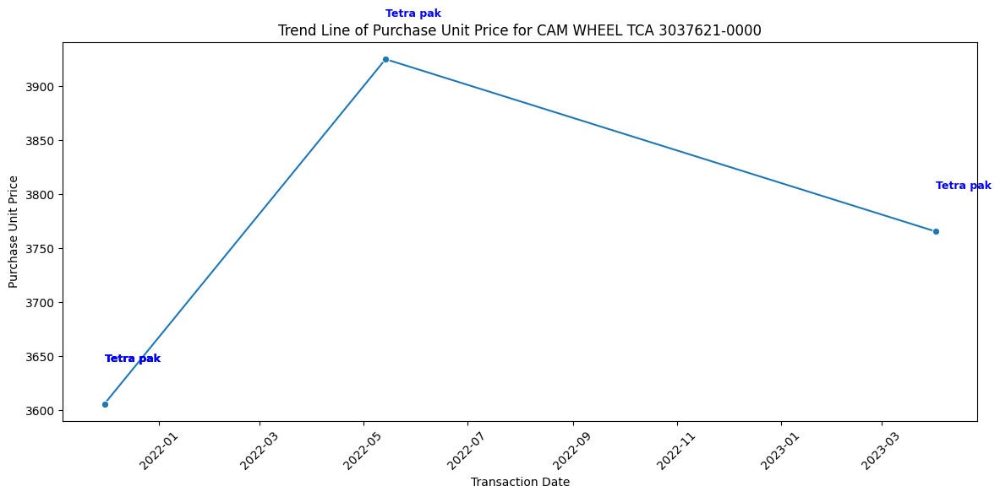

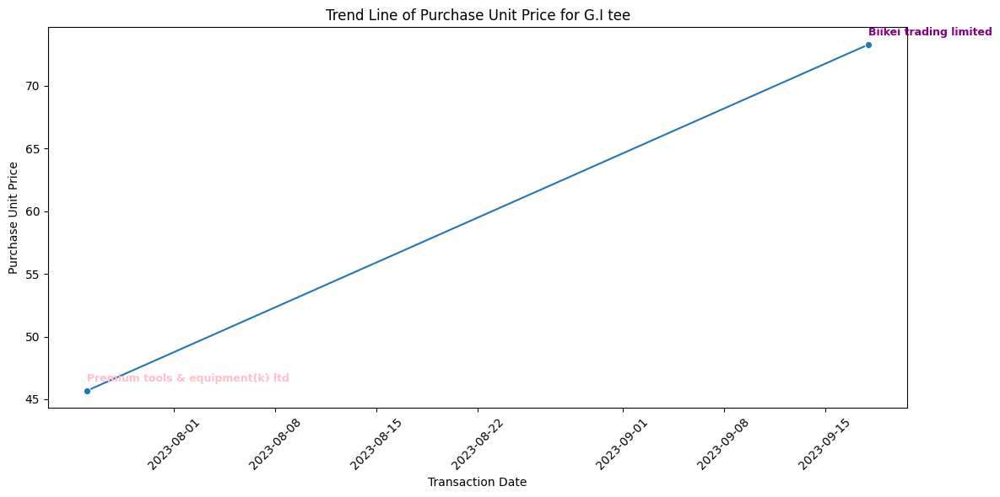

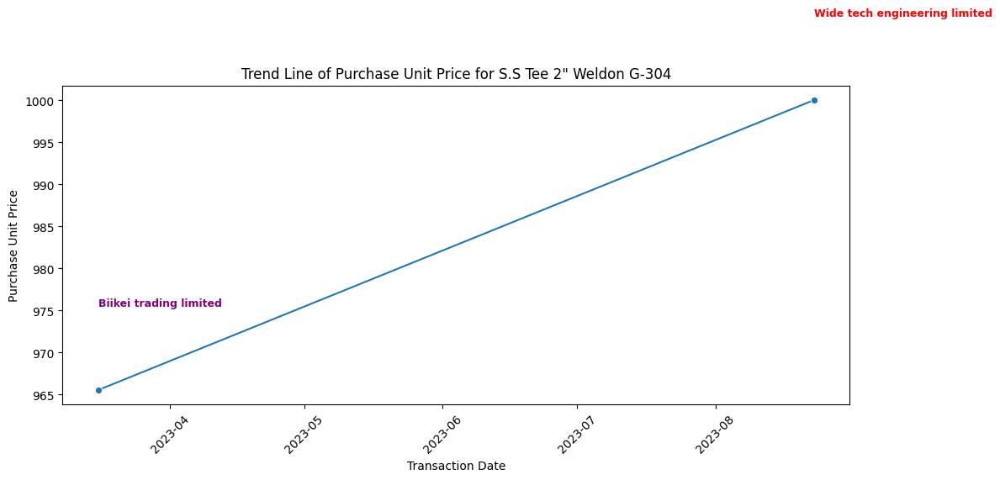

<ipython-input-17-de13d2447d94>:50: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


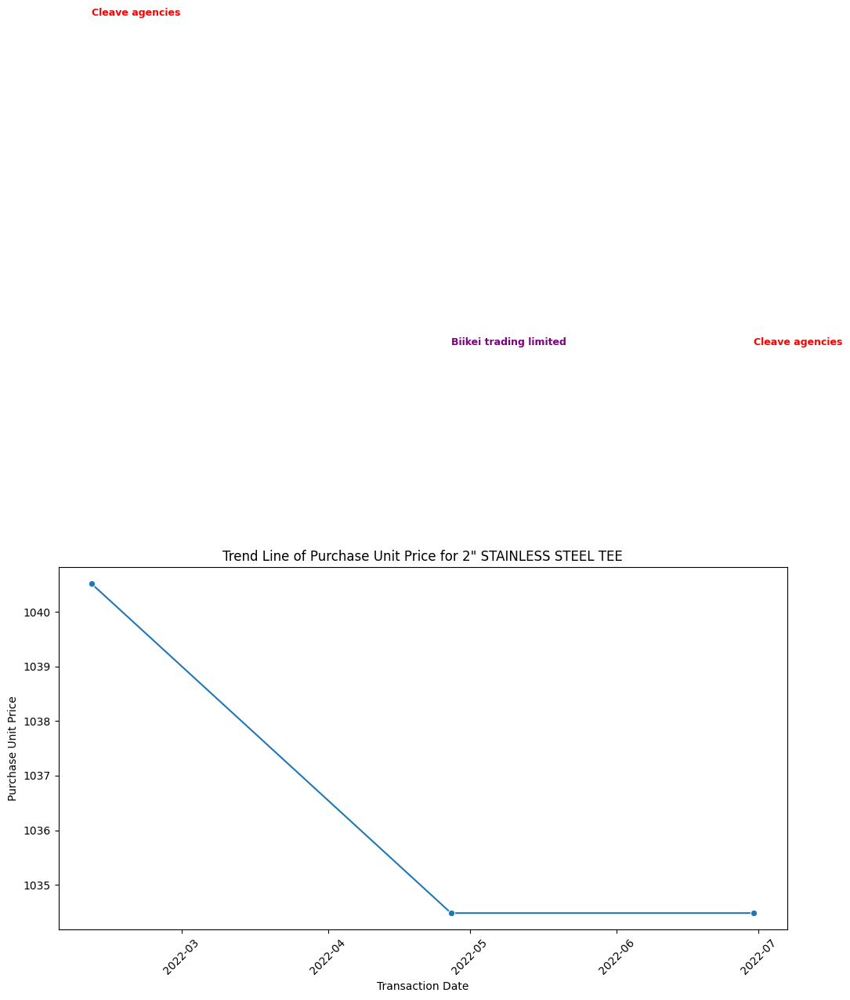

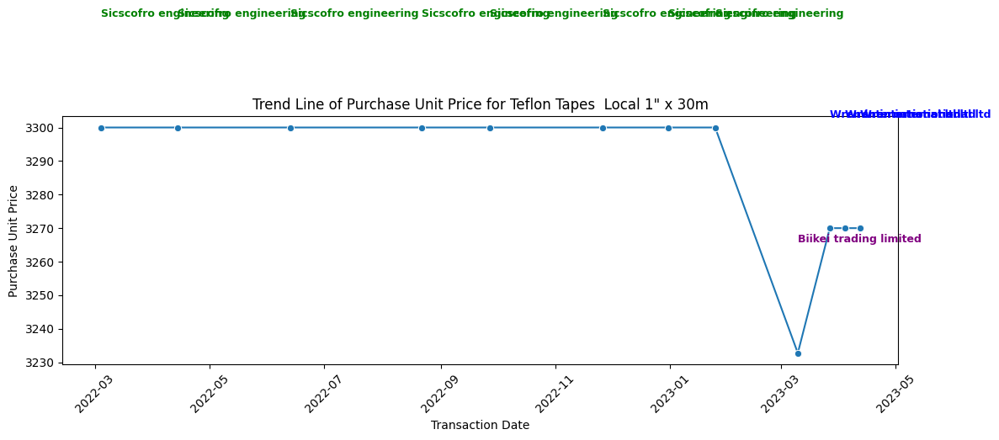

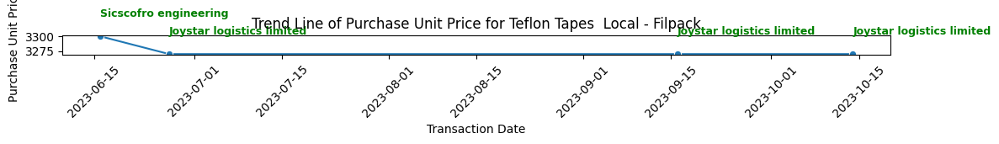

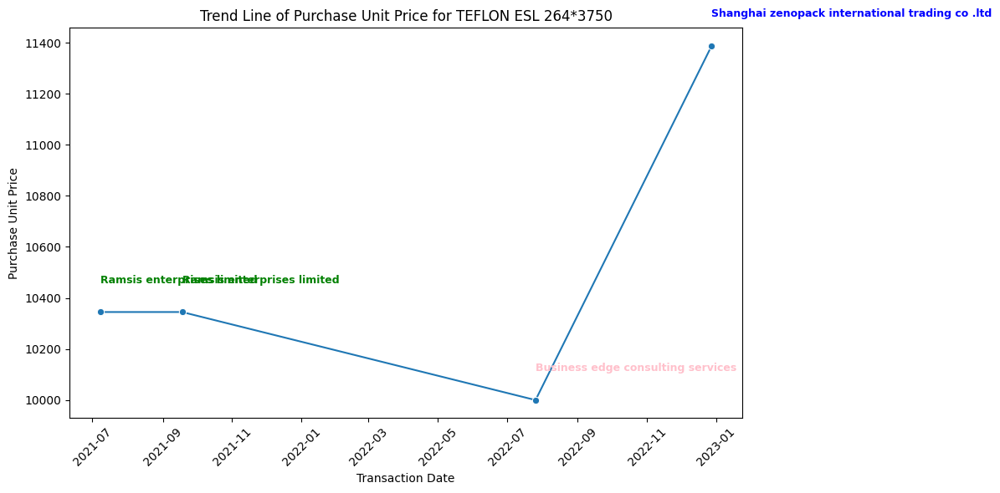

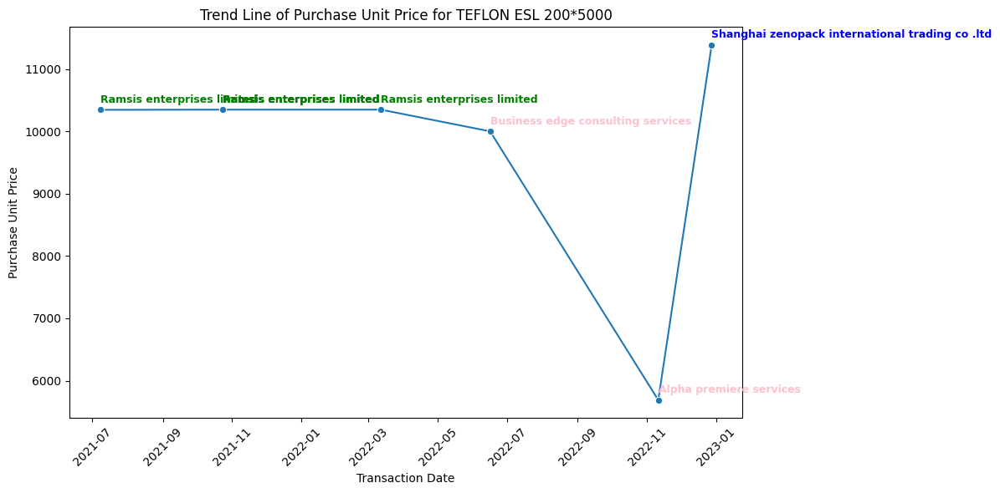

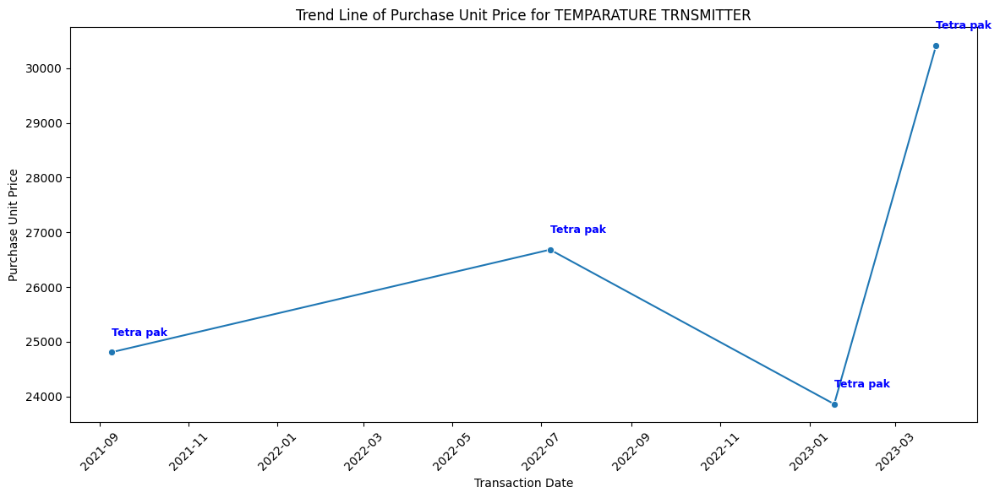

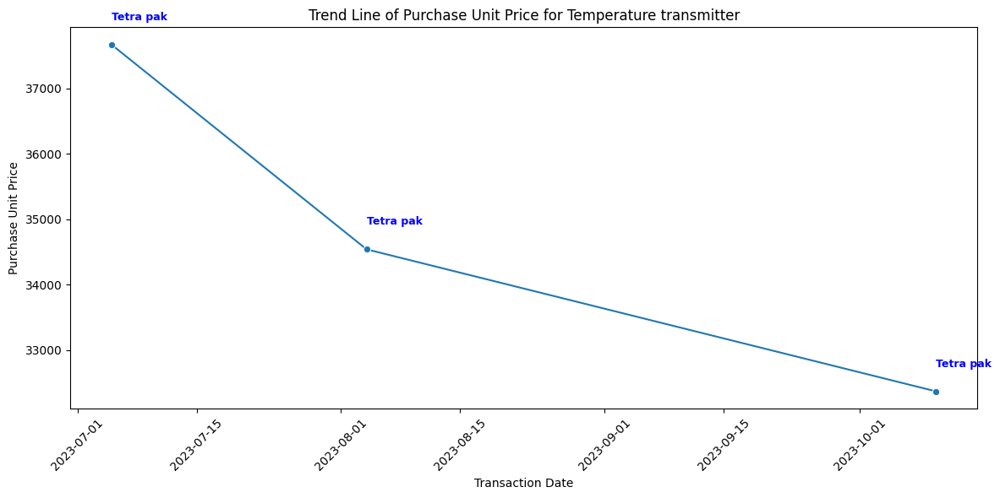

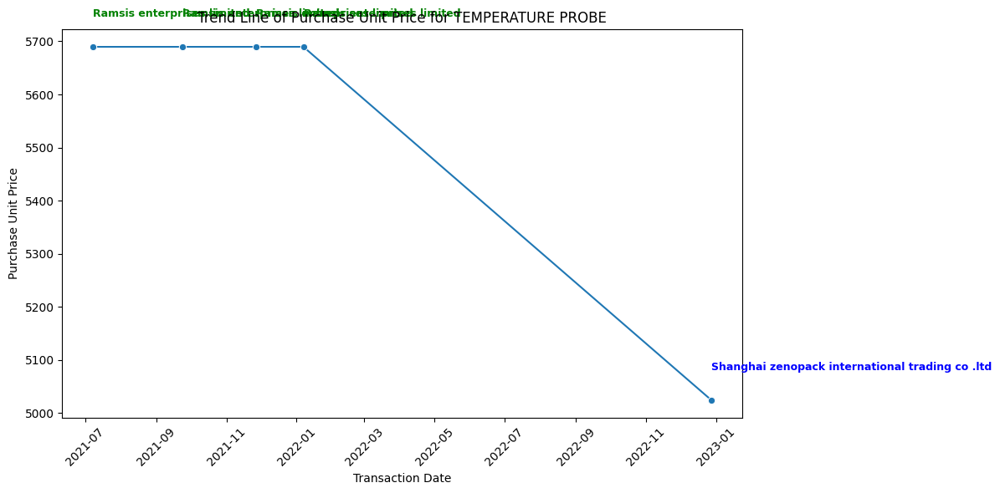

<ipython-input-17-de13d2447d94>:50: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


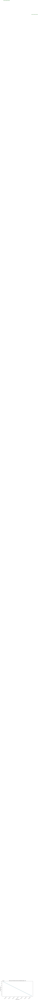

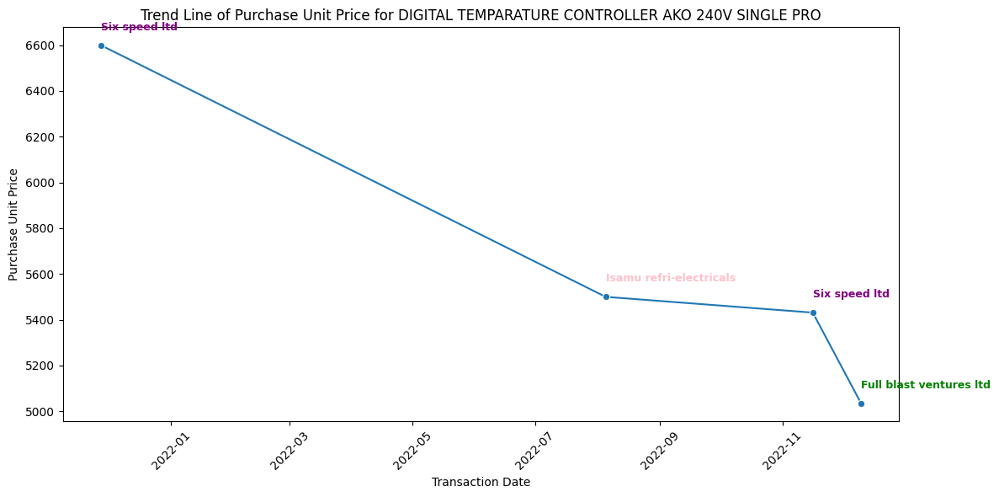

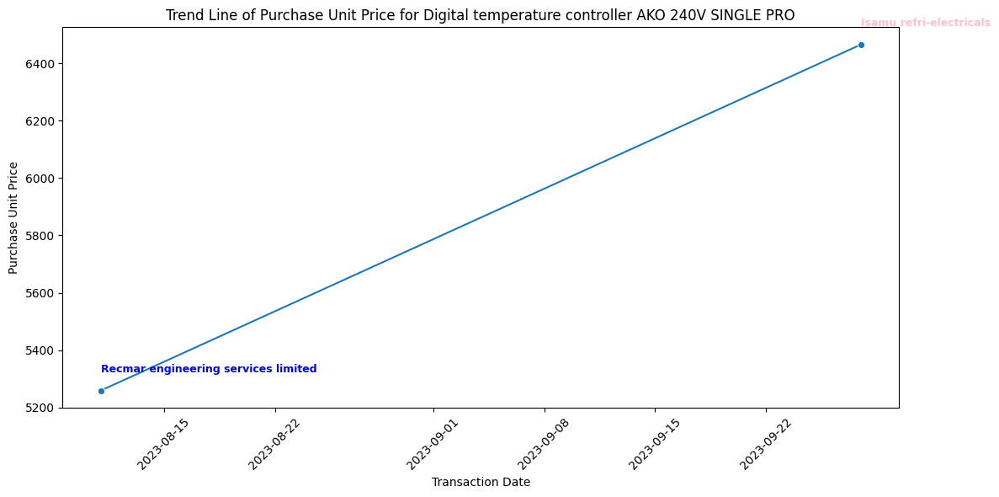

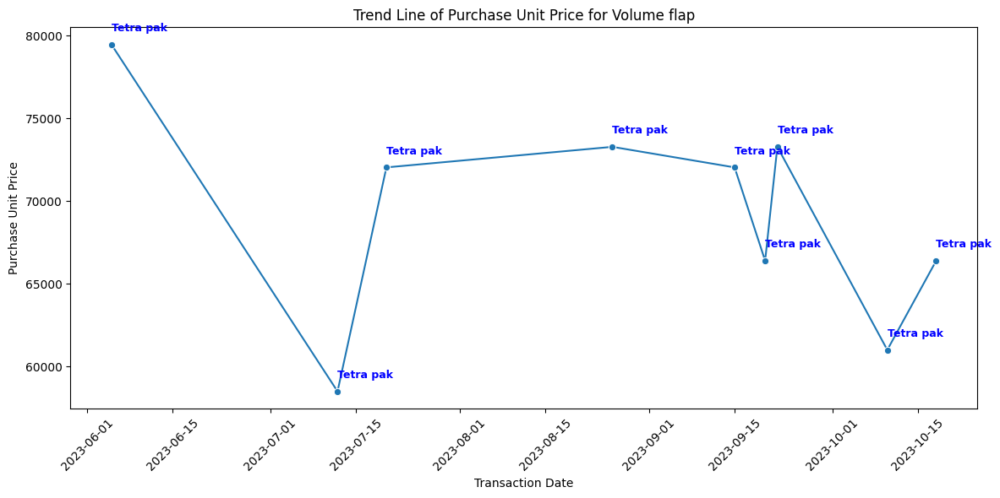

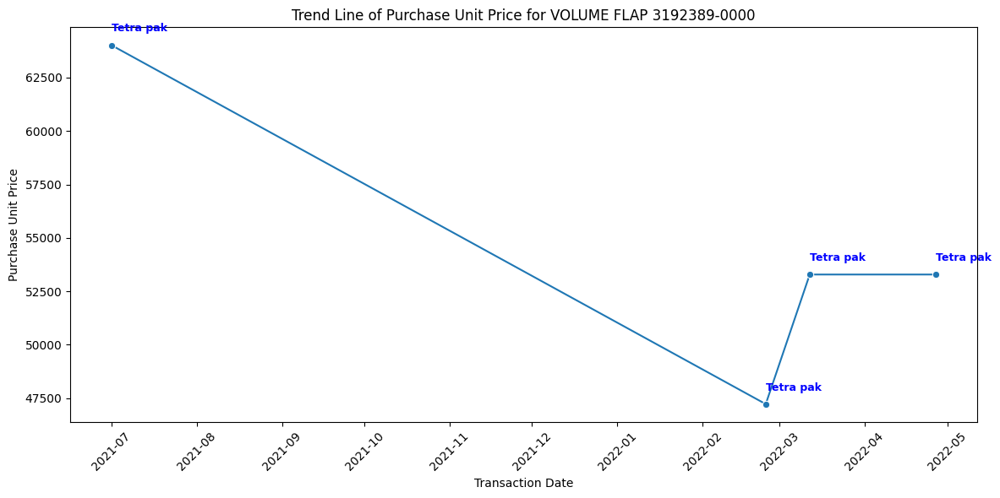

...

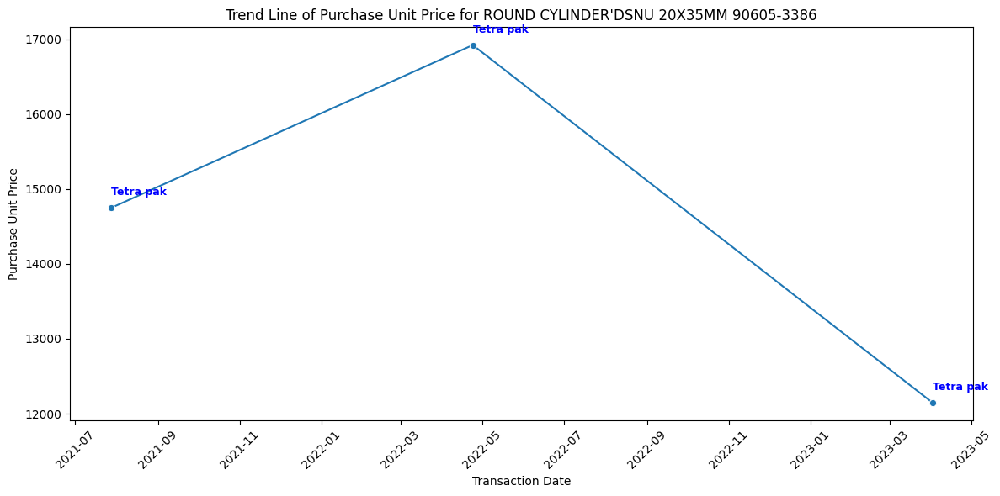

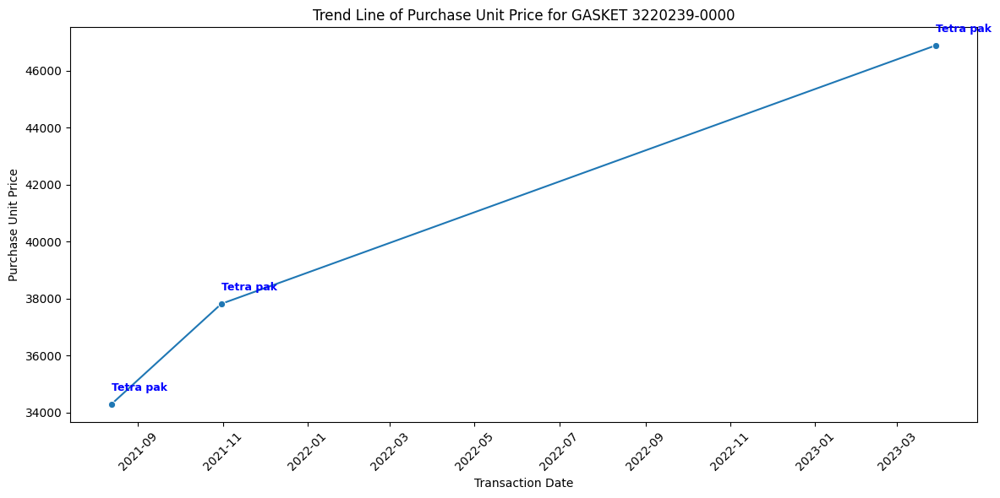

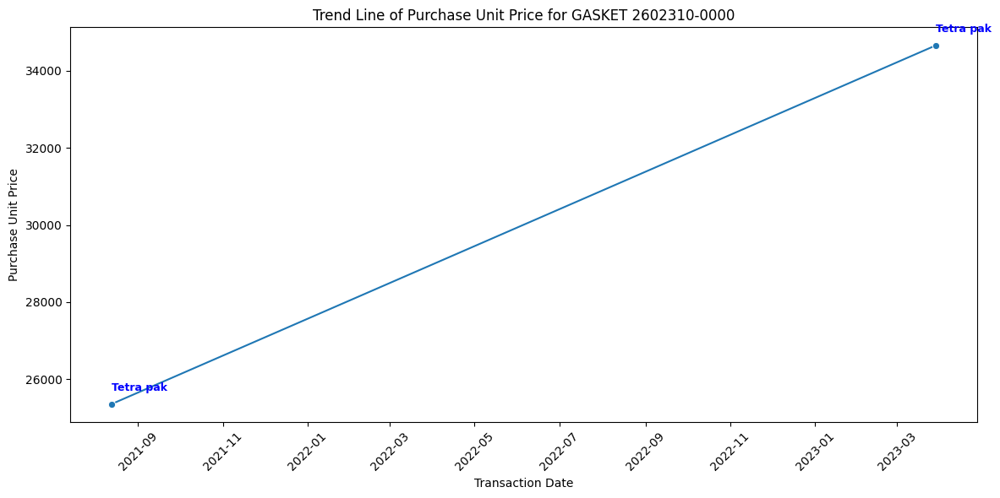

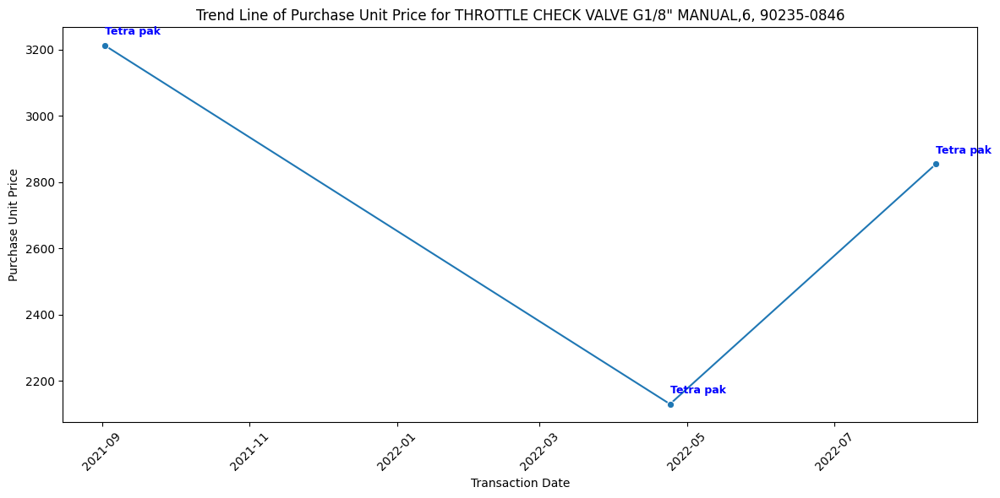

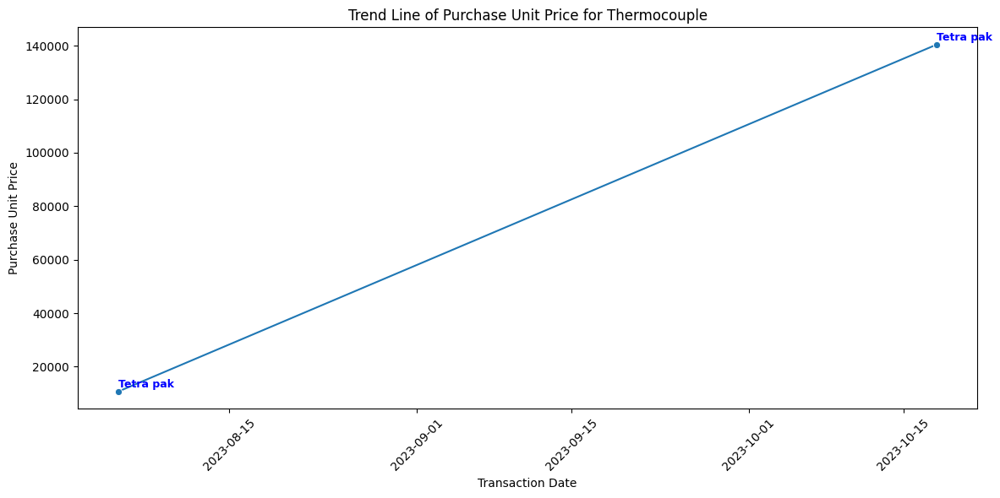

<ipython-input-17-de13d2447d94>:50: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


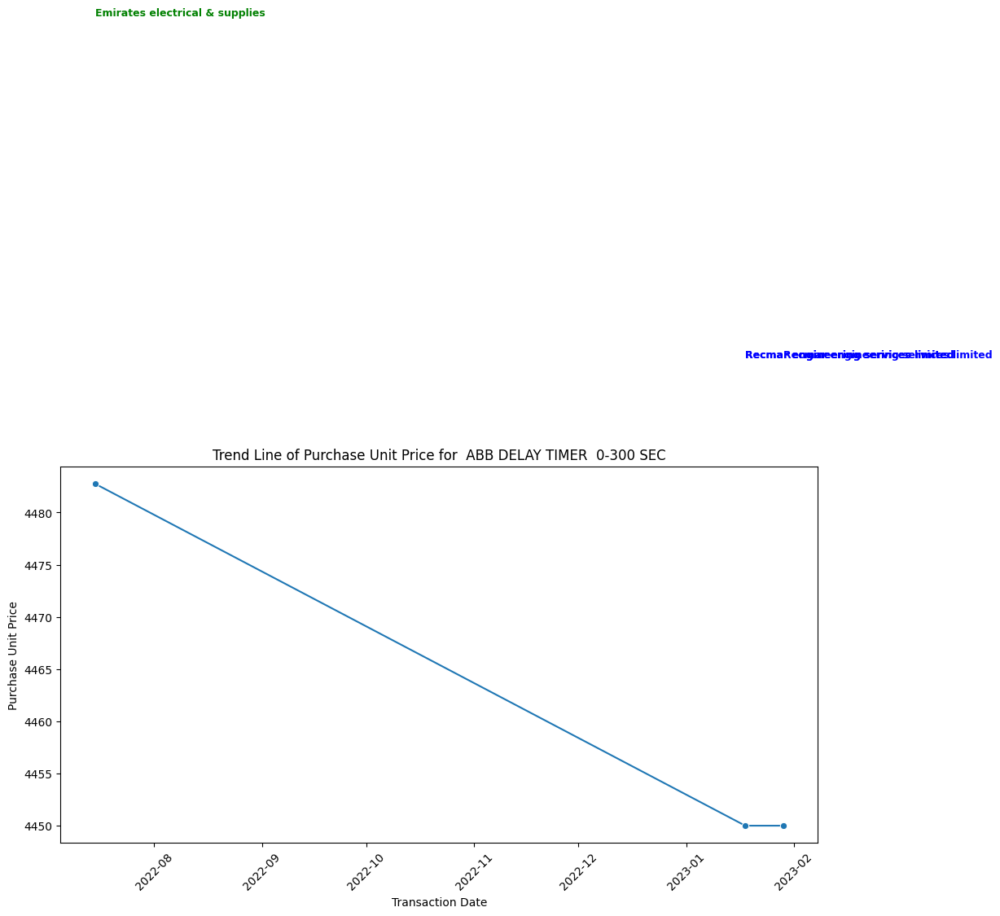

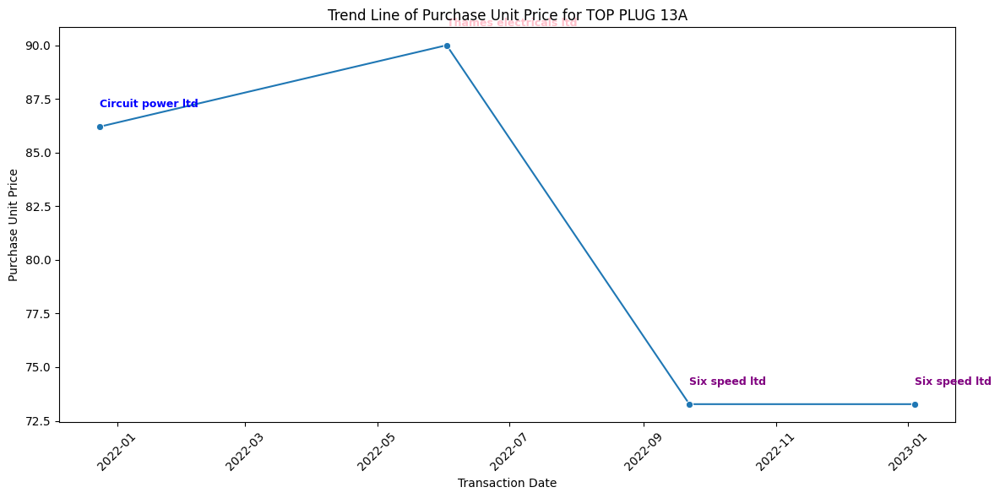

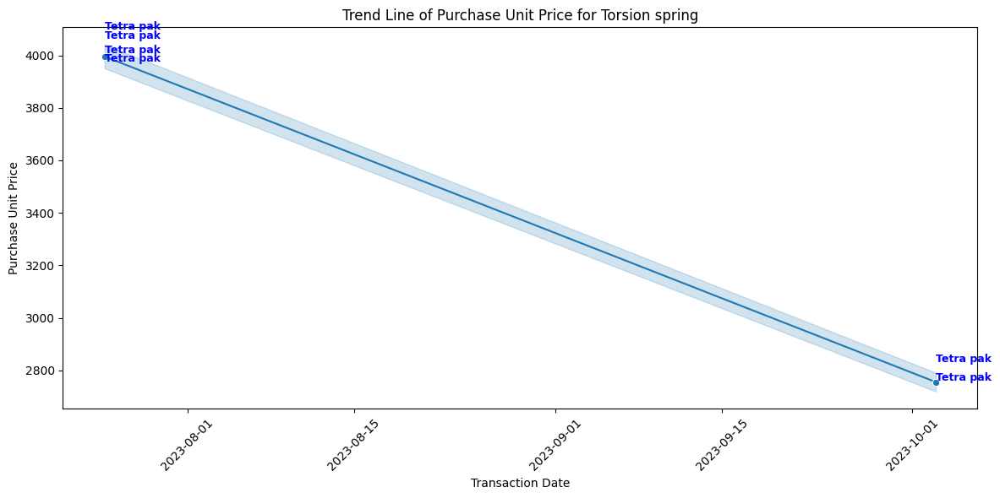

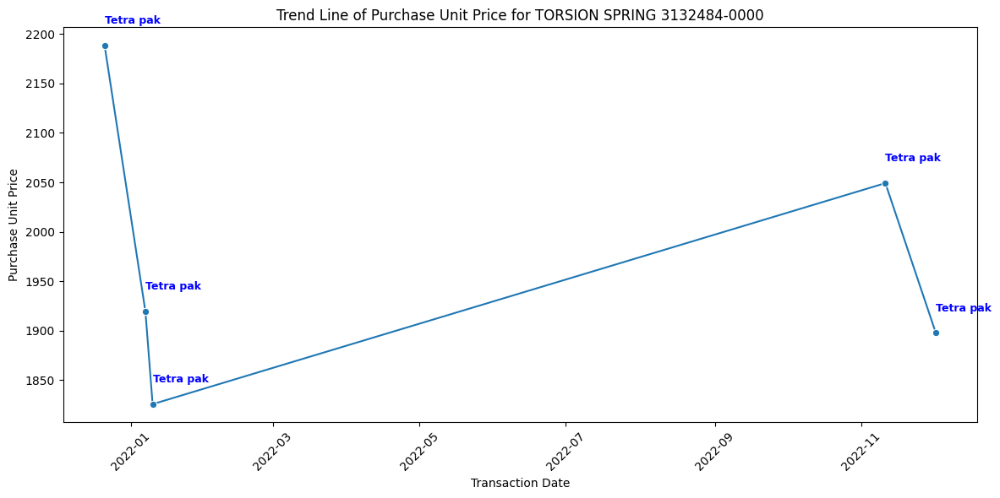

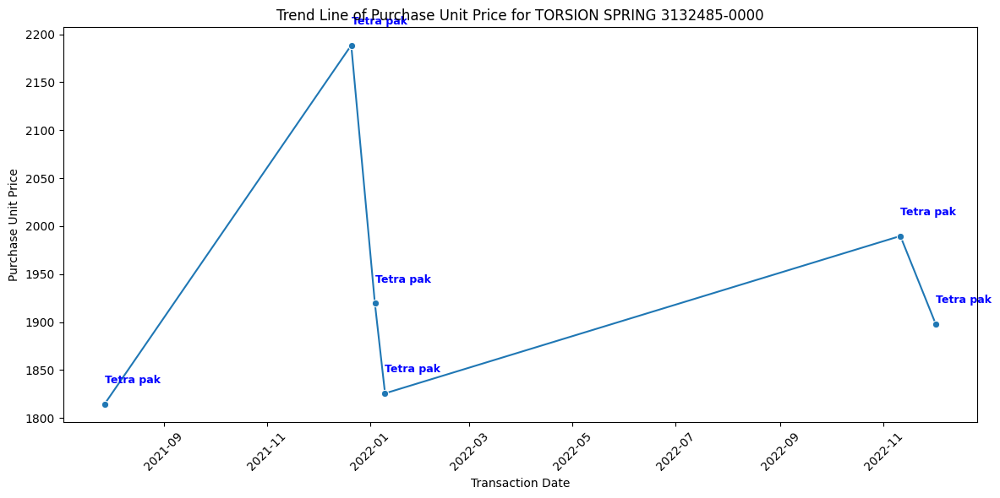

...

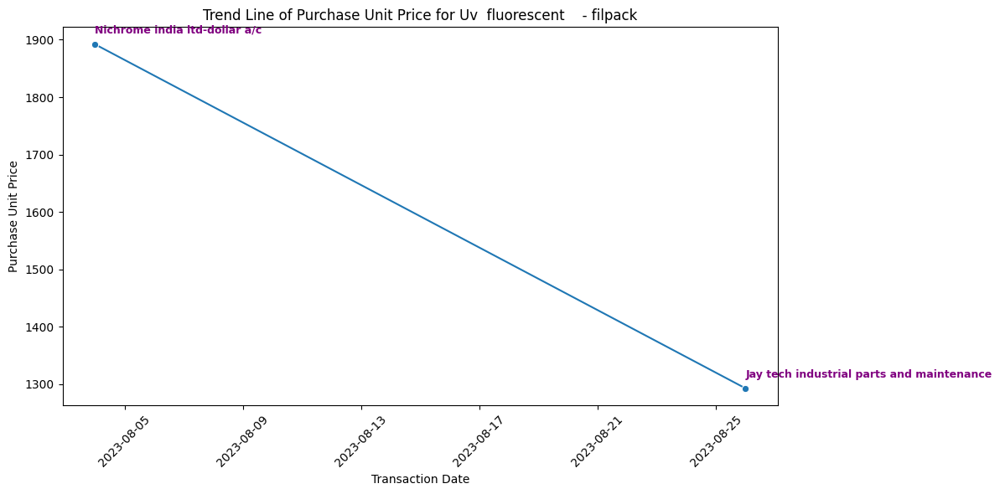

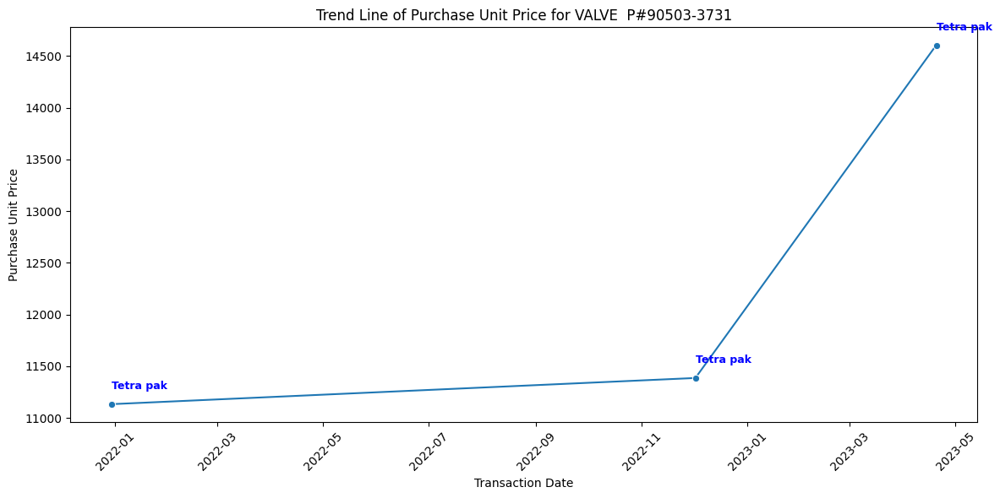

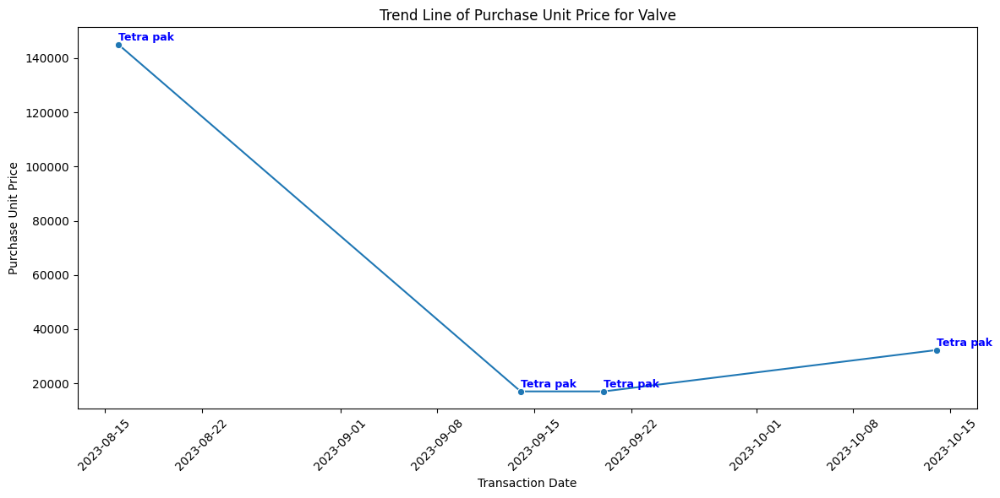

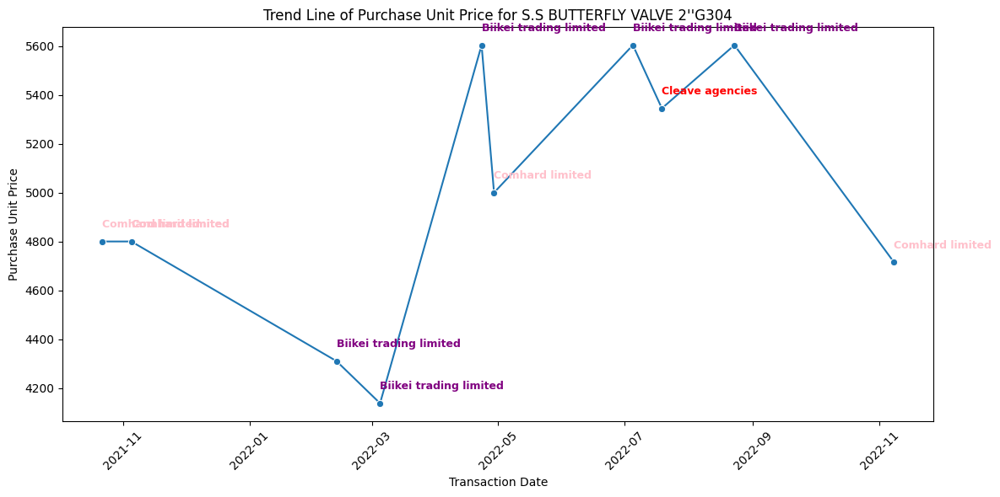

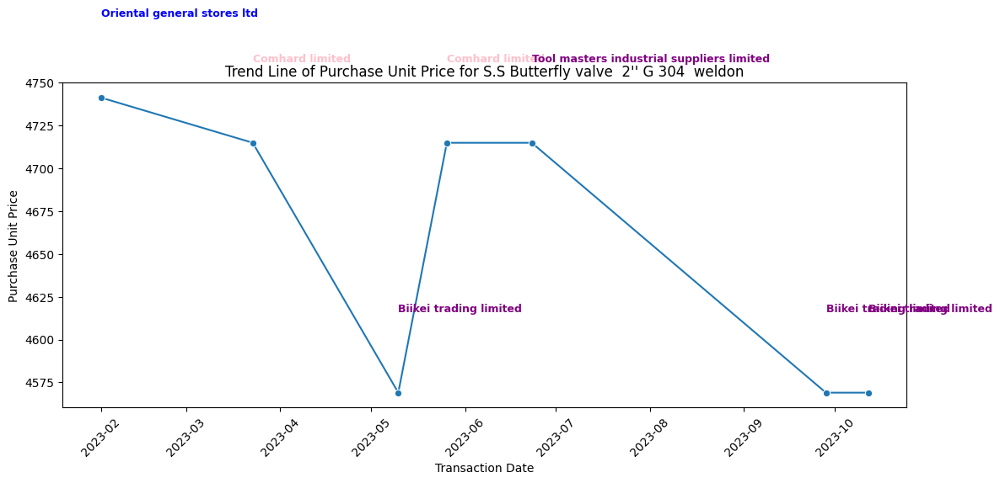

<ipython-input-17-de13d2447d94>:50: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


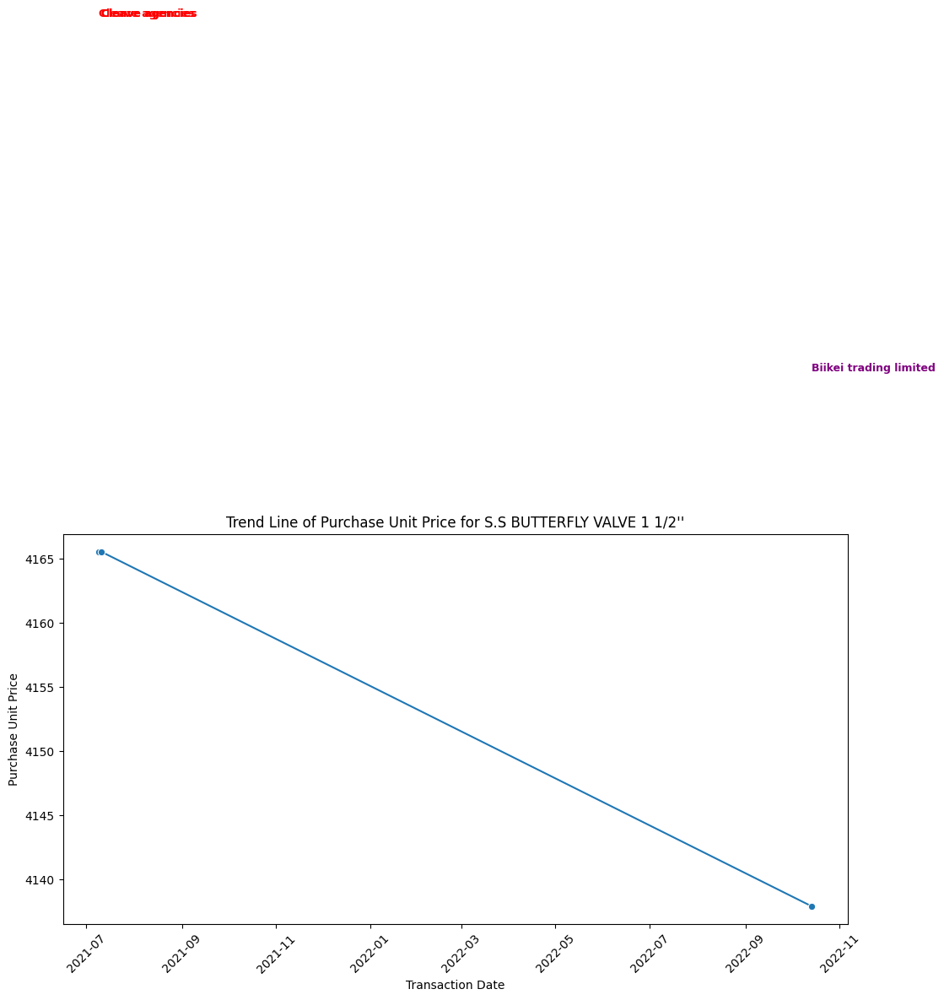

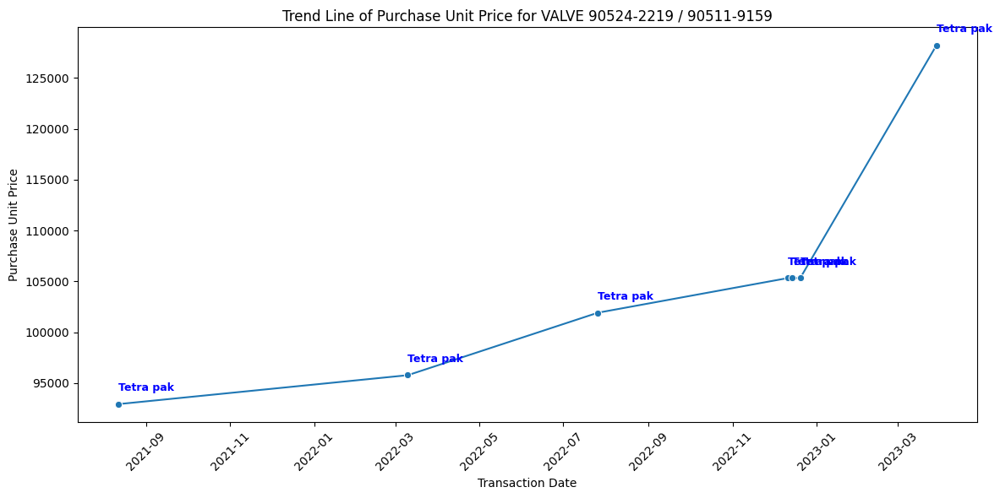

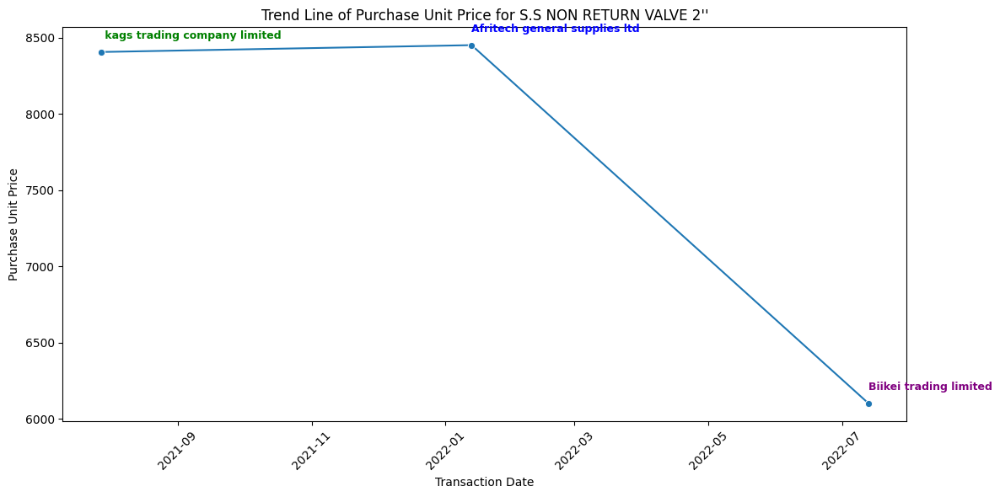

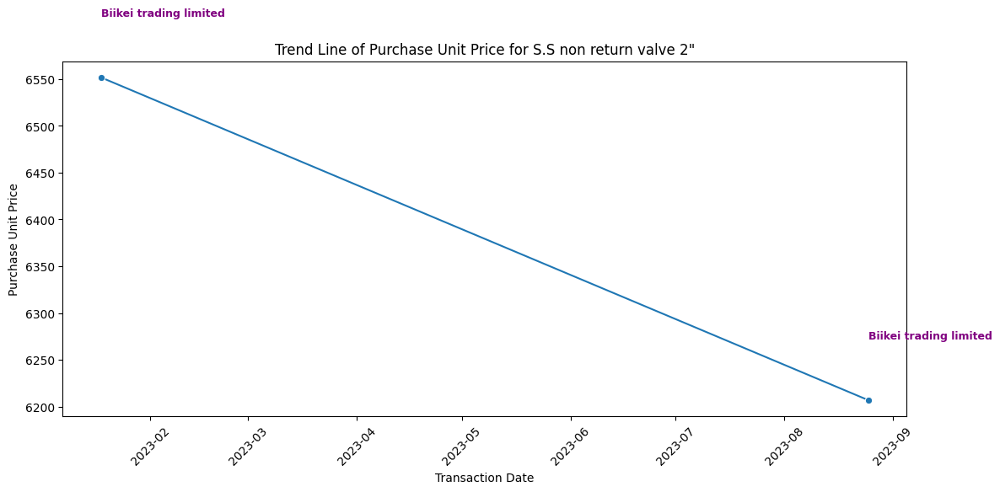

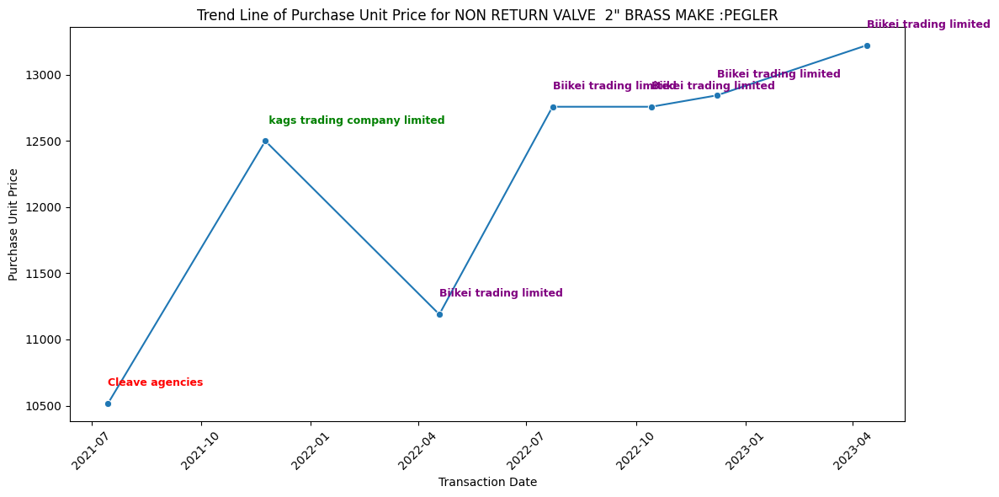

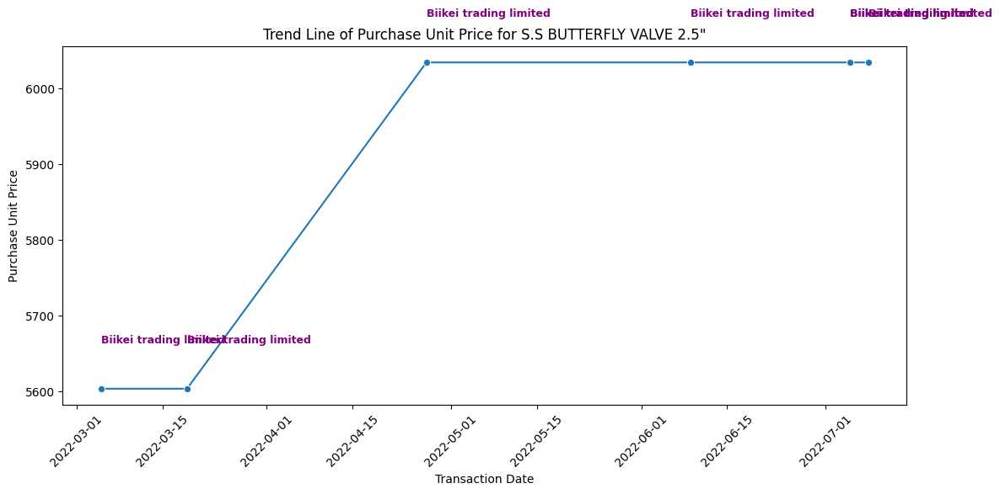

<ipython-input-17-de13d2447d94>:50: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


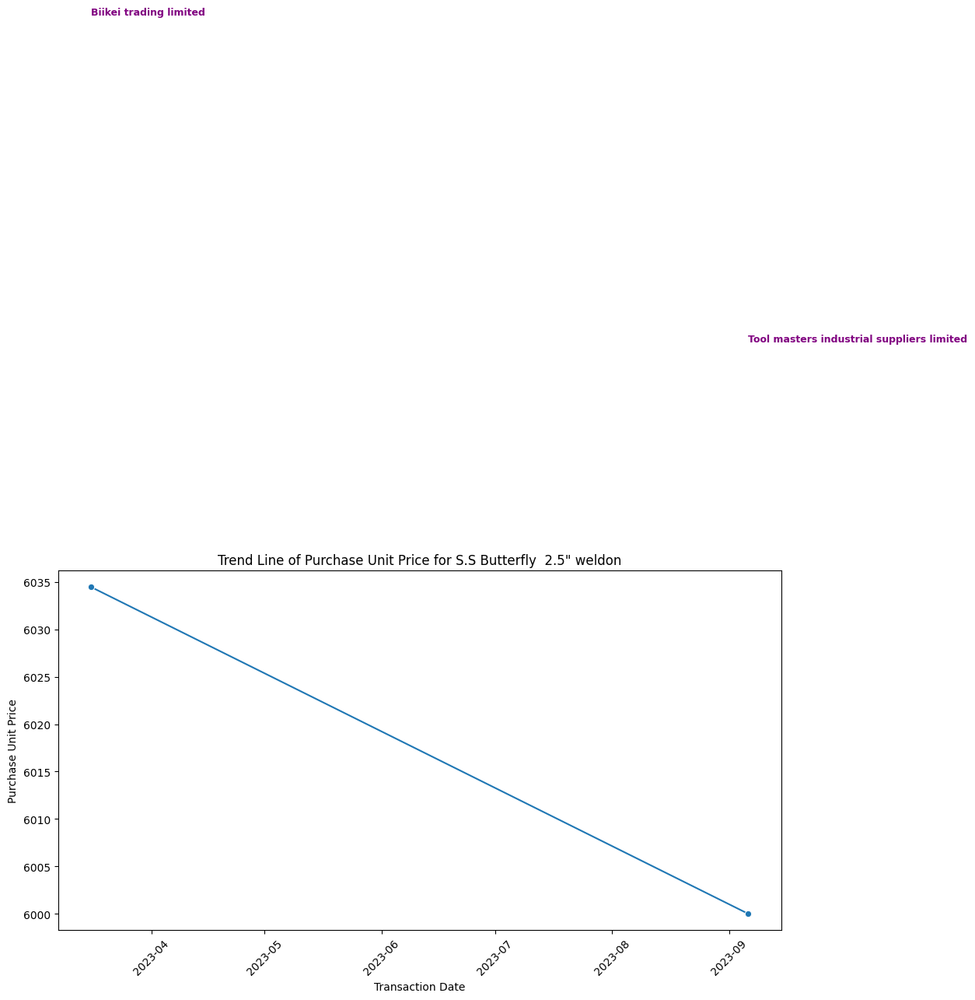

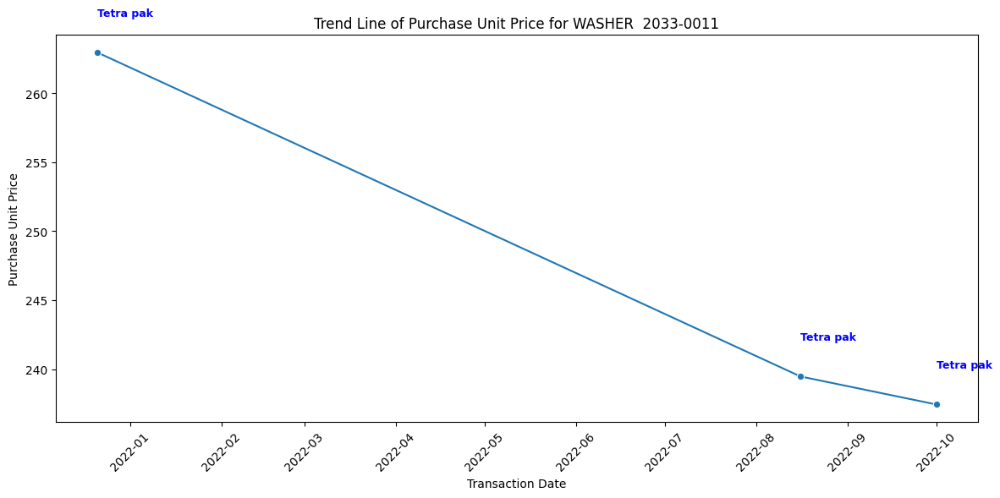

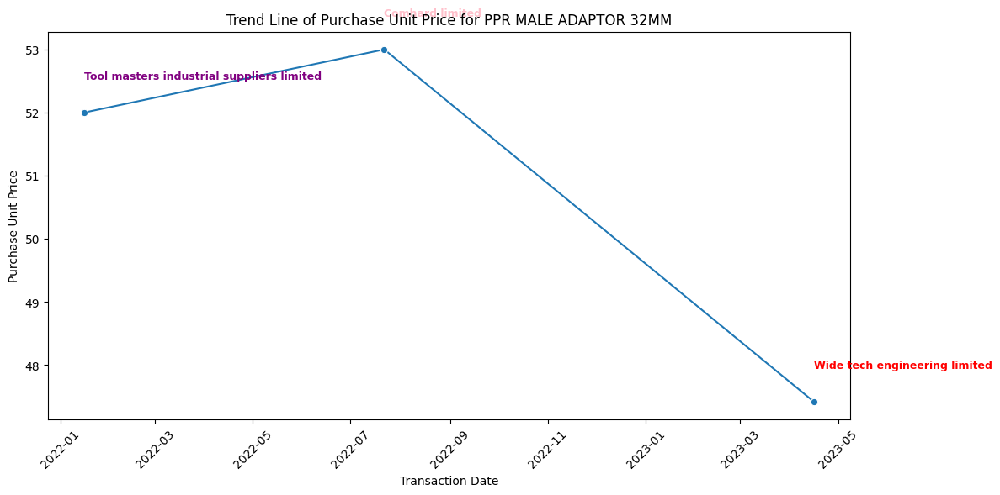

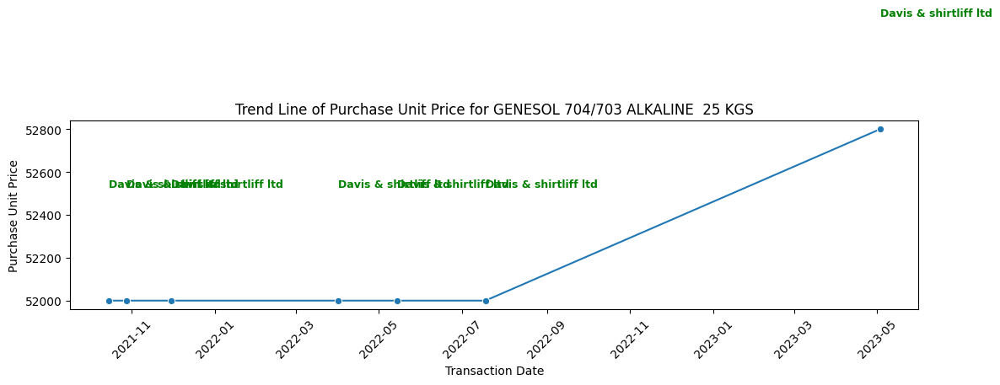

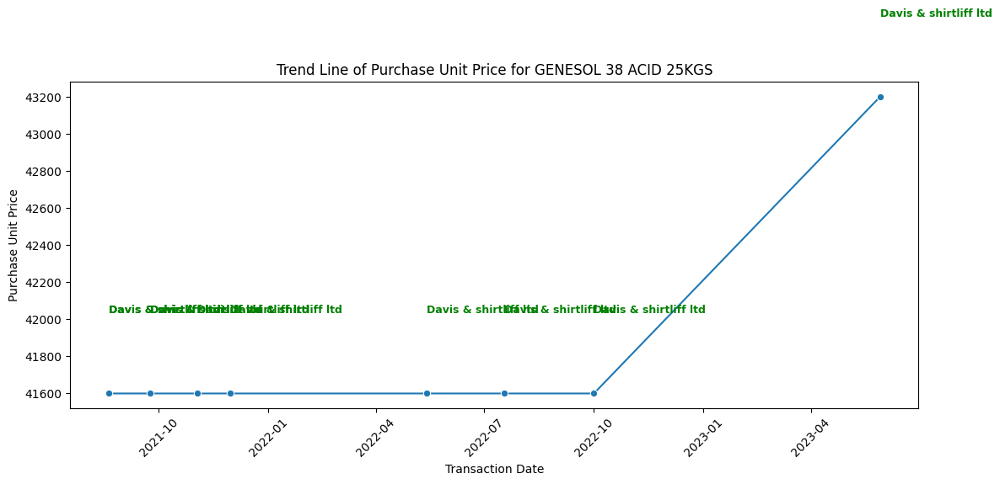

...

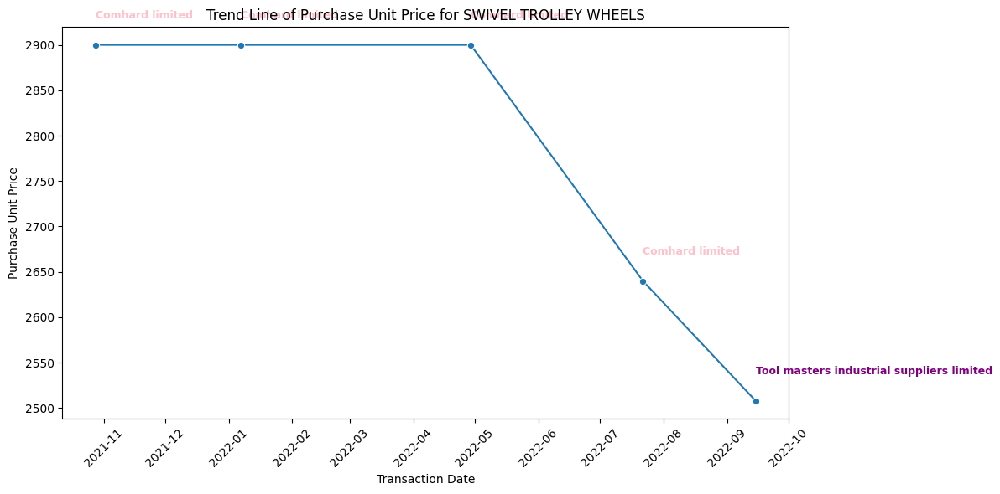

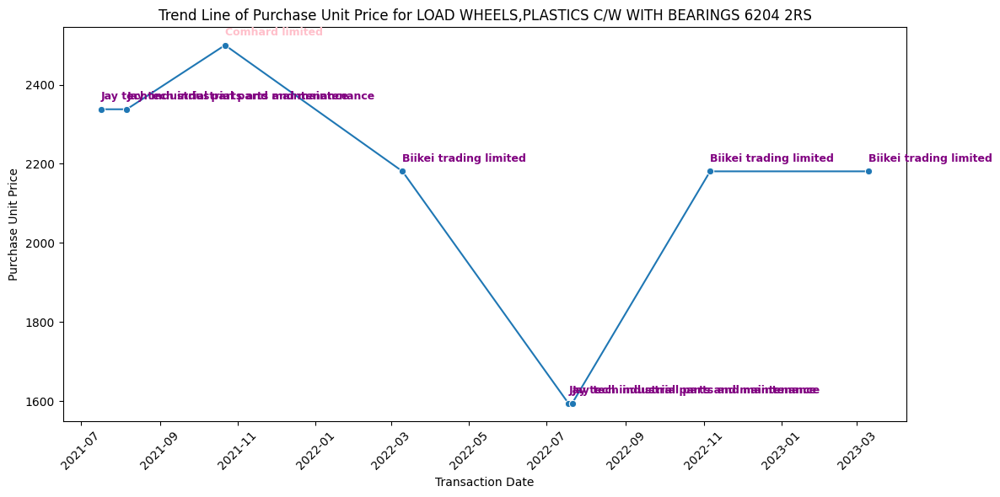

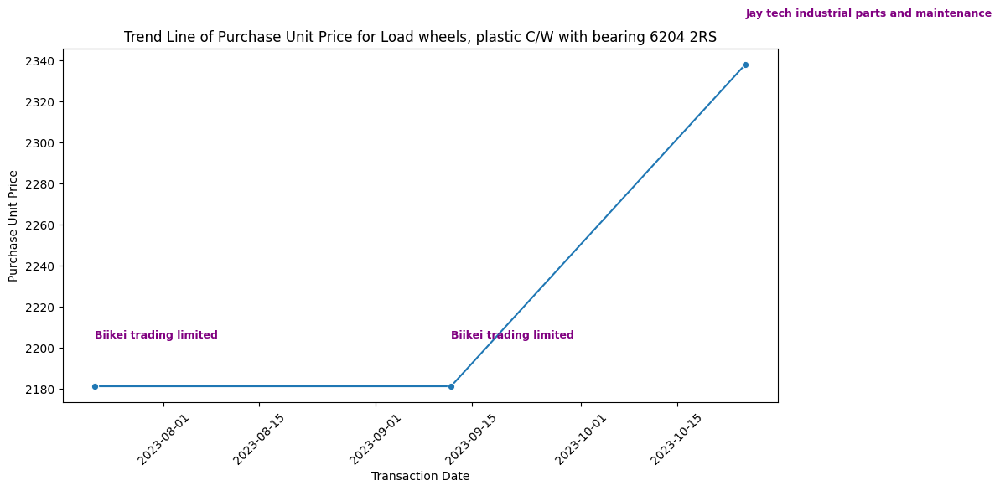

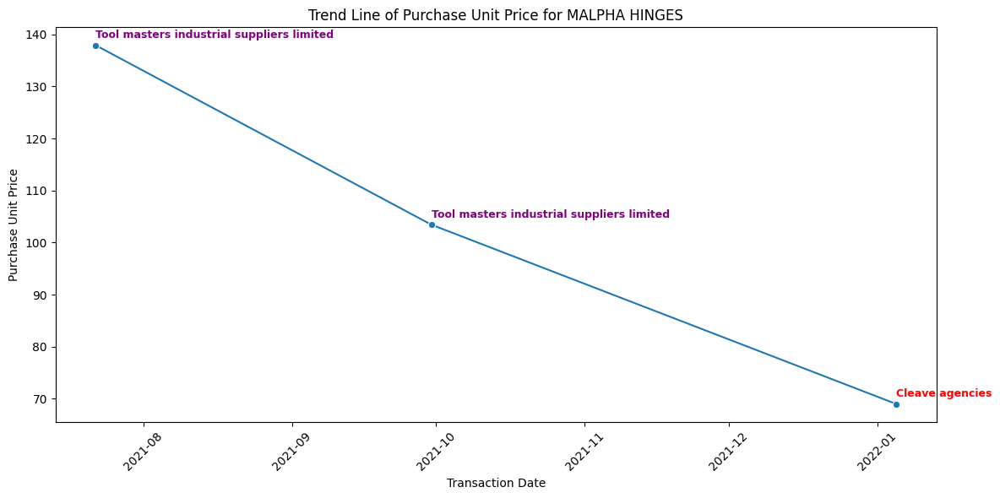

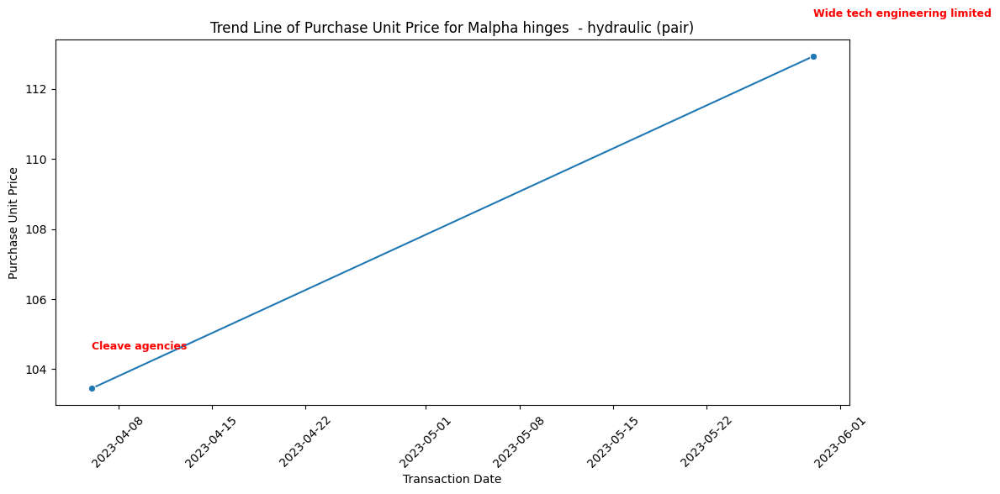

In [17]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Load the data
file_path = "/content/More than one description but shared code.xlsx"
df = pd.read_excel(file_path)

# Drop rows where 'Purchase_Unit_Price' is NaN
df = df.dropna(subset=['Purchase_Unit_Price'])

# Ensure column names match your DataFrame
stock_description_column = 'Stock _Description'  # Adjust if different in your DataFrame
purchase_unit_price_column = 'Purchase_Unit_Price'
supplier_name_column = 'Supplier_Name'
transaction_date_column = 'Transaction _Date'

# Filter out Stock_Codes with only one unique 'Purchase_Unit_Price'
Stock_Description_to_plot = df.groupby(stock_description_column).filter(lambda x: x[purchase_unit_price_column].nunique() > 1)[stock_description_column].unique()

# Generate a limited color palette for suppliers
unique_suppliers = df[supplier_name_column].dropna().unique()

# Define the colors: red, blue, green, pink, and purple
colors = ["red", "blue", "green", "pink", "purple"]

# Map each unique supplier to one of these colors
color_map = {supplier: colors[i % 5] for i, supplier in enumerate(unique_suppliers)}

# Function to display the plot for each stock description in the notebook
def display_plot_for_Stock_Description(Stock_Description, data):
    data_filtered = data[data[stock_description_column] == Stock_Description].sort_values(by=transaction_date_column)
    plt.figure(figsize=(12, 6))
    plot = sns.lineplot(x=transaction_date_column, y=purchase_unit_price_column, data=data_filtered, marker='o')
    for line in range(0, data_filtered.shape[0]):
        supplier_name = str(data_filtered[supplier_name_column].iloc[line]).capitalize()
        plot.text(data_filtered[transaction_date_column].iloc[line],
                  data_filtered[purchase_unit_price_column].iloc[line] + (data_filtered[purchase_unit_price_column].max() * 0.01),
                  supplier_name,
                  horizontalalignment='left',
                  size=9,
                  color=color_map.get(data_filtered[supplier_name_column].iloc[line], 'black'),
                  weight='bold'
                  )
    plt.title(f'Trend Line of Purchase Unit Price for {Stock_Description}')
    plt.xlabel('Transaction Date')
    plt.ylabel('Purchase Unit Price')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Display plots for all filtered stock descriptions in the notebook
for Stock_Description in Stock_Description_to_plot:
    display_plot_for_Stock_Description(Stock_Description, df)


In [21]:
# Install python-pptx
!pip install python-pptx

# Import necessary libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pptx import Presentation
from pptx.util import Inches, Pt
from pptx.enum.text import PP_ALIGN
import os

# Load the data
file_path = "/content/More than one description but shared code.xlsx"
df = pd.read_excel(file_path)

# Drop rows where 'Purchase_Unit_Price' is NaN
df = df.dropna(subset=['Purchase_Unit_Price'])

# Calculate the difference between the max and min prices for each stock description
df['Difference'] = df.groupby('Stock _Description')['Purchase_Unit_Price'].transform(lambda x: x.max() - x.min())

# Sort stock descriptions by the calculated difference
sorted_stock_descriptions = df.groupby('Stock _Description')['Difference'].max().sort_values(ascending=False).index.tolist()

# Filter sorted stock descriptions to only include those with more than one price
sorted_stock_descriptions_to_plot = [desc for desc in sorted_stock_descriptions if df[df['Stock _Description'] == desc]['Purchase_Unit_Price'].nunique() > 1]

# Function to sanitize file names
def sanitize_filename(filename):
    invalid_chars = ['<', '>', ':', '"', '/', '\\', '|', '?', '*']
    for char in invalid_chars:
        filename = filename.replace(char, '')
    return filename

# Function to save the plot as an image for each stock description
def save_plot_for_stock_description(stock_description, data):
    sanitized_name = sanitize_filename(stock_description)
    filename = f'plots/{sanitized_name}.png'
    data_filtered = data[data['Stock _Description'] == stock_description].sort_values(by='Transaction _Date')
    plt.figure(figsize=(6, 4.5))
    sns.lineplot(x='Transaction _Date', y='Purchase_Unit_Price', data=data_filtered, marker='o')
    for idx, row in data_filtered.iterrows():
        text_y_position = row['Purchase_Unit_Price'] + (data_filtered['Purchase_Unit_Price'].max() - data_filtered['Purchase_Unit_Price'].min()) * 0.02
        plt.text(row['Transaction _Date'], text_y_position, str(row['Supplier _Code ']).strip(),
                 color='red', fontweight='bold',
                 horizontalalignment='left', verticalalignment='bottom', fontsize=6)
    plt.title(f'Stock Description: {stock_description}')
    plt.xlabel('Transaction Date')
    plt.ylabel('Price')
    plt.xticks(rotation=45, fontsize=9)
    plt.tight_layout()
    plt.savefig(filename)
    plt.close()

# Create a directory to store the images
os.makedirs('plots', exist_ok=True)

# Save plots as images
for stock_description in sorted_stock_descriptions_to_plot:
    save_plot_for_stock_description(stock_description, df)

# Create a new PowerPoint presentation
prs = Presentation()

# Add images to the presentation
for stock_description in sorted_stock_descriptions_to_plot:
    slide = prs.slides.add_slide(prs.slide_layouts[5])  # Using a blank slide layout
    title = slide.shapes.title
    title.text = f"Stock Description: {stock_description}"
    sanitized_name = sanitize_filename(stock_description)
    filename = f'plots/{sanitized_name}.png'
    if os.path.exists(filename):
        left = Inches(1)
        top = Inches(1.5)
        pic = slide.shapes.add_picture(filename, left, top, width=Inches(8))

# Save the PowerPoint file
pptx_path = '/content/stock_description_presentation.pptx'
prs.save(pptx_path)
print(f"Presentation saved to {pptx_path}")


Presentation saved to /content/stock_description_presentation.pptx


In [22]:
# Install python-pptx
!pip install python-pptx

# Import necessary libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pptx import Presentation
from pptx.util import Inches, Pt
from pptx.enum.text import PP_ALIGN
import os

# Load the data
file_path = "/content/More than one description but shared code.xlsx"
df = pd.read_excel(file_path)

# Drop rows where 'Purchase_Unit_Price' is NaN
df = df.dropna(subset=['Purchase_Unit_Price'])

# Calculate the difference between the max and min prices for each stock description
df['Difference'] = df.groupby('Stock _Description')['Purchase_Unit_Price'].transform(lambda x: x.max() - x.min())

# Sort stock descriptions by the calculated difference
sorted_stock_descriptions = df.groupby('Stock _Description')['Difference'].max().sort_values(ascending=False).index.tolist()

# Filter sorted stock descriptions to only include those with more than one price
sorted_stock_descriptions_to_plot = [desc for desc in sorted_stock_descriptions if df[df['Stock _Description'] == desc]['Purchase_Unit_Price'].nunique() > 1]

# Function to sanitize file names
def sanitize_filename(filename):
    invalid_chars = ['<', '>', ':', '"', '/', '\\', '|', '?', '*']
    for char in invalid_chars:
        filename = filename.replace(char, '')
    return filename.lower()

# Function to save the plot as an image for each stock description
def save_plot_for_stock_description(stock_description, data):
    sanitized_name = sanitize_filename(stock_description)
    filename = f'plots/{sanitized_name}.png'
    data_filtered = data[data['Stock _Description'] == stock_description].sort_values(by='Transaction _Date')
    plt.figure(figsize=(10, 6))
    sns.lineplot(x='Transaction _Date', y='Purchase_Unit_Price', data=data_filtered, marker='o')
    plt.title(stock_description.lower(), fontsize=8)
    plt.xlabel('Transaction Date', fontsize=8)
    plt.ylabel('Price', fontsize=8)
    plt.xticks(rotation=45, fontsize=8)
    plt.yticks(fontsize=8)

    # Annotating the suppliers, min, max prices and the difference
    min_price = data_filtered['Purchase_Unit_Price'].min()
    max_price = data_filtered['Purchase_Unit_Price'].max()
    price_diff = max_price - min_price
    suppliers = ', '.join(data_filtered['Supplier _Code '].unique())
    plt.annotate(f'Min Price: {min_price}\nMax Price: {max_price}\nDifference: {price_diff}\nSuppliers: {suppliers}',
                 xy=(0.05, 0.05), xycoords='axes fraction', fontsize=8, bbox=dict(boxstyle="round,pad=0.3", edgecolor='black', facecolor='yellow', alpha=0.5))

    plt.tight_layout()
    plt.savefig(filename)
    plt.close()

# Create a directory to store the images
os.makedirs('plots', exist_ok=True)

# Save plots as images
for stock_description in sorted_stock_descriptions_to_plot:
    save_plot_for_stock_description(stock_description, df)

# Create a new PowerPoint presentation
prs = Presentation()

# Add images to the presentation with titles and page numbers
for i, stock_description in enumerate(sorted_stock_descriptions_to_plot, start=1):
    slide = prs.slides.add_slide(prs.slide_layouts[5])  # Using a blank slide layout
    title = slide.shapes.title
    title.text = f"No.{i}"
    slide_number = slide.shapes.add_textbox(Inches(10), Inches(6.5), Inches(1), Inches(0.5))
    slide_number.text = f"{i}"
    p = slide_number.text_frame.paragraphs[0]
    p.font.size = Pt(10)
    p.alignment = PP_ALIGN.RIGHT

    sanitized_name = sanitize_filename(stock_description)
    filename = f'plots/{sanitized_name}.png'
    if os.path.exists(filename):
        left = Inches(1)
        top = Inches(1.5)
        pic = slide.shapes.add_picture(filename, left, top, width=Inches(8))

# Save the PowerPoint file
pptx_path = '/content/stock_description_presentation.pptx'
prs.save(pptx_path)
print(f"Presentation saved to {pptx_path}")


Presentation saved to /content/stock_description_presentation.pptx


AttributeError: ignored

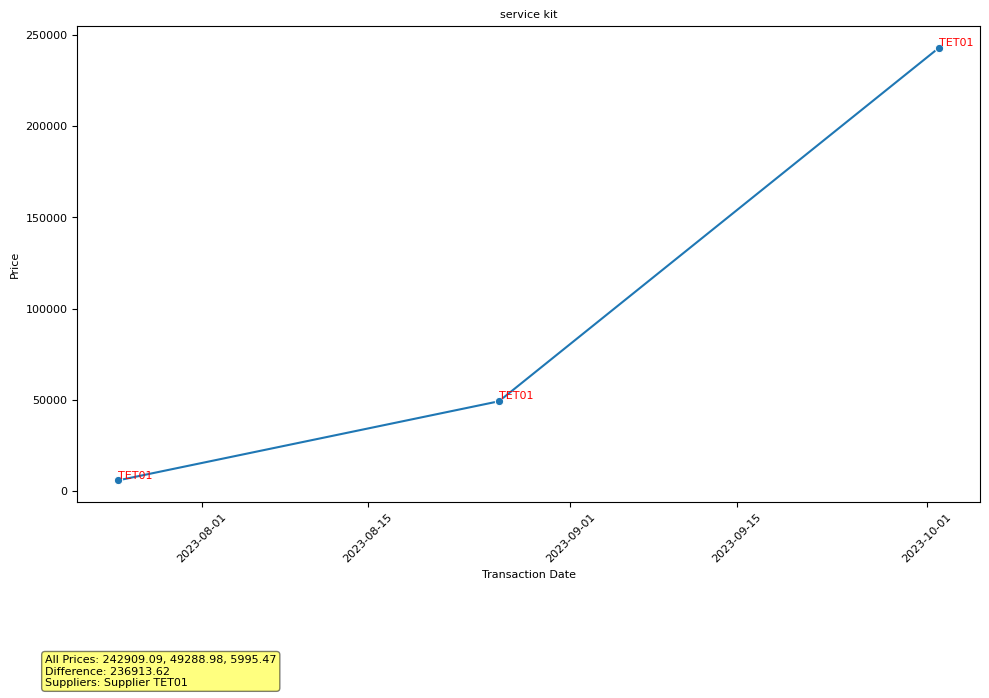

In [23]:
# Install python-pptx
!pip install python-pptx

# Import necessary libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pptx import Presentation
from pptx.util import Inches, Pt
from pptx.enum.text import PP_ALIGN
import os

# Load the data
file_path = "/content/More than one description but shared code.xlsx"
df = pd.read_excel(file_path)

# Drop rows where 'Purchase_Unit_Price' is NaN
df = df.dropna(subset=['Purchase_Unit_Price'])

# Calculate the difference between the max and min prices for each stock description
df['Difference'] = df.groupby('Stock _Description')['Purchase_Unit_Price'].transform(lambda x: x.max() - x.min())

# Add a column for supplier names (replace this with your actual supplier names)
df['Supplier_Name'] = df['Supplier _Code '].map(lambda x: f'Supplier {x}')  # Replace this with actual mapping if available

# Sort stock descriptions by the calculated difference
sorted_stock_descriptions = df.groupby('Stock _Description')['Difference'].max().sort_values(ascending=False).index.tolist()

# Filter sorted stock descriptions to only include those with more than one price
sorted_stock_descriptions_to_plot = [desc for desc in sorted_stock_descriptions if df[df['Stock _Description'] == desc]['Purchase_Unit_Price'].nunique() > 1]

# Function to sanitize file names
def sanitize_filename(filename):
    invalid_chars = ['<', '>', ':', '"', '/', '\\', '|', '?', '*']
    for char in invalid_chars:
        filename = filename.replace(char, '')
    return filename.lower()

# Function to save the plot as an image for each stock description
def save_plot_for_stock_description(stock_description, data):
    sanitized_name = sanitize_filename(stock_description)
    filename = f'plots/{sanitized_name}.png'
    data_filtered = data[data['Stock _Description'] == stock_description].sort_values(by='Transaction _Date')
    plt.figure(figsize=(10, 6))
    lineplot = sns.lineplot(x='Transaction _Date', y='Purchase_Unit_Price', data=data_filtered, marker='o')

    # Annotate each data point with the supplier code
    for idx, row in data_filtered.iterrows():
        lineplot.text(row['Transaction _Date'], row['Purchase_Unit_Price'], str(row['Supplier _Code ']).strip(),
                      color='red', fontsize=8, verticalalignment='bottom')

    plt.title(stock_description.lower(), fontsize=8)
    plt.xlabel('Transaction Date', fontsize=8)
    plt.ylabel('Price', fontsize=8)
    plt.xticks(rotation=45, fontsize=8)
    plt.yticks(fontsize=8)

    # Footer notes with supplier names, prices, and the price difference
    supplier_names = ', '.join(data_filtered['Supplier_Name'].unique())
    all_prices = ', '.join(map(str, sorted(data_filtered['Purchase_Unit_Price'].unique(), reverse=True)))
    price_diff = data_filtered['Purchase_Unit_Price'].max() - data_filtered['Purchase_Unit_Price'].min()

    plt.figtext(0.05, -0.1, f'All Prices: {all_prices}\nDifference: {price_diff}\nSuppliers: {supplier_names}',
                fontsize=8, ha='left', va='top', bbox=dict(boxstyle="round,pad=0.3", edgecolor='black', facecolor='yellow', alpha=0.5))

    plt.tight_layout()
    plt.savefig(filename, bbox_inches='extended')
    plt.close()

# Create a directory to store the images
os.makedirs('plots', exist_ok=True)

# Save plots as images
for stock_description in sorted_stock_descriptions_to_plot:
    save_plot_for_stock_description(stock_description, df)

# Create a new PowerPoint presentation
prs = Presentation()

# Add images to the presentation with titles and page numbers
for i, stock_description in enumerate(sorted_stock_descriptions_to_plot, start=1):
    slide = prs.slides.add_slide(prs.slide_layouts[5])  # Using a blank slide layout
    title = slide.shapes.title
    title.text = f"No.{i}"

    # Slide number (footer)
    slide_number = slide.shapes.add_textbox(Inches(10), Inches(6.5), Inches(1), Inches(0.5))
    slide_number_tf = slide_number.text_frame
    slide_number_tf.text = f"{i}"
    p = slide_number_tf.paragraphs[0]
    p.font.size = Pt(14)
    p.alignment = PP_ALIGN.RIGHT

    sanitized_name = sanitize_filename(stock_description)
    filename = f'plots/{sanitized_name}.png'
    if os.path.exists(filename):
        left = Inches(1)
        top = Inches(1.5)
        pic = slide.shapes.add_picture(filename, left, top, width=Inches(8))

# Save the PowerPoint file
pptx_path = '/content/stock_description_presentation.pptx'
prs.save(pptx_path)
print(f"Presentation saved to {pptx_path}")


In [6]:
# Install python-pptx
!pip install python-pptx

# Import necessary libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pptx import Presentation
from pptx.util import Inches, Pt
from pptx.enum.text import PP_ALIGN
import os

# Load the data
file_path = "/content/More than one description but shared code.xlsx"
df = pd.read_excel(file_path)

# Drop rows where 'Purchase_Unit_Price' is NaN
df = df.dropna(subset=['Purchase_Unit_Price'])

# Calculate the difference between the max and min prices for each stock description
df['Difference'] = df.groupby('Stock _Description')['Purchase_Unit_Price'].transform(lambda x: x.max() - x.min())

# Add a column for supplier names based on supplier codes
# You should provide a dictionary mapping supplier codes to names
supplier_names_mapping = {
    # 'supplier_code': 'Supplier Name',
    # Add your mappings here
}
df['Supplier_Name'] = df['Supplier _Code '].map(supplier_names_mapping)

# Sort stock descriptions by the calculated difference
sorted_stock_descriptions = df.groupby('Stock _Description')['Difference'].max().sort_values(ascending=False).index.tolist()

# Filter sorted stock descriptions to only include those with more than one price
sorted_stock_descriptions_to_plot = [desc for desc in sorted_stock_descriptions if df[df['Stock _Description'] == desc]['Purchase_Unit_Price'].nunique() > 1]

# Function to sanitize file names
def sanitize_filename(filename):
    invalid_chars = ['<', '>', ':', '"', '/', '\\', '|', '?', '*']
    for char in invalid_chars:
        filename = filename.replace(char, '')
    return filename.lower()

# Function to save the plot as an image for each stock description
def save_plot_for_stock_description(stock_description, data):
    sanitized_name = sanitize_filename(stock_description)
    filename = f'plots/{sanitized_name}.png'
    data_filtered = data[data['Stock _Description'] == stock_description].sort_values(by='Transaction _Date')
    plt.figure(figsize=(10, 6))
    sns.lineplot(x='Transaction _Date', y='Purchase_Unit_Price', data=data_filtered, marker='o')
    plt.title(stock_description.lower(), fontsize=8)
    plt.xlabel('Transaction Date', fontsize=8)
    plt.ylabel('Price', fontsize=8)
    plt.xticks(rotation=45, fontsize=8)
    plt.yticks(fontsize=8)

    # Annotate each data point with the supplier code
    for idx, row in data_filtered.iterrows():
        plt.text(row['Transaction _Date'], row['Purchase_Unit_Price'], str(row['Supplier _Code ']).strip(),
                 color='red', fontsize=8, verticalalignment='bottom')

    # Footer notes with supplier names, prices, and the price difference
    price_diff = data_filtered['Purchase_Unit_Price'].max() - data_filtered['Purchase_Unit_Price'].min()
    supplier_names = ', '.join(data_filtered['Supplier_Name'].dropna().unique())
    plt.figtext(0.05, -0.1, f'Difference: {price_diff}\nSuppliers: {supplier_names}',
                fontsize=8, ha='left', va='top', bbox=dict(boxstyle="round,pad=0.3", edgecolor='black', facecolor='yellow', alpha=0.5))

    plt.tight_layout()
    plt.savefig(filename, bbox_inches='tight')
    plt.close()

# Create a directory to store the images
os.makedirs('plots', exist_ok=True)

# Save plots as images
for stock_description in sorted_stock_descriptions_to_plot:
    save_plot_for_stock_description(stock_description, df)

# Create a new PowerPoint presentation
prs = Presentation()

# Add images to the presentation with titles and page numbers
for i, stock_description in enumerate(sorted_stock_descriptions_to_plot, start=1):
    slide = prs.slides.add_slide(prs.slide_layouts[5])  # Using a blank slide layout
    title_shape = slide.shapes.title
    title_shape.text = f"No.{i}"

    # Slide number (footer)
    slide_number_shape = slide.shapes.add_textbox(Inches(10), Inches(6.5), Inches(1), Inches(0.5))
    slide_number_tf = slide_number_shape.text_frame
    slide_number_tf.text = str(i)
    for paragraph in slide_number_tf.paragraphs:
        for run in paragraph.runs:
            run.font.size = Pt(14)

    sanitized_name = sanitize_filename(stock_description)
    filename = f'plots/{sanitized_name}.png'
    if os.path.exists(filename):
        left = Inches(1)
        top = Inches(1.5)
        pic = slide.shapes.add_picture(filename, left, top, width=Inches(8))

# Save the PowerPoint file
pptx_path = '/content/stock_description_presentation.pptx'
prs.save(pptx_path)
print(f"Presentation saved to {pptx_path}")


Presentation saved to /content/stock_description_presentation.pptx
